In [1]:
from mcbj import *
import plots

date = "21_12_08"
sample_rate = 50_000
home_folder = Path(f"D:/BJ_Data/{date}")
import numpy as np
from matplotlib.ticker import MultipleLocator

In [3]:
# def plot_correlation(n, correlation, axis=None, **kwargs):

#     if axis is None:
#         fig, ax = plt.subplots(1, figsize=utils.cm2inch(6, 4), dpi=600)
#     else:
#         ax = axis
#     ax.plot(n, correlation, **kwargs)
#     ax.set_xlabel(r'$n$')
#     ax.set_ylabel(r'$C(\log(iPSD/G_{\mathrm{avg}}^{n}), \log(G_{\mathrm{avg}}))$')
#     ax.axhline(y=0, xmin=0, xmax=1, ls='--', lw=0.5, c='k')
#     ax.axvline(x=n[abs(correlation) == min(abs(correlation))][0], ymin=0, ymax=1,
#                ls='--', lw=0.5, c='k')
#     ax.xaxis.set_minor_locator(ticker.MultipleLocator(0.1))
#     ax.text(x=0.15, y=0.15, s=f"n = {np.round(n[abs(correlation) == min(abs(correlation))][0], 2)}",
#             transform=ax.transAxes, fontsize='xx-small', ha='left', va='bottom')

#     return ax, n[abs(correlation) == min(abs(correlation))][0]

# def plot_noise_power_2dhist(conductance_avgs: np.ndarray, noise_power: np.ndarray, n: float,
#                             xrange: Optional[Tuple[float, float]] = (1e-5, 0.1),
#                             yrange: Optional[Tuple[float, float]] = (1e-12, 1e-5),
#                             num_bins: Optional[Tuple[int, int]] = (10, 10),
#                             shift: Optional[float] = 0,
#                             normalize: bool = False,
#                             axis=None, **kwargs):

#     num_of_decs_x = np.log10(xrange[1]) - np.log10(xrange[0])
#     num_of_decs_y = np.log10(yrange[1]) - np.log10(yrange[0])

#     xbins = np.logspace(np.log10(xrange[0]), np.log10(xrange[1]), num=int(num_bins[0] * num_of_decs_x))
#     ybins = np.logspace(np.log10(yrange[0]), np.log10(yrange[1]), num=int(num_bins[0] * num_of_decs_y))

#     h, xedges, yedges = np.histogram2d(conductance_avgs.flatten(), noise_power.flatten(), bins=[xbins, ybins])
#     x_mesh, y_mesh = np.meshgrid(xedges, yedges)
    
#     h = h.T  # need to take the tarnspose of h
    
#     if normalize:
#         x, avg_cond_hist = utils.calc_hist_1d_single(data=conductance_avgs,
#                                                      xrange=xrange,
#                                                      xbins_num=num_bins[0],
#                                                      log_scale=True)
        
#         h = h/avg_cond_hist

#     if axis is None:
#         fig, ax = plt.subplots(1, figsize=utils.cm2inch(4, 4), dpi=600)
#     else:
#         ax = axis

#     ax.set_xscale('log')
#     ax.set_yscale('log')

#     ax.set_xlim(xrange[0], xrange[1])
#     ax.set_ylim(yrange[0], yrange[1])

#     ax.xaxis.set_major_locator(ticker.LogLocator(base=10.0, subs=(1.0,), numticks=9))
#     ax.xaxis.set_minor_locator(ticker.LogLocator(base=10.0, subs=np.arange(0, 1, 0.1), numticks=9))
#     ax.yaxis.set_major_locator(ticker.LogLocator(base=10.0, subs=(1.0,), numticks=9))

#     ax.set_xlabel(r'$\langle G \rangle [G_0]$')

#     ax.plot(xbins, 10 ** (n * np.log10(xbins) + shift), lw=0.5, ls='--', c='k')

#     ax.text(x=0.85, y=0.15, s=f"n = {np.round(n, 2)}",
#             transform=ax.transAxes, fontsize='xx-small', ha='right', va='bottom')

#     im = ax.pcolormesh(x_mesh, y_mesh, h, **kwargs)

#     return ax

In [4]:
hist_1 = Histogram(home_folder, 1, 8000)

hist_1.calc_stats(align_at=1e-5, range_pull=(-1.5, 1), range_push=(-3, 1), xbins_pull=250, xbins_push=400,
                  plateau_length_bins=100)

Processing break junction files:   0%|          | 0/81 [00:00<?, ?it/s]

Pull 2D histogram created from 8000 traces
Push 2D histogram created from 8000 traces


(-1.0, 0.2)

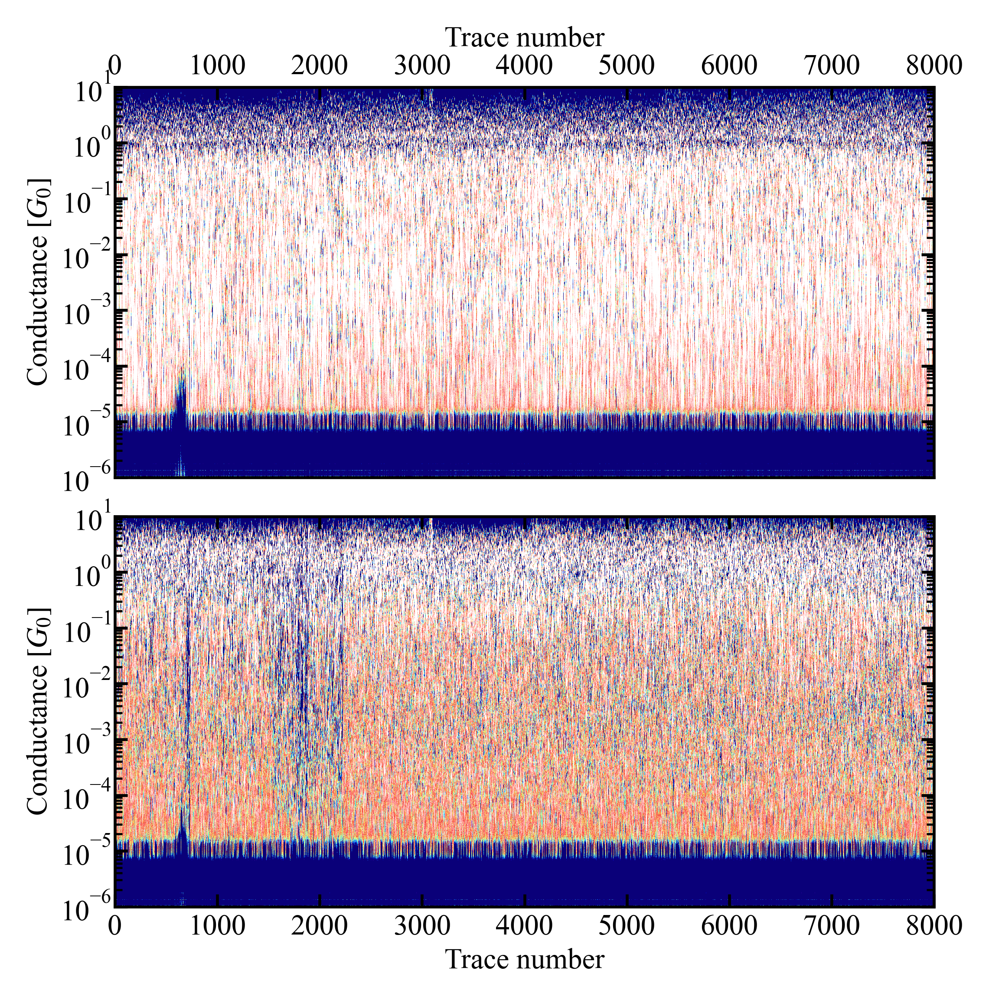

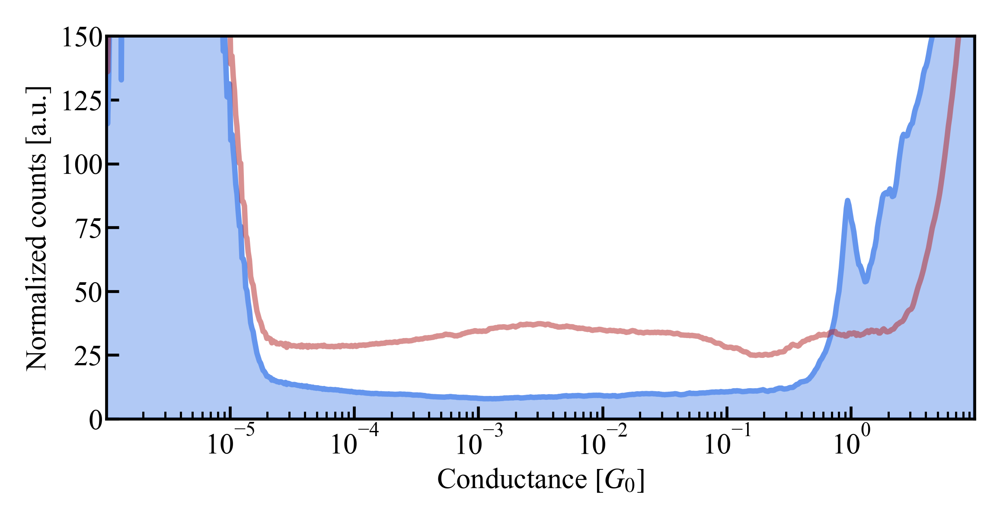

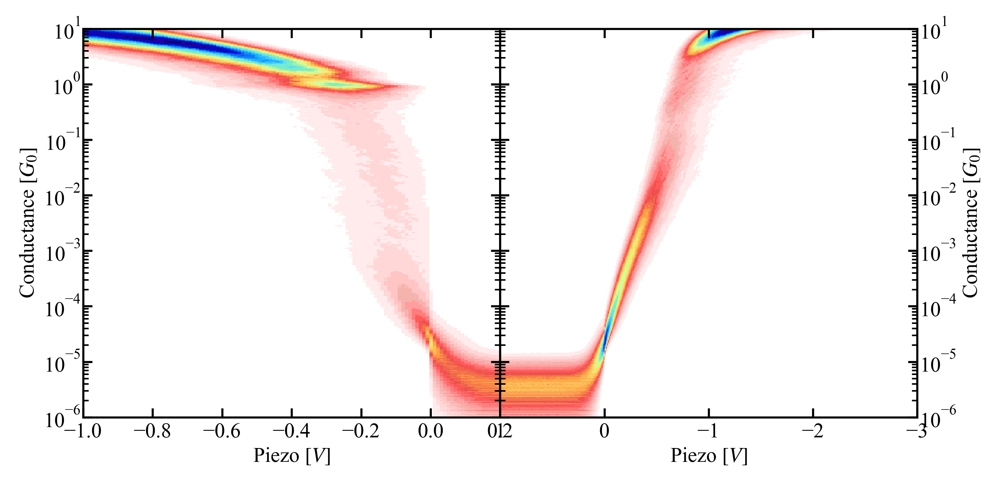

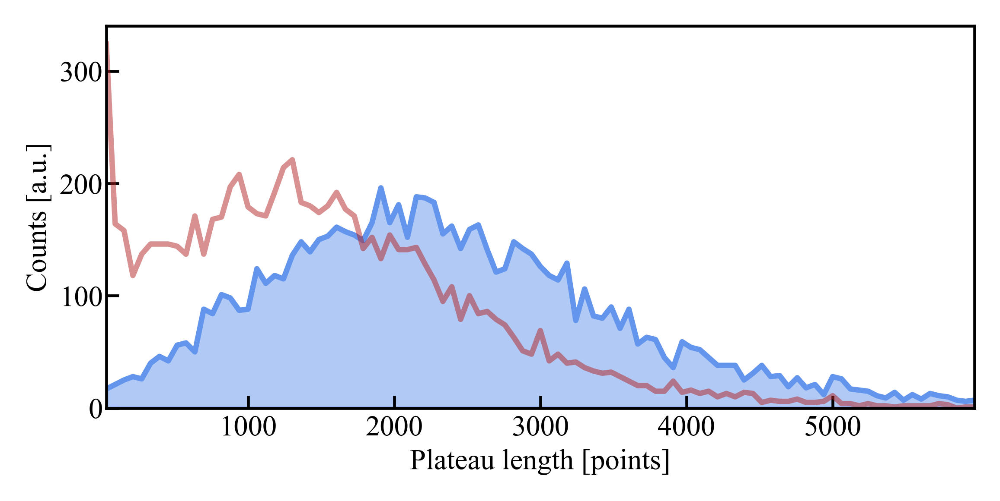

In [5]:
hist_1.plot_temporal_hist(vmax=100)
hist_1.plot_hist_1d(ylims=(0, 150))
ax_pull, ax_push = hist_1.plot_hist_2d_both()
hist_1.plot_plateau_length_hist()

ax_pull.set_xlim(-1, 0.2)

In [6]:
hist_2 = Histogram(home_folder, 23021, 34500)

hist_2.calc_stats(align_at=1e-5, range_pull=(-1.5, 1), range_push=(-3, 1), xbins_pull=250, xbins_push=400,
                  plateau_length_bins=100)

Processing break junction files:   0%|          | 0/116 [00:00<?, ?it/s]

Pull 2D histogram created from 11480 traces
Push 2D histogram created from 11480 traces


(-1.0, 0.2)

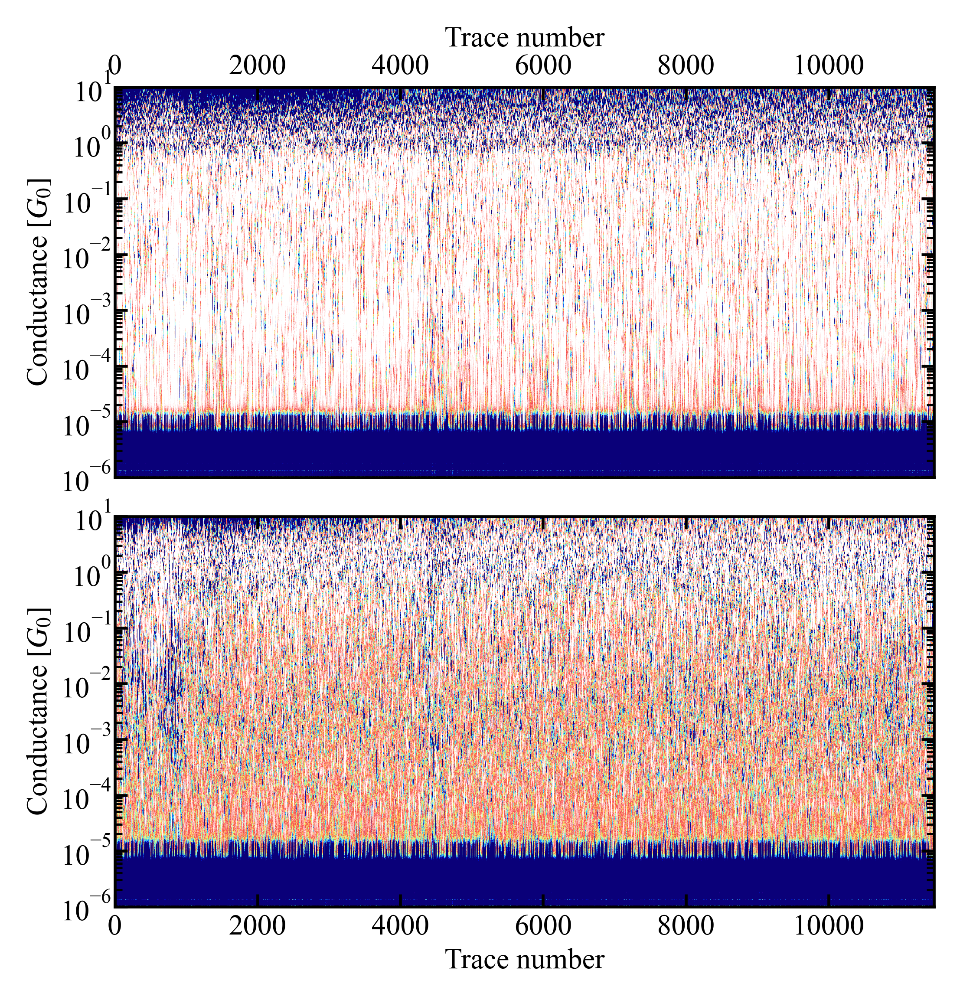

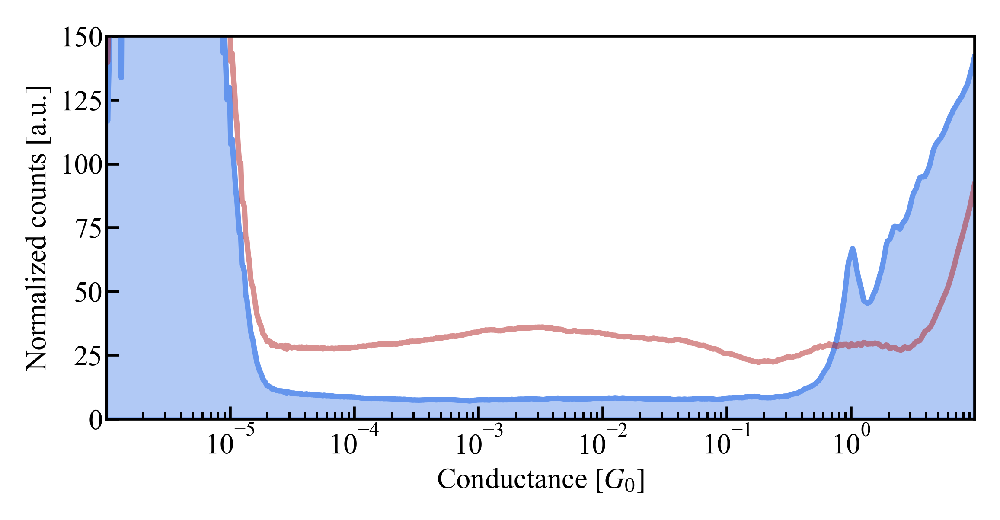

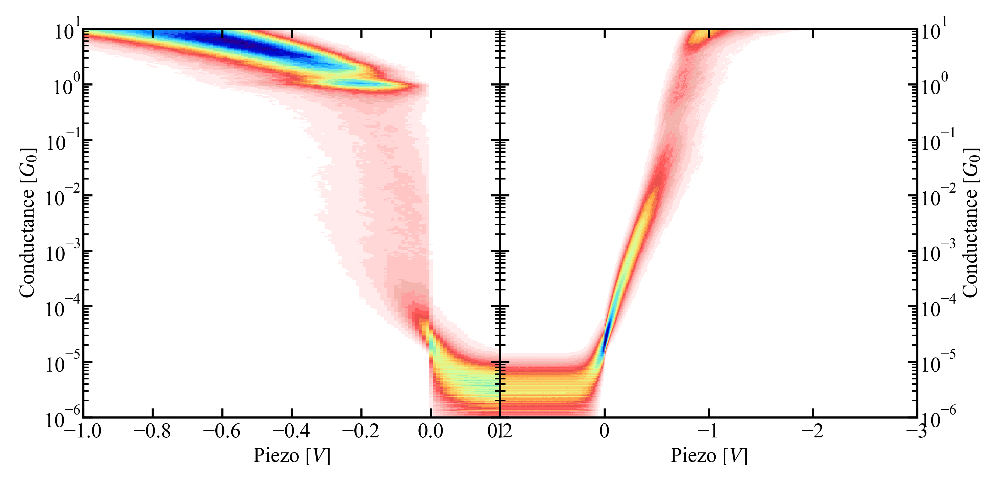

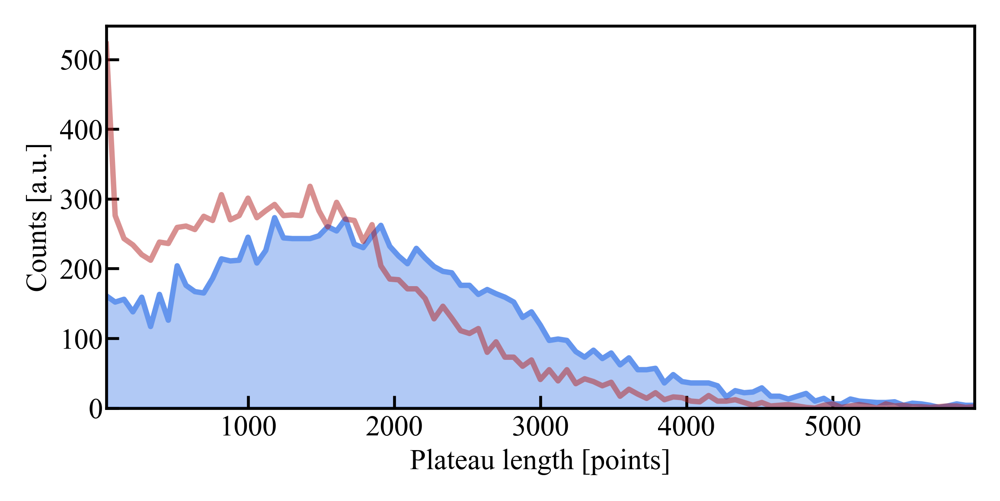

In [8]:
hist_2.plot_temporal_hist(vmax=100)
hist_2.plot_hist_1d(ylims=(0, 150))
ax_pull, ax_push = hist_2.plot_hist_2d_both()
hist_2.plot_plateau_length_hist()

ax_pull.set_xlim(-1, 0.2)

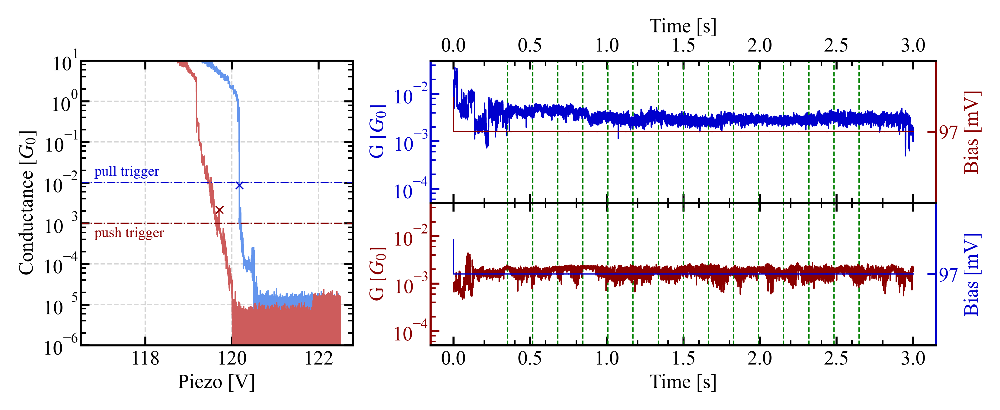

In [8]:
which_trace = 8008  # 8012

trace_pair = TracePair(trace=which_trace, load_from=home_folder)
hold_trace = HoldTrace(which_trace, load_from=home_folder, min_step_len=0, bias_offset=0)
hold_trace.analyse_hold_trace(num_of_fft=14)
ax_trace, ax_pull, ax_push = plots.plot_measurement_scheme(trace_pair=trace_pair,
                                                           hold_trace=hold_trace,
                                                           home_folder=home_folder,
                                                           main_colors=('cornflowerblue', 'indianred'),
                                                           accent_colors=('mediumblue', 'darkred'),
                                                           save_fig=False,
                                                           xlim=None, smoothing=1)

# for i in np.mean(hold_trace.test_intervals_pull, axis=1)/50_000:
#     ax_pull.axvline(i, ls='--', lw=0.5, c='grey', alpha=0.7)
    
# for i in np.mean(hold_trace.test_intervals_push, axis=1)/50_000:
#     ax_push.axvline(i, ls='--', lw=0.5, c='grey', alpha=0.7)

In [9]:
np.diff(hold_trace.psd_interval_ranges_pull)

array([[8192, 8192, 8192, 8192, 8192, 8192, 8192, 8192, 8192, 8192, 8192,
        8192, 8192, 8192]], dtype=int64)

In [4]:
for i in hold_trace.psd_interval_ranges_pull:
    print(i)

[ 34040  42232  50424  58616  66808  75000  83192  91384  99576 107768
 115960]


In [158]:
np.diff(np.mean(hold_trace.test_intervals_pull, axis=1)/50_000)

array([0.1235, 0.125 , 0.125 , 0.125 , 0.125 , 0.125 , 0.125 , 0.125 ,
       0.125 , 0.125 , 0.125 , 0.125 , 0.125 , 0.125 , 0.125 , 0.125 ,
       0.125 , 0.125 , 0.125 , 0.125 , 0.125 , 0.125 , 0.125 , 0.1235])

bias_steps [0.1000061]


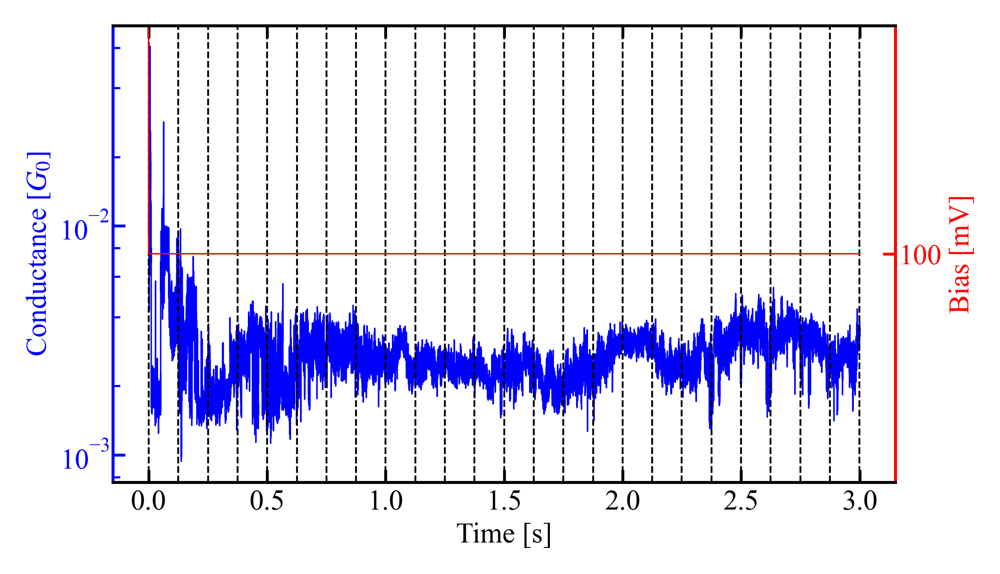

In [159]:
ax = hold_trace.plot_hold_traces(plot_step_ranges=False, plot_psd_intervals=False, conductance=True, 
                                add_vlines=test/50_000)    
# ax.set_xlim(-0.1, 0.3)

In [6]:
hold_trace.conductance_avgs_pull

array([1.49563688e-02, 1.82391480e-04, 5.74887569e-05, 4.74887020e-05,
       4.75044603e-05, 4.73774965e-05, 4.67983460e-05, 5.88809453e-05,
       3.75350885e-05, 1.36292929e-04, 2.31801819e-04, 1.75713876e-04,
       1.57607075e-04, 1.85778608e-04, 1.65085339e-04, 1.60405926e-04,
       1.87804204e-04])

In [2]:
noise_stat_1 = NoiseStats(home_folder, start_trace=8001, end_trace=23000, num_of_fft=1, min_step_len=0, bias_offset=0,
                         save_data=1)

Processing hold files: 100%|██████████| 151/151 [33:06<00:00, 13.16s/it]


Data saved.


In [23]:
hold_trace = HoldTrace(34501, load_from=home_folder, min_step_len=None, bias_offset=0)
hold_trace.analyse_hold_trace(num_of_fft=1)

bias_steps [0.1000061 0.2000122 0.2999878 0.1000061]


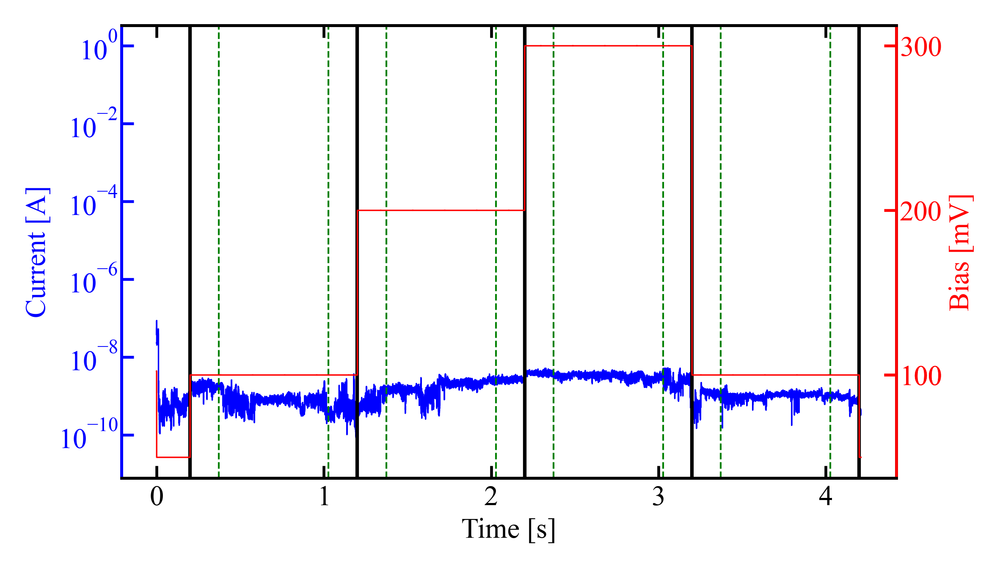

In [24]:
ax = hold_trace.plot_hold_traces(plot_step_ranges=True, plot_psd_intervals=True)
# ax.set_xlim(-0.001, 0.3)

In [25]:
noise_stat_2 = NoiseStats(home_folder, start_trace=34501, end_trace=45000, num_of_fft=1, min_step_len=None,
                          bias_offset=0, save_data=2)

Processing hold files: 100%|██████████| 106/106 [21:50<00:00, 12.36s/it]


Data saved.
During the analysis the following errors occurred:
Overflow at trace_35953
Overflow at trace_36799
Measurement incomplete at trace_37835
Overflow at trace_38685
Overflow at trace_41197
Overflow at trace_43582


bias_steps [0.1000061 0.2000122 0.2999878 0.1000061]
[[ 10001  60001]
 [ 60001 110001]
 [110001 160000]
 [160000 210000]]
[7.9598266e-09 8.0405078e-09 8.2312424e-09 ... 3.1826669e-08 3.1903728e-08
 3.1935961e-08]


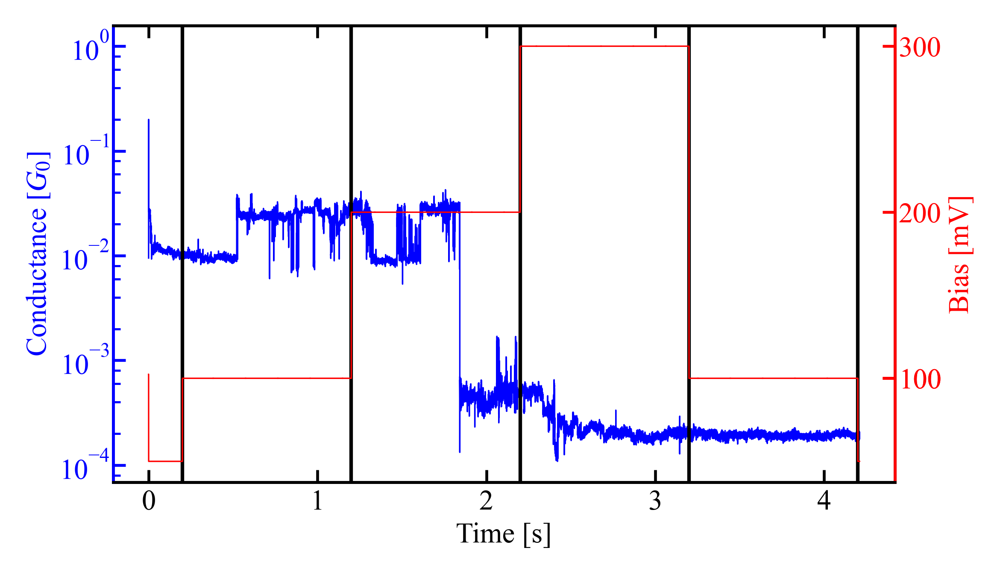

In [26]:
hold_trace_1 = HoldTrace(trace='trace_37376', load_from=home_folder, min_step_len=None, bias_offset=0)
# hold_trace_1.analyse_hold_trace(num_of_fft=1)
hold_trace_1.plot_hold_traces(plot_step_ranges=True, plot_psd_intervals=False, conductance=True)
print(hold_trace_1.bias_steps_ranges_push)
print(np.unique(hold_trace_1.hold_current_push[109995:159995]))


bias_steps [0.1000061 0.2000122 0.2999878 0.1000061]


<AxesSubplot:xlabel='Time [s]', ylabel='Conductance $[G_{0}]$'>

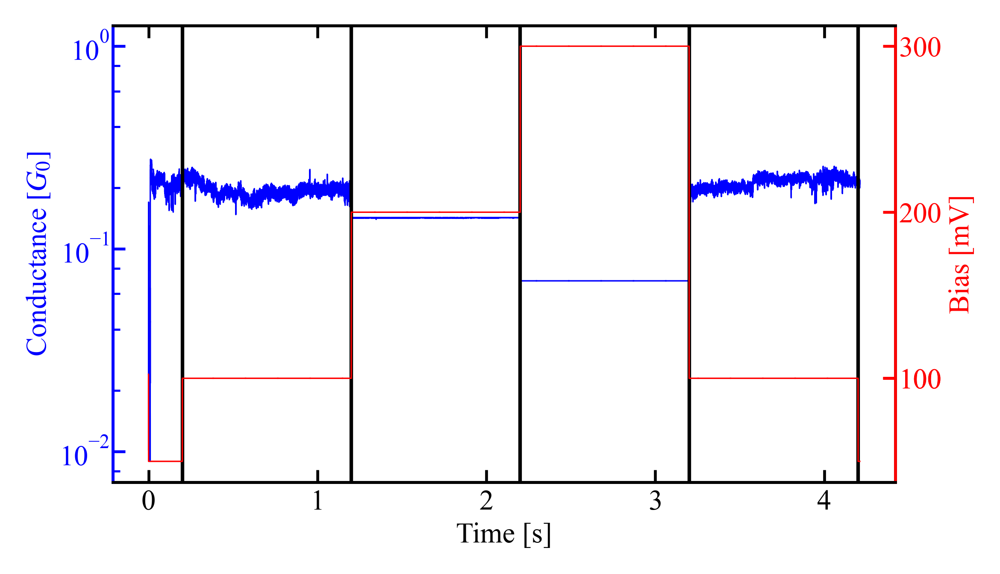

In [28]:
hold_trace_2 = HoldTrace(trace='trace_43582', load_from=home_folder, min_step_len=None, bias_offset=0)
# hold_trace_2.analyse_hold_trace(num_of_fft=1)
hold_trace_2.plot_hold_traces(plot_step_ranges=True, plot_psd_intervals=False, conductance=True)

In [ ]:
import matplotlib.pyplot as plt
blues = ['#000c33', '#002599', '#0032cc', '#003eff', '#406eff', '#809fff']
reds = ['#330000', '#660000', '#990000', '#cc0000', '#ff0000', '#ff4040']

In [ ]:
def scatterplot_pull_push(x_pull, x_push, y_pull, y_push, ax=None):
    if ax is None:
        fig, ax = plt.subplots(1, figsize=utils.cm2inch(7,7), dpi=300)
    ax.scatter(x_pull, y_pull, c='blue', alpha=0.5, edgecolors='none', s=2)
    ax.scatter(x_push, y_push, c='red', alpha=0.5, edgecolors='none', s=2)
    ax.set_xscale('log')
    ax.set_yscale('log')
    ax.set_xlim(1e-5, 1e-1)
    ax.set_ylim(1e-5, 1e-1)
    ax.set_xlabel(r'$G_\mathrm{set} [G_{0}]$')
    ax.set_ylabel(r'$G_\mathrm{stop} [G_{0}]$')
    plt.show()

def scatterplot(x, y, ax_xlabel=r'$G_\mathrm{} [G_{0}]$', ax_ylabel=r'$G_\mathrm{} [G_{0}]$', ax=None, **kwargs):
    if ax is None:
        fig, ax = plt.subplots(1, figsize=utils.cm2inch(7,7), dpi=300)
    ax.scatter(x, y, **kwargs, edgecolors='none')
    ax.set_xscale('log')
    ax.set_yscale('log')
    ax.set_xlim(1e-5, 1e-1)
    ax.set_ylim(1e-5, 1e-1)
    ax.set_xlabel(ax_xlabel)
    ax.set_ylabel(ax_ylabel)

In [ ]:
set_vals_pull, set_counts_pull = np.unique(noise_stat_1.G_set_pull, return_counts=True)
set_vals_push, set_counts_push = np.unique(noise_stat_1.G_set_push, return_counts=True)

noise_stat_1.G_set_pull = np.array(noise_stat_1.G_set_pull)
noise_stat_1.G_set_push = np.array(noise_stat_1.G_set_push)
noise_stat_1.G_stop_pull = np.array(noise_stat_1.G_stop_pull)
noise_stat_1.G_stop_push = np.array(noise_stat_1.G_stop_push)
noise_stat_1.G_hold_pull = np.array(noise_stat_1.G_hold_pull)
noise_stat_1.G_hold_push = np.array(noise_stat_1.G_hold_push)
noise_stat_1.G_avg_pull = np.array(noise_stat_1.G_avg_pull)
noise_stat_1.G_avg_push = np.array(noise_stat_1.G_avg_push)

# noise_stat_2.G_set_pull = np.array(noise_stat_2.G_set_pull)
# noise_stat_2.G_set_push = np.array(noise_stat_2.G_set_push)
# noise_stat_2.G_stop_pull = np.array(noise_stat_2.G_stop_pull)
# noise_stat_2.G_stop_push = np.array(noise_stat_2.G_stop_push)
# noise_stat_2.G_hold_pull = np.array(noise_stat_2.G_hold_pull)
# noise_stat_2.G_hold_push = np.array(noise_stat_2.G_hold_push)
# noise_stat_2.G_avg_pull = np.array(noise_stat_2.G_avg_pull)
# noise_stat_2.G_avg_push = np.array(noise_stat_2.G_avg_push)

In [ ]:
def scat_and_hist(xlabel:str, ylabel:str,
                  x_pull:Optional[Union[np.ndarray, None]] = None,
                  y_pull:Optional[Union[np.ndarray, None]] = None,
                  x_push:Optional[Union[np.ndarray, None]] = None,
                  y_push:Optional[Union[np.ndarray, None]] = None,
                  set_arr_pull:Optional[Union[np.ndarray, None]] = None,
                  set_arr_push:Optional[Union[np.ndarray, None]] = None):

    fig = plt.figure(figsize=utils.cm2inch(10, 10), dpi=600)  # figsize: (width, height) in inches
    gs = gridspec.GridSpec(nrows=2, ncols=2, width_ratios=(7, 3), height_ratios=(3, 7),
                           figure=fig, left=0.15, right=0.95, top=0.9, bottom=0.1, wspace=0.1, hspace=0.1)

    ax = fig.add_subplot(gs[1, 0])
    ax_histx = fig.add_subplot(gs[0, 0], sharex=ax)
    ax_histy = fig.add_subplot(gs[1, 1], sharey=ax)

    ax.xaxis.set_ticks_position('both')
    ax.yaxis.set_ticks_position('both')

    ax_histx.xaxis.set_label_position('top')
    ax_histx.xaxis.tick_top()
    ax_histx.xaxis.set_ticks_position('both')
    ax_histx.yaxis.set_ticks_position('both')
    ax_histx.yaxis.set_label_position('left')

    ax_histy.yaxis.set_label_position('right')
    ax_histy.yaxis.tick_right()
    ax_histy.yaxis.set_ticks_position('both')
    ax_histy.xaxis.set_label_position('bottom')
    ax_histy.xaxis.set_ticks_position('both')

    if set_arr_pull is not None:
        set_vals_pull = np.unique(set_arr_pull)
        histx_pull = []
        histy_pull = []

        for i in range(len(set_vals_pull)):
            scatterplot(x_pull[set_arr_pull == set_vals_pull[i]],
                        y_pull[set_arr_pull == set_vals_pull[i]],
                        ax_xlabel=r'$G_\mathrm{set} [G_{0}]$', ax_ylabel=r'$G_\mathrm{stop} [G_{0}]$', ax=ax,
                        c=blues[i], alpha=0.5, s=1)

            binsx, hist = utils.calc_hist_1d_single(x_pull[set_arr_pull == set_vals_pull[i]],
                                                    xrange=(1e-5, 1e-1), xbins_num=100, log_scale=True)
            histx_pull.append(hist)

            binsy, hist = utils.calc_hist_1d_single(y_pull[set_arr_pull == set_vals_pull[i]],
                                                    xrange=(1e-5, 1e-1), xbins_num=100, log_scale=True)
            histy_pull.append(hist)

            ax_histx.plot(binsx, histx_pull[-1], c=blues[i], lw=0.6, alpha=0.7)
            ax_histy.plot(histy_pull[-1], binsy, c=blues[i], lw=0.6, alpha=0.7)

        histx_pull = np.array(histx_pull)
        histy_pull = np.array(histy_pull)

        ax_histx.set_ylim(0, max(histx_pull.flatten()))
        ax_histy.set_xlim(0, max(histy_pull.flatten()))

    if set_arr_push is not None:
        set_vals_push = np.unique(set_arr_push)
        histx_push = []
        histy_push = []

        for i in range(len(set_vals_push)):
            scatterplot(x_push[set_arr_push == set_vals_push[i]],
                        y_push[set_arr_push == set_vals_push[i]],
                        ax_xlabel=r'$G_\mathrm{set} [G_{0}]$', ax_ylabel=r'$G_\mathrm{stop} [G_{0}]$', ax=ax,
                        c=reds[i], alpha=0.5, s=1)

            binsx, hist = utils.calc_hist_1d_single(x_push[set_arr_push == set_vals_push[i]],
                                                    xrange=(1e-5, 1e-1), xbins_num=100, log_scale=True)
            histx_push.append(hist)

            binsy, hist = utils.calc_hist_1d_single(y_push[set_arr_push == set_vals_push[i]],
                                                    xrange=(1e-5, 1e-1), xbins_num=100, log_scale=True)
            histy_push.append(hist)

            ax_histx.plot(binsx, histx_push[-1], c=reds[i], lw=0.6, alpha=0.7)
            ax_histy.plot(histy_push[-1], binsy, c=reds[i], lw=0.6, alpha=0.7)


        histx_push = np.array(histx_push)
        histy_push = np.array(histy_push)

        ax_histx.set_ylim(0, max(histx_push.flatten()))
        ax_histy.set_xlim(0, max(histy_push.flatten()))

    try:
        ax_histx.set_ylim(0, max(max(histx_pull.flatten()), max(histx_push.flatten())))
        ax_histy.set_xlim(0, max(max(histy_pull.flatten()), max(histy_push.flatten())))
    except UnboundLocalError:
        print("lfklfkmm")

    ax.set_xlabel(xlabel)
    ax.set_ylabel(ylabel)
    ax_histx.set_ylabel('Counts')
    ax_histy.set_xlabel('Counts')
    plt.show()

In [ ]:
scat_and_hist(xlabel = r'$G_\mathrm{set} [G_{0}]$',
              ylabel = r'$G_\mathrm{stop} [G_{0}]$',
              x_pull = noise_stat_1.G_set_pull,
              y_pull = noise_stat_1.G_stop_pull,
              x_push = None,
              y_push = None,
              set_arr_pull = noise_stat_1.G_set_pull,
              set_arr_push = None)

In [ ]:
scat_and_hist(xlabel = r'$G_\mathrm{stop} [G_{0}]$',
              ylabel = r'$G_\mathrm{hold} [G_{0}]$',
              x_pull = noise_stat_1.G_stop_pull,
              y_pull = noise_stat_1.G_hold_pull,
              x_push = None,
              y_push = None,
              set_arr_pull = noise_stat_1.G_set_pull,
              set_arr_push = None)

In [ ]:
scat_and_hist(xlabel = r'$G_\mathrm{stop} [G_{0}]$',
              ylabel = r'$G_\mathrm{avg} [G_{0}]$',
              x_pull = noise_stat_1.G_stop_pull,
              y_pull = noise_stat_1.G_avg_pull,
              x_push = None,
              y_push = None,
              set_arr_pull = noise_stat_1.G_set_pull,
              set_arr_push = None)

In [ ]:
scat_and_hist(xlabel = r'$G_\mathrm{hold} [G_{0}]$',
              ylabel = r'$G_\mathrm{avg} [G_{0}]$',
              x_pull = noise_stat_1.G_hold_pull,
              y_pull = noise_stat_1.G_avg_pull,
              x_push = None,
              y_push = None,
              set_arr_pull = noise_stat_1.G_set_pull,
              set_arr_push = None)

In [ ]:
scat_and_hist(xlabel = r'$G_\mathrm{set} [G_{0}]$',
              ylabel = r'$G_\mathrm{stop} [G_{0}]$',
              x_pull = None,
              y_pull = None,
              x_push = noise_stat_1.G_set_push,
              y_push = noise_stat_1.G_stop_push,
              set_arr_pull = None,
              set_arr_push = noise_stat_1.G_set_push)

In [ ]:
scat_and_hist(xlabel = r'$G_\mathrm{stop} [G_{0}]$',
              ylabel = r'$G_\mathrm{hold} [G_{0}]$',
              x_pull = None,
              y_pull = None,
              x_push = noise_stat_1.G_stop_push,
              y_push = noise_stat_1.G_hold_push,
              set_arr_pull = None,
              set_arr_push = noise_stat_1.G_set_push)

In [ ]:
scat_and_hist(xlabel = r'$G_\mathrm{stop} [G_{0}]$',
              ylabel = r'$G_\mathrm{avg} [G_{0}]$',
              x_pull = None,
              y_pull = None,
              x_push = noise_stat_1.G_stop_push,
              y_push = noise_stat_1.G_avg_push,
              set_arr_pull = None,
              set_arr_push = noise_stat_1.G_set_push)

In [ ]:
scat_and_hist(xlabel = r'$G_\mathrm{hold} [G_{0}]$',
              ylabel = r'$G_\mathrm{avg} [G_{0}]$',
              x_pull = None,
              y_pull = None,
              x_push = noise_stat_1.G_hold_push,
              y_push = noise_stat_1.G_avg_push,
              set_arr_pull = None,
              set_arr_push = noise_stat_1.G_set_push)

In [ ]:
hold_trace = HoldTrace(8001, load_from=home_folder, min_step_len=0, bias_offset=0)
hold_trace.analyse_hold_trace(num_of_fft=1)

In [4]:
hold_trace.test_intervals_push

array([[    50,    100],
       [ 29975,  30025],
       [ 59975,  60025],
       [ 89975,  90025],
       [119975, 120025],
       [149900, 149950]])

In [22]:
import pandas as pd

In [53]:
conductance_stat_pull = pd.read_csv(home_folder.joinpath("results/conductance_stats_pull_1.csv"), skiprows=[1])
conductance_stat_push = pd.read_csv(home_folder.joinpath("results/conductance_stats_push_1.csv"), skiprows=[1])

In [55]:
conductance_stat_pull

,trace_index,G_set,G_stop,G_hold,G_avg,G_avgs_1,G_avgs_2,G_avgs_3,G_avgs_4,G_avgs_5,...,G_avgs_16,G_avgs_17,G_avgs_18,G_avgs_19,G_avgs_20,G_avgs_21,G_avgs_22,G_avgs_23,G_avgs_24,G_avgs_25
0,8001.0,0.01,0.007683,0.003697,6.178841e-06,0.003697,1.908848e-03,4.243688e-05,7.507073e-05,1.016793e-04,...,3.671386e-05,7.491817e-06,1.614632e-05,1.281724e-05,1.238165e-05,1.063657e-05,9.592733e-06,1.068418e-05,1.112620e-05,6.018414e-06
1,8002.0,0.01,0.010172,0.013590,5.689503e-07,0.013590,3.498873e-06,3.798441e-07,4.861287e-07,3.365071e-07,...,2.062932e-07,3.150865e-07,2.717450e-07,-4.369999e-08,1.929433e-07,3.776240e-07,3.190076e-07,1.361217e-06,2.422319e-07,5.428719e-07
2,8003.0,0.01,0.002130,0.000024,3.525392e-07,0.000024,3.927827e-06,7.648657e-07,2.129393e-06,9.518249e-07,...,6.812380e-07,3.790015e-07,4.577195e-07,2.781628e-07,3.347233e-07,5.605888e-07,8.444890e-07,4.513566e-07,7.593155e-07,3.335956e-07
3,8004.0,0.01,0.002607,0.000033,1.738074e-06,0.000033,3.409848e-05,2.155516e-05,1.210658e-05,1.137582e-05,...,2.736410e-06,2.079726e-06,3.961939e-06,2.843415e-06,9.057537e-06,9.490890e-06,3.974238e-06,1.024432e-05,1.018128e-06,1.820744e-06
4,8005.0,0.01,0.009085,0.009602,1.768714e-06,0.009602,6.441502e-03,1.036186e-02,9.595647e-03,8.931681e-03,...,1.907414e-06,2.829021e-06,2.818837e-06,3.947030e-06,1.676657e-06,2.096873e-06,2.073547e-06,1.449347e-06,2.158178e-06,1.823086e-06
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
14995,22996.0,0.01,0.003071,0.000017,2.910807e-06,0.000017,1.384691e-05,9.820536e-06,6.253616e-06,1.738440e-06,...,4.135147e-06,4.482833e-06,9.189959e-06,3.145302e-06,4.457013e-06,4.162483e-06,2.916492e-06,2.443711e-06,2.374883e-06,2.438407e-06
14996,22997.0,0.01,0.010050,0.011665,2.273078e-06,0.011665,5.015329e-03,4.121166e-03,3.988422e-03,3.936233e-03,...,1.842650e-03,1.980270e-03,1.704974e-03,5.502075e-04,3.227743e-06,3.328623e-06,1.882727e-06,1.738018e-06,3.569152e-06,2.328688e-06
14997,22998.0,0.01,0.000328,0.000136,2.579423e-07,0.000136,1.042633e-04,1.186109e-06,1.943158e-07,6.450588e-07,...,7.820491e-07,5.709179e-07,2.997442e-07,6.462178e-07,3.219866e-07,4.498997e-07,8.347504e-07,4.833025e-07,5.216972e-07,1.462373e-07
14998,22999.0,0.01,0.002809,0.000234,5.491758e-07,0.000234,6.785496e-05,3.436566e-05,1.801427e-06,1.554647e-06,...,1.522276e-06,8.666489e-07,5.949813e-07,3.622658e-07,4.262210e-07,7.947274e-07,3.879096e-07,6.128364e-07,7.048278e-07,5.969071e-07


In [56]:
conductance_stat_push

,trace_index,G_set,G_stop,G_hold,G_avg,G_avgs_1,G_avgs_2,G_avgs_3,G_avgs_4,G_avgs_5,...,G_avgs_16,G_avgs_17,G_avgs_18,G_avgs_19,G_avgs_20,G_avgs_21,G_avgs_22,G_avgs_23,G_avgs_24,G_avgs_25
0,8001.0,0.0010,0.001043,0.000874,0.001241,0.000874,0.001124,0.001423,0.000835,0.000733,...,0.000497,0.000514,0.001035,0.001466,0.001423,0.001495,0.001392,0.001219,0.000554,0.001240
1,8002.0,0.0010,0.001033,0.000775,0.001558,0.000775,0.001072,0.001269,0.001367,0.001280,...,0.001498,0.001506,0.001546,0.001583,0.001617,0.001651,0.000722,0.001432,0.001398,0.001556
2,8003.0,0.0010,0.001045,0.000665,0.000528,0.000665,0.000663,0.000712,0.000810,0.000723,...,0.000298,0.000565,0.000418,0.001226,0.000305,0.000438,0.000683,0.000518,0.000280,0.000528
3,8004.0,0.0010,0.000992,0.000724,0.001477,0.000724,0.001123,0.002196,0.002697,0.003064,...,0.001826,0.001888,0.001712,0.001814,0.001564,0.001487,0.001515,0.001518,0.001488,0.001474
4,8005.0,0.0010,0.000844,0.001347,0.001294,0.001347,0.002179,0.002248,0.002068,0.002301,...,0.001236,0.001390,0.001230,0.001196,0.001097,0.001216,0.000998,0.001182,0.001184,0.001295
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
14995,22996.0,0.0001,0.000106,0.000081,0.000246,0.000081,0.000100,0.000098,0.000158,0.000195,...,0.000169,0.000205,0.000191,0.000204,0.000220,0.000235,0.000229,0.000228,0.000226,0.000246
14996,22997.0,0.0001,0.000128,0.000116,0.000272,0.000116,0.000215,0.000238,0.000143,0.000385,...,0.000197,0.000185,0.000206,0.000211,0.000217,0.000203,0.000253,0.000154,0.000130,0.000272
14997,22998.0,0.0001,0.000095,0.000075,0.000104,0.000075,0.000107,0.000093,0.000108,0.000105,...,0.000091,0.000075,0.000079,0.000086,0.000103,0.000087,0.000105,0.000105,0.000096,0.000104
14998,22999.0,0.0001,0.000094,0.000108,0.000075,0.000108,0.000110,0.000109,0.000039,0.000047,...,0.000068,0.000086,0.000076,0.000079,0.000061,0.000087,0.000078,0.000114,0.000121,0.000075


In [7]:
# conductance_stat_pull_above = conductance_stat_pull[conductance_stat_pull['G_avgs_1'] > 5e-5]
# conductance_stat_pull_above = conductance_stat_pull[conductance_stat_pull[conductance_stat_pull.columns[-25:]] > 0]

In [57]:
conductance_stat_pull_above = conductance_stat_pull.where(conductance_stat_pull > 1e-5).dropna(how='any')
conductance_stat_push_above = conductance_stat_push.where(conductance_stat_push > 1e-5).dropna(how='any')

In [58]:
# conductance_stat_pull_above[:][conductance_stat_pull_above['trace_index'] == 8159]
conductance_stat_pull_above

,trace_index,G_set,G_stop,G_hold,G_avg,G_avgs_1,G_avgs_2,G_avgs_3,G_avgs_4,G_avgs_5,...,G_avgs_16,G_avgs_17,G_avgs_18,G_avgs_19,G_avgs_20,G_avgs_21,G_avgs_22,G_avgs_23,G_avgs_24,G_avgs_25
7,8008.0,0.01,0.008526,0.010904,0.001511,0.010904,0.007967,0.003416,0.004669,0.004117,...,0.002737,0.002742,0.002612,0.002957,0.002895,0.003084,0.002909,0.003004,0.002768,0.001518
11,8012.0,0.01,0.009886,0.010115,0.003262,0.010115,0.005867,0.001991,0.002852,0.002707,...,0.002223,0.003168,0.002942,0.002394,0.001667,0.002774,0.003519,0.003290,0.002698,0.003262
13,8014.0,0.01,0.010291,0.011572,0.000578,0.011572,0.001612,0.001559,0.000812,0.001445,...,0.000511,0.000488,0.000509,0.000419,0.000547,0.000410,0.000417,0.000374,0.000340,0.000568
16,8017.0,0.01,0.009756,0.010365,0.002078,0.010365,0.011717,0.008245,0.008965,0.004961,...,0.002108,0.002248,0.002217,0.002304,0.002018,0.002146,0.002215,0.001879,0.001683,0.002076
18,8019.0,0.01,0.002371,0.003240,0.002582,0.003240,0.003780,0.002727,0.003785,0.004075,...,0.002680,0.002632,0.002010,0.001745,0.002035,0.002063,0.002647,0.002890,0.003214,0.002591
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
14962,22963.0,0.01,0.009125,0.000772,0.000028,0.000772,0.001837,0.001910,0.001362,0.001364,...,0.000863,0.000871,0.001091,0.000037,0.000043,0.000057,0.000044,0.000054,0.000061,0.000028
14974,22975.0,0.01,0.003398,0.006645,0.001905,0.006645,0.002106,0.001912,0.001476,0.001389,...,0.001909,0.001798,0.001477,0.001593,0.001525,0.001589,0.001782,0.001512,0.001991,0.001908
14981,22982.0,0.01,0.009692,0.015553,0.000219,0.015553,0.000781,0.000630,0.000178,0.000416,...,0.000267,0.000236,0.000233,0.000211,0.000231,0.000224,0.000257,0.000212,0.000223,0.000219
14982,22983.0,0.01,0.009481,0.004487,0.000345,0.004487,0.001406,0.001296,0.001627,0.002007,...,0.001939,0.000445,0.000417,0.000424,0.000349,0.000424,0.000412,0.000419,0.000356,0.000345


In [59]:
# conductance_stat_push_above[:][conductance_stat_push_above['trace_index'] == 8159]
conductance_stat_push_above

,trace_index,G_set,G_stop,G_hold,G_avg,G_avgs_1,G_avgs_2,G_avgs_3,G_avgs_4,G_avgs_5,...,G_avgs_16,G_avgs_17,G_avgs_18,G_avgs_19,G_avgs_20,G_avgs_21,G_avgs_22,G_avgs_23,G_avgs_24,G_avgs_25
0,8001.0,0.0010,0.001043,0.000874,0.001241,0.000874,0.001124,0.001423,0.000835,0.000733,...,0.000497,0.000514,0.001035,0.001466,0.001423,0.001495,0.001392,0.001219,0.000554,0.001240
1,8002.0,0.0010,0.001033,0.000775,0.001558,0.000775,0.001072,0.001269,0.001367,0.001280,...,0.001498,0.001506,0.001546,0.001583,0.001617,0.001651,0.000722,0.001432,0.001398,0.001556
2,8003.0,0.0010,0.001045,0.000665,0.000528,0.000665,0.000663,0.000712,0.000810,0.000723,...,0.000298,0.000565,0.000418,0.001226,0.000305,0.000438,0.000683,0.000518,0.000280,0.000528
3,8004.0,0.0010,0.000992,0.000724,0.001477,0.000724,0.001123,0.002196,0.002697,0.003064,...,0.001826,0.001888,0.001712,0.001814,0.001564,0.001487,0.001515,0.001518,0.001488,0.001474
4,8005.0,0.0010,0.000844,0.001347,0.001294,0.001347,0.002179,0.002248,0.002068,0.002301,...,0.001236,0.001390,0.001230,0.001196,0.001097,0.001216,0.000998,0.001182,0.001184,0.001295
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
14995,22996.0,0.0001,0.000106,0.000081,0.000246,0.000081,0.000100,0.000098,0.000158,0.000195,...,0.000169,0.000205,0.000191,0.000204,0.000220,0.000235,0.000229,0.000228,0.000226,0.000246
14996,22997.0,0.0001,0.000128,0.000116,0.000272,0.000116,0.000215,0.000238,0.000143,0.000385,...,0.000197,0.000185,0.000206,0.000211,0.000217,0.000203,0.000253,0.000154,0.000130,0.000272
14997,22998.0,0.0001,0.000095,0.000075,0.000104,0.000075,0.000107,0.000093,0.000108,0.000105,...,0.000091,0.000075,0.000079,0.000086,0.000103,0.000087,0.000105,0.000105,0.000096,0.000104
14998,22999.0,0.0001,0.000094,0.000108,0.000075,0.000108,0.000110,0.000109,0.000039,0.000047,...,0.000068,0.000086,0.000076,0.000079,0.000061,0.000087,0.000078,0.000114,0.000121,0.000075


In [11]:
14722/15000*100

98.14666666666668

In [60]:
cond_filt_pull = conductance_stat_pull_above[:][
            abs(np.log10(conductance_stat_pull_above['G_avgs_25'] / conductance_stat_pull_above['G_avgs_3'])) < np.log10(2)]

cond_filt_push = conductance_stat_push_above[:][
            abs(np.log10(conductance_stat_push_above['G_avgs_25'] / conductance_stat_push_above['G_avgs_3'])) < np.log10(2)]

In [61]:
cond_filt_pull

,trace_index,G_set,G_stop,G_hold,G_avg,G_avgs_1,G_avgs_2,G_avgs_3,G_avgs_4,G_avgs_5,...,G_avgs_16,G_avgs_17,G_avgs_18,G_avgs_19,G_avgs_20,G_avgs_21,G_avgs_22,G_avgs_23,G_avgs_24,G_avgs_25
11,8012.0,0.01,0.009886,0.010115,0.003262,0.010115,0.005867,0.001991,0.002852,0.002707,...,0.002223,0.003168,0.002942,0.002394,0.001667,0.002774,0.003519,0.003290,0.002698,0.003262
18,8019.0,0.01,0.002371,0.003240,0.002582,0.003240,0.003780,0.002727,0.003785,0.004075,...,0.002680,0.002632,0.002010,0.001745,0.002035,0.002063,0.002647,0.002890,0.003214,0.002591
23,8024.0,0.01,0.000064,0.000187,0.000132,0.000187,0.000068,0.000071,0.000390,0.000196,...,0.000129,0.000097,0.000118,0.000580,0.000091,0.000066,0.000124,0.000132,0.000117,0.000132
34,8035.0,0.01,0.009975,0.004624,0.001631,0.004624,0.002075,0.002226,0.001935,0.001603,...,0.001830,0.002135,0.001588,0.001552,0.001745,0.002112,0.001875,0.001655,0.001707,0.001633
37,8038.0,0.01,0.009956,0.011825,0.003293,0.011825,0.006849,0.006245,0.006185,0.005618,...,0.004009,0.003902,0.004389,0.004773,0.004017,0.003873,0.004183,0.004665,0.003881,0.003295
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
14907,22908.0,0.01,0.009535,0.014970,0.000036,0.014970,0.001108,0.000051,0.000089,0.000184,...,0.000182,0.000119,0.000377,0.000209,0.000169,0.000424,0.000383,0.000069,0.000040,0.000036
14920,22921.0,0.01,0.008974,0.010753,0.000040,0.010753,0.000141,0.000021,0.000020,0.000026,...,0.000046,0.000041,0.000034,0.000040,0.000041,0.000043,0.000037,0.000081,0.000032,0.000040
14929,22930.0,0.01,0.006743,0.006803,0.005335,0.006803,0.005571,0.004637,0.004065,0.004030,...,0.008202,0.007482,0.004044,0.004342,0.007620,0.003911,0.004787,0.004891,0.004665,0.005377
14934,22935.0,0.01,0.009036,0.005936,0.007864,0.005936,0.004144,0.008783,0.006643,0.004779,...,0.008324,0.003912,0.008714,0.008096,0.007301,0.005530,0.006415,0.007559,0.004890,0.007864


In [62]:
cond_filt_push

,trace_index,G_set,G_stop,G_hold,G_avg,G_avgs_1,G_avgs_2,G_avgs_3,G_avgs_4,G_avgs_5,...,G_avgs_16,G_avgs_17,G_avgs_18,G_avgs_19,G_avgs_20,G_avgs_21,G_avgs_22,G_avgs_23,G_avgs_24,G_avgs_25
0,8001.0,0.0010,0.001043,0.000874,0.001241,0.000874,0.001124,0.001423,0.000835,0.000733,...,0.000497,0.000514,0.001035,0.001466,0.001423,0.001495,0.001392,0.001219,0.000554,0.001240
1,8002.0,0.0010,0.001033,0.000775,0.001558,0.000775,0.001072,0.001269,0.001367,0.001280,...,0.001498,0.001506,0.001546,0.001583,0.001617,0.001651,0.000722,0.001432,0.001398,0.001556
2,8003.0,0.0010,0.001045,0.000665,0.000528,0.000665,0.000663,0.000712,0.000810,0.000723,...,0.000298,0.000565,0.000418,0.001226,0.000305,0.000438,0.000683,0.000518,0.000280,0.000528
3,8004.0,0.0010,0.000992,0.000724,0.001477,0.000724,0.001123,0.002196,0.002697,0.003064,...,0.001826,0.001888,0.001712,0.001814,0.001564,0.001487,0.001515,0.001518,0.001488,0.001474
4,8005.0,0.0010,0.000844,0.001347,0.001294,0.001347,0.002179,0.002248,0.002068,0.002301,...,0.001236,0.001390,0.001230,0.001196,0.001097,0.001216,0.000998,0.001182,0.001184,0.001295
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
14992,22993.0,0.0001,0.000103,0.000136,0.000225,0.000136,0.000211,0.000142,0.000125,0.000133,...,0.000177,0.000210,0.000272,0.000185,0.000167,0.000156,0.000189,0.000228,0.000226,0.000225
14994,22995.0,0.0001,0.000107,0.000070,0.000052,0.000070,0.000048,0.000052,0.000024,0.000031,...,0.000060,0.000060,0.000060,0.000049,0.000051,0.000059,0.000068,0.000063,0.000052,0.000052
14996,22997.0,0.0001,0.000128,0.000116,0.000272,0.000116,0.000215,0.000238,0.000143,0.000385,...,0.000197,0.000185,0.000206,0.000211,0.000217,0.000203,0.000253,0.000154,0.000130,0.000272
14997,22998.0,0.0001,0.000095,0.000075,0.000104,0.000075,0.000107,0.000093,0.000108,0.000105,...,0.000091,0.000075,0.000079,0.000086,0.000103,0.000087,0.000105,0.000105,0.000096,0.000104


In [63]:
# totally unfiltered 
# pull_traces = np.array(conductance_stat_pull['trace_index'].astype(int))
# push_traces = np.array(conductance_stat_push['trace_index'].astype(int))
# only those that don't break
# pull_traces = np.array(conductance_stat_pull_above['trace_index'].astype(int))
# push_traces = np.array(conductance_stat_push_above['trace_index'].astype(int))
# filtered
pull_traces = np.array(cond_filt_pull['trace_index'].astype(int))
push_traces = np.array(cond_filt_push['trace_index'].astype(int))

(1660,)
12389
bias_steps [0.1000061]
bias_steps [0.1000061]


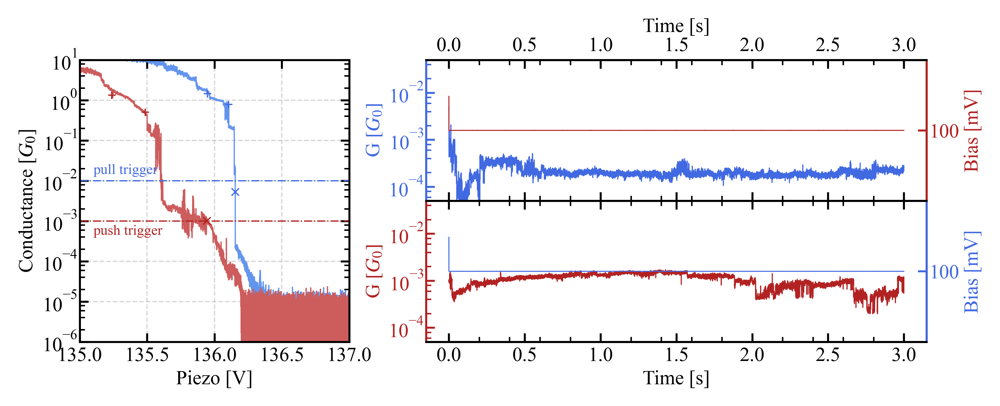

In [76]:
fig = plt.figure(figsize=utils.cm2inch(16, 5), dpi=600)  # figsize: (width, height) in inches
gs = gridspec.GridSpec(nrows=2, ncols=2, width_ratios=(0.35, 0.65), height_ratios=(1, 1),
                       figure=fig, left=0.2, right=0.95, top=0.95, bottom=0.15, wspace=0.2, hspace=0)

ax_trace = fig.add_subplot(gs[:, 0])
ax_pull = fig.add_subplot(gs[0, 1])
ax_push = fig.add_subplot(gs[1, 1])

ax_trace.xaxis.set_ticks_position('both')
ax_trace.yaxis.set_ticks_position('both')

ax_pull.xaxis.tick_top()
ax_pull.xaxis.set_label_position('top')
ax_pull.xaxis.set_ticks_position('both')
ax_push.xaxis.set_ticks_position('both')

print(np.intersect1d(pull_traces, push_traces, assume_unique=True).shape)
# num = np.random.choice(np.intersect1d(pull_traces, push_traces, assume_unique=True))
num = 12389
print(num)

trace_pair = TracePair(num, home_folder)
ax_trace = trace_pair.plot_trace_pair(ax=ax_trace, xlim=(135, 137),
                                      colors=('cornflowerblue', 'indianred'),
                                      accent_colors=('royalblue', 'firebrick'))

ax_trace.text(ax_trace.get_xlim()[0]+0.1, 1.5*trace_pair.hold_set_pull, 'pull trigger', fontsize='xx-small', c='royalblue')
ax_trace.text(ax_trace.get_xlim()[0]+0.1, 0.8*trace_pair.hold_set_push, 'push trigger', fontsize='xx-small', c='firebrick', va='top')

hold_trace = HoldTrace(num, load_from=home_folder, min_step_len=0, bias_offset=0)
hold_trace.analyse_hold_trace(num_of_fft=1)

ax_pull = hold_trace.plot_hold_traces(plot_step_ranges=False, plot_psd_intervals=False, conductance=True, ax=ax_pull,
                            ax_colors=('royalblue', 'firebrick'))
ax_push = hold_trace.plot_hold_traces(plot_step_ranges=False, plot_psd_intervals=False, conductance=True, ax=ax_push,
                            ax_colors=('royalblue', 'firebrick'),
                            pull=False, push=True)

ax_pull.set_ylim(5e-5, 0.05)
ax_pull.xaxis.set_minor_locator(MultipleLocator(0.2))
ax_push.set_ylim(5e-5, 0.05)
ax_push.xaxis.set_minor_locator(MultipleLocator(0.2))

plt.savefig(home_folder.joinpath(f'results/measurement_scheme_{num}.png'), bbox_inches='tight')

In [74]:
trace_pair.hold_set_pull*1.5

0.015

In [50]:
pull_blocks = np.unique(np.array(list(map(utils.convert_to_block_and_trace_num, pull_traces)))[:,0])
push_blocks = np.unique(np.array(list(map(utils.convert_to_block_and_trace_num, push_traces)))[:,0])

In [51]:
pull_conds = list()
count=0

if 'H_pull' in locals():
    del(H_pull)
xrange=(0, 150_000)
yrange=(1e-2, 100)
xbins = np.linspace(xrange[0], xrange[1], num=15000)

num_of_decs = np.log10(yrange[1]) - np.log10(yrange[0])
ybins = np.logspace(np.log10(yrange[0]), np.log10(yrange[1]), num=int(100 * num_of_decs), base=10)

for file_num in tqdm(pull_blocks, desc="Processing hold files"):
    hold_file = home_folder.joinpath(f'hold_data_{file_num}.h5')
    bj_file = home_folder.joinpath(re.sub(r'hold_data', r'break_junction', hold_file.name))
    with h5py.File(bj_file, "r") as bj_in:
        with h5py.File(hold_file, "r") as hold_in:
            for trace in pull_traces[count:]:
                try:
                    bj_trace = TracePair(trace=trace, load_from=bj_in)
                    hold_trace = HoldTrace(trace=trace, load_from=hold_in,
                                           bias_offset=0, r_serial_ohm=bj_trace.R_serial,
                                           sample_rate=bj_trace.sample_rate, min_step_len=0)
                    
                    x = np.arange(0, hold_trace.hold_conductance_pull.shape[0])
                    h, xedges, yedges = np.histogram2d(x,
                                                       hold_trace.hold_conductance_pull/hold_trace.hold_conductance_pull[-1],
                                                       bins=[xbins, ybins])
                    x_mesh, y_mesh = np.meshgrid(xedges, yedges)

                    if 'H_pull' in locals():
                        H_pull += h.T
                    else:
                        H_pull = h.T
                    
#                     pull_conds.append(hold_trace.hold_conductance_pull)
                    count += 1

                except KeyError:
                    break

Processing hold files: 100%|██████████| 151/151 [58:24<00:00, 23.21s/it]


In [52]:
push_conds = list()
count=0

if 'H_push' in locals():
    del(H_push)
xrange=(0, 150_000)
yrange=(1e-2, 100)
xbins = np.linspace(xrange[0], xrange[1], num=15000)

num_of_decs = np.log10(yrange[1]) - np.log10(yrange[0])
ybins = np.logspace(np.log10(yrange[0]), np.log10(yrange[1]), num=int(100 * num_of_decs), base=10)

for file_num in tqdm(push_blocks, desc="Processing hold files"):
    hold_file = home_folder.joinpath(f'hold_data_{file_num}.h5')
    bj_file = home_folder.joinpath(re.sub(r'hold_data', r'break_junction', hold_file.name))
    with h5py.File(bj_file, "r") as bj_in:
        with h5py.File(hold_file, "r") as hold_in:
            for trace in push_traces[count:]:
                try:
                    bj_trace = TracePair(trace=trace, load_from=bj_in)
                    hold_trace = HoldTrace(trace=trace, load_from=hold_in,
                                           bias_offset=0, r_serial_ohm=bj_trace.R_serial,
                                           sample_rate=bj_trace.sample_rate, min_step_len=0)
                    
                    x = np.arange(0, hold_trace.hold_conductance_push.shape[0])
                    h, xedges, yedges = np.histogram2d(x,
                                                       hold_trace.hold_conductance_push/hold_trace.hold_conductance_push[-1],
                                                       bins=[xbins, ybins])
                    x_mesh, y_mesh = np.meshgrid(xedges, yedges)

                    if 'H_push' in locals():
                        H_push += h.T
                    else:
                        H_push = h.T
                    
#                     push_conds.append(hold_trace.hold_conductance_push)
                    count += 1

                except KeyError:
                    break

Processing hold files: 100%|██████████| 151/151 [54:33<00:00, 21.68s/it]


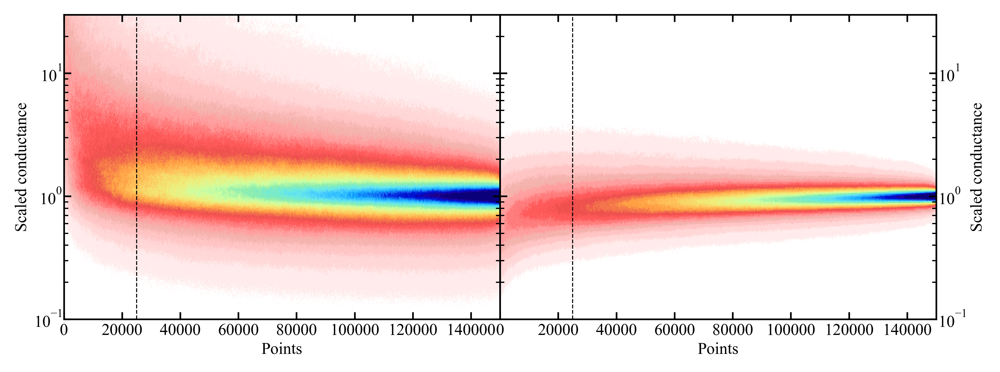

In [58]:
fig = plt.figure(figsize=utils.cm2inch(20, 7), dpi=600)  # figsize: (width, height) in inches
gs = gridspec.GridSpec(nrows=1, ncols=2, figure=fig,
                       left=0.15, right=0.9, top=0.9, bottom=0.15, wspace=0, hspace=0)

ax_pull = fig.add_subplot(gs[0])
ax_push = fig.add_subplot(gs[1])

ax_push.yaxis.set_label_position("right")
ax_push.yaxis.tick_right()

ax_pull.xaxis.set_ticks_position('both')
ax_pull.yaxis.set_ticks_position('both')
ax_push.xaxis.set_ticks_position('both')
ax_push.yaxis.set_ticks_position('both')

ax_pull.set_yscale('log')
ax_push.set_yscale('log')
ax_pull.set_ylim(1e-1, 30)
ax_push.set_ylim(1e-1, 30)

# ax_pull.set_xlim(0, 15000)
# ax_push.set_xlim(0, 15000)

im_norm_pull = ax_pull.pcolormesh(x_mesh, y_mesh, H_pull, cmap=utils.cmap_geo32, vmax=3000)
im_norm_push = ax_push.pcolormesh(x_mesh, y_mesh, H_push, cmap=utils.cmap_geo32, vmax=10000)

ax_pull.set_ylabel('Scaled conductance')
ax_push.set_ylabel('Scaled conductance')
ax_pull.set_xlabel('Points')
ax_push.set_xlabel('Points')

ax_pull.axvline(0.5*50_000, ls='--', lw=0.5, c='k')
ax_push.axvline(0.5*50_000, ls='--', lw=0.5, c='k')

# plt.savefig(home_folder.joinpath(f'results/relax_2d_hist_unfiltered.png'), bbox_inches='tight')

In [377]:
arr, counts = np.unique(np.array(list(map(np.shape, pull_conds))), return_counts=True)

In [380]:
counts

array([  1,   1,   2,   3,   1,   3,   4,   6,   2,   3,   4,   6,   8,
         7,  14,  11,  21,  44,  97, 171, 290, 443, 762, 620], dtype=int64)

In [381]:
counts[-7:].sum()/counts.sum()

0.9615689381933439

In [382]:
arr[-6:]

array([149997, 149998, 149999, 150000, 150001, 150002])

In [38]:
arr_pull, counts = np.unique(np.array(list(map(np.shape, pull_conds))), return_counts=True)
print(arr_pull)
print(counts)
arr_push, counts = np.unique(np.array(list(map(np.shape, push_conds))), return_counts=True)
print(arr_push)
print(counts)

[149975 149978 149981 149982 149983 149984 149985 149986 149987 149988
 149989 149990 149991 149992 149993 149994 149995 149996 149997 149998
 149999 150000 150001 150002]
[  1   1   2   3   1   3   4   6   2   3   4   6   8   7  14  11  21  44
  97 171 290 443 762 620]
[149978 149979 149980 149981 149982 149983 149984 149985 149986 149987
 149988 149989 149990 149991 149992 149993 149994 149995 149996 149997
 149998 149999 150000 150001 150002]
[   1    3    1    4    5    3   14   18   26   22   22   20   12   20
   25   47   78  104  185  377  656 1148 1744 3021 2612]


In [39]:
pull_conds_arr = np.array(list(map(lambda x: x[:min(arr_pull)], pull_conds)))
push_conds_arr = np.array(list(map(lambda x: x[:min(arr_push)], push_conds)))

In [22]:
if 'H_pull' in locals():
    del(H_pull)
xrange=(0, 150_000)
yrange=(1e-2, 100)
xbins = np.linspace(xrange[0], xrange[1], num=15000)

num_of_decs = np.log10(yrange[1]) - np.log10(yrange[0])
ybins = np.logspace(np.log10(yrange[0]), np.log10(yrange[1]), num=int(100 * num_of_decs), base=10)

for pull_cond in tqdm(pull_conds, desc="Calculating pull 2d histogram"):
    x = np.arange(0, pull_cond.shape[0])
    h, xedges, yedges = np.histogram2d(x, pull_cond/pull_cond[-1], bins=[xbins, ybins])
    x_mesh, y_mesh = np.meshgrid(xedges, yedges)
    
    if 'H_pull' in locals():
        H_pull += h.T
    else:
        H_pull = h.T

In [25]:
if 'H_push' in locals():
    del(H_push)
xrange=(0, 150_000)
yrange=(1e-2, 100)
xbins = np.linspace(xrange[0], xrange[1], num=15000)

num_of_decs = np.log10(yrange[1]) - np.log10(yrange[0])
ybins = np.logspace(np.log10(yrange[0]), np.log10(yrange[1]), num=int(100 * num_of_decs), base=10)

for push_cond in tqdm(push_conds, desc="Calculating push 2d histogram"):
    x = np.arange(0, push_cond.shape[0])
    h, xedges, yedges = np.histogram2d(x, push_cond/push_cond[-1], bins=[xbins, ybins])
    x_mesh, y_mesh = np.meshgrid(xedges, yedges)
    
    if 'H_push' in locals():
        H_push += h.T
    else:
        H_push = h.T

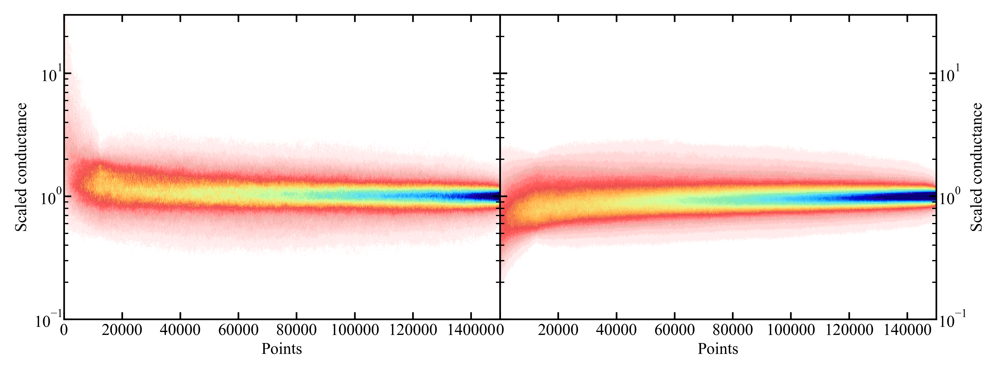

In [40]:
fig = plt.figure(figsize=utils.cm2inch(20, 7), dpi=600)  # figsize: (width, height) in inches
gs = gridspec.GridSpec(nrows=1, ncols=2, figure=fig,
                       left=0.15, right=0.9, top=0.9, bottom=0.15, wspace=0, hspace=0)

ax_pull = fig.add_subplot(gs[0])
ax_push = fig.add_subplot(gs[1])

ax_push.yaxis.set_label_position("right")
ax_push.yaxis.tick_right()

ax_pull.xaxis.set_ticks_position('both')
ax_pull.yaxis.set_ticks_position('both')
ax_push.xaxis.set_ticks_position('both')
ax_push.yaxis.set_ticks_position('both')

ax_pull.set_yscale('log')
ax_push.set_yscale('log')
ax_pull.set_ylim(1e-1, 30)
ax_push.set_ylim(1e-1, 30)

# ax_pull.set_xlim(0, 15000)
# ax_push.set_xlim(0, 15000)

im_norm_pull = ax_pull.pcolormesh(x_mesh, y_mesh, H_pull, cmap=utils.cmap_geo32, vmax=1500)
im_norm_push = ax_push.pcolormesh(x_mesh, y_mesh, H_push, cmap=utils.cmap_geo32, vmax=6000)

ax_pull.set_ylabel('Scaled conductance')
ax_push.set_ylabel('Scaled conductance')
ax_pull.set_xlabel('Points')
ax_push.set_xlabel('Points')

plt.savefig(home_folder.joinpath(f'results/relax_2d_hist_filtered.png'), bbox_inches='tight')

In [15]:
cols = np.array(list(conductance_stat_pull.columns[-25:]))

In [16]:
conductance_stat_pull_above[cols].to_numpy().shape

(6411, 25)

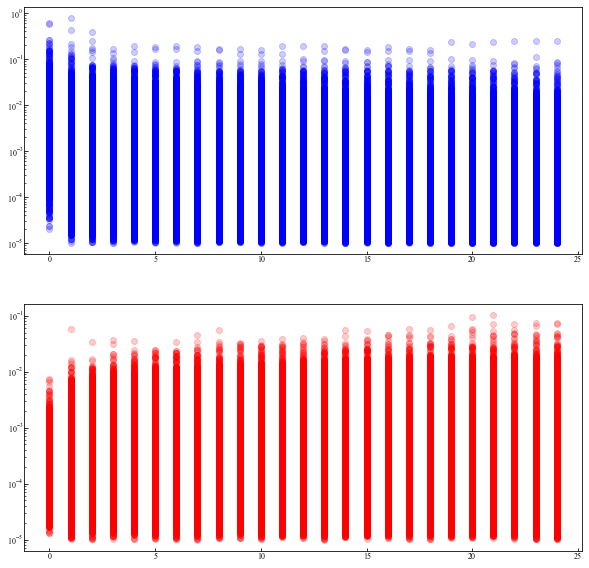

In [17]:
fig, ax = plt.subplots(nrows=2, ncols=1, figsize=(10, 10))

for row in conductance_stat_pull_above[cols].to_numpy():
    ax[0].plot(row, marker='o', ls='', c='b', alpha=0.2)
    ax[0].set_yscale('log')
    
for row in conductance_stat_push_above[cols].to_numpy():
    ax[1].plot(row, marker='o', ls='', c='r', alpha=0.2)
    ax[1].set_yscale('log')

In [23]:
indices_pull = conductance_stat_pull_above[:][
               abs(np.log10(conductance_stat_pull_above['G_avgs_25'] / conductance_stat_pull_above['G_avgs_3'])) < np.log10(2)].index
indices_push = conductance_stat_push_above[:][
               abs(np.log10(conductance_stat_push_above['G_avgs_25'] / conductance_stat_push_above['G_avgs_3'])) < np.log10(2)].index

# not_indices = conductance_stat_pull_above.index.difference(indices)

In [24]:
indices_pull = np.array(conductance_stat_pull_above['trace_index'][indices_pull], dtype=int)
indices_push = np.array(conductance_stat_push_above['trace_index'][indices_push], dtype=int)

indices = np.intersect1d(indices_pull, indices_push, assume_unique=True)

In [25]:
print(indices_pull.shape)
print(indices_push.shape)
print(indices.shape)

(4418,)
(10249,)
(2979,)


In [22]:
indices[10:20]

array([8125, 8152, 8153, 8159, 8160, 8161, 8184, 8213, 8217, 8221])

In [42]:
type(indices[0])

numpy.int32

bias_steps [0.1000061]
bias_steps [0.1000061]
18241


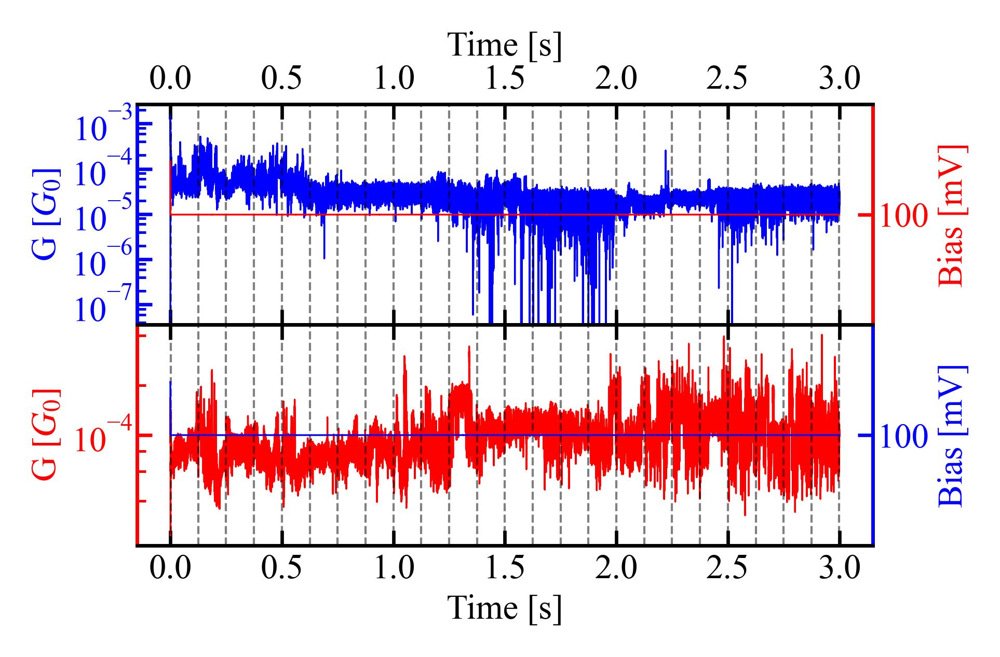

In [43]:
fig = plt.figure(figsize=utils.cm2inch(8, 4.5), dpi=600)  # figsize: (width, height) in inches
gs = gridspec.GridSpec(nrows=2, ncols=1,
                       figure=fig, left=0.2, right=0.95, top=0.95, bottom=0.15, wspace=0, hspace=0)

ax_pull = fig.add_subplot(gs[0])
ax_push = fig.add_subplot(gs[1])

ax_pull.xaxis.tick_top()
ax_pull.xaxis.set_label_position('top')
ax_pull.xaxis.set_ticks_position('both')
ax_push.xaxis.set_ticks_position('both')

hold_trace = HoldTrace(18241, load_from=home_folder, min_step_len=0, bias_offset=0)
hold_trace.analyse_hold_trace(num_of_fft=1)

hold_trace.plot_hold_traces(plot_step_ranges=False, plot_psd_intervals=False, conductance=True, ax=ax_pull, 
                            add_vlines=np.mean(hold_trace.test_intervals_pull, axis=1)/50_000)
hold_trace.plot_hold_traces(plot_step_ranges=False, plot_psd_intervals=False, conductance=True, ax=ax_push, 
                            add_vlines=np.mean(hold_trace.test_intervals_pull, axis=1)/50_000, pull=False, push=True)

print(hold_trace.trace_num)

plt.savefig(home_folder.joinpath(f'results/single_bias_{num}.png'), bbox_inches='tight')

bias_steps [0.1000061]
bias_steps [0.1000061]
bias_steps [0.1000061]
bias_steps [0.1000061]
bias_steps [0.1000061]
bias_steps [0.1000061]
bias_steps [0.1000061]
bias_steps [0.1000061]
bias_steps [0.1000061]
bias_steps [0.1000061]
bias_steps [0.1000061]
bias_steps [0.1000061]
bias_steps [0.1000061]
bias_steps [0.1000061]
bias_steps [0.1000061]
bias_steps [0.1000061]
bias_steps [0.1000061]
bias_steps [0.1000061]
bias_steps [0.1000061]
bias_steps [0.1000061]
bias_steps [0.1000061]
bias_steps [0.1000061]
bias_steps [0.1000061]
bias_steps [0.1000061]


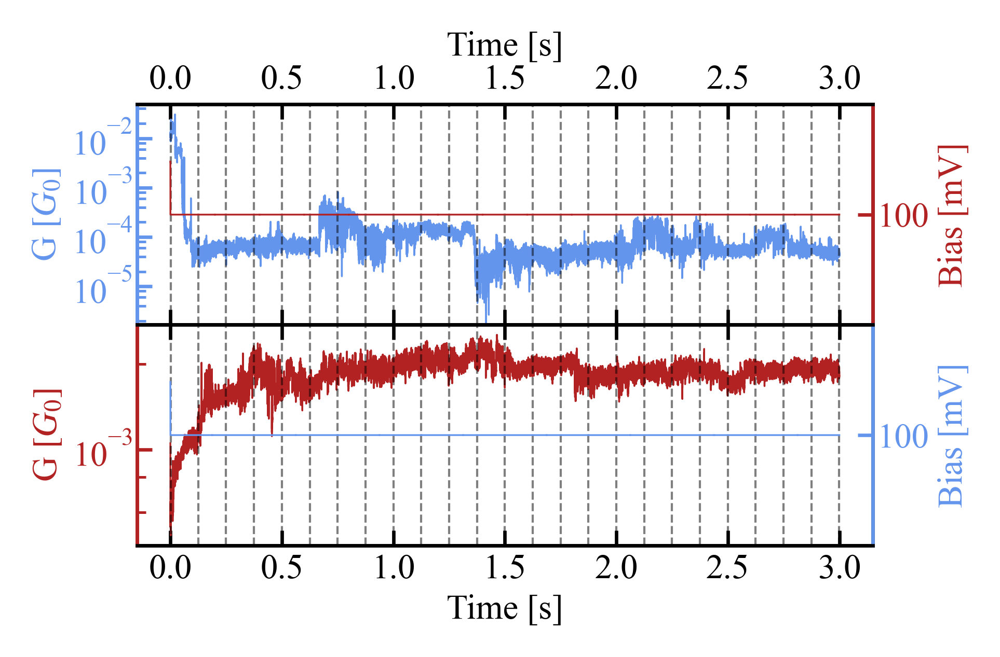

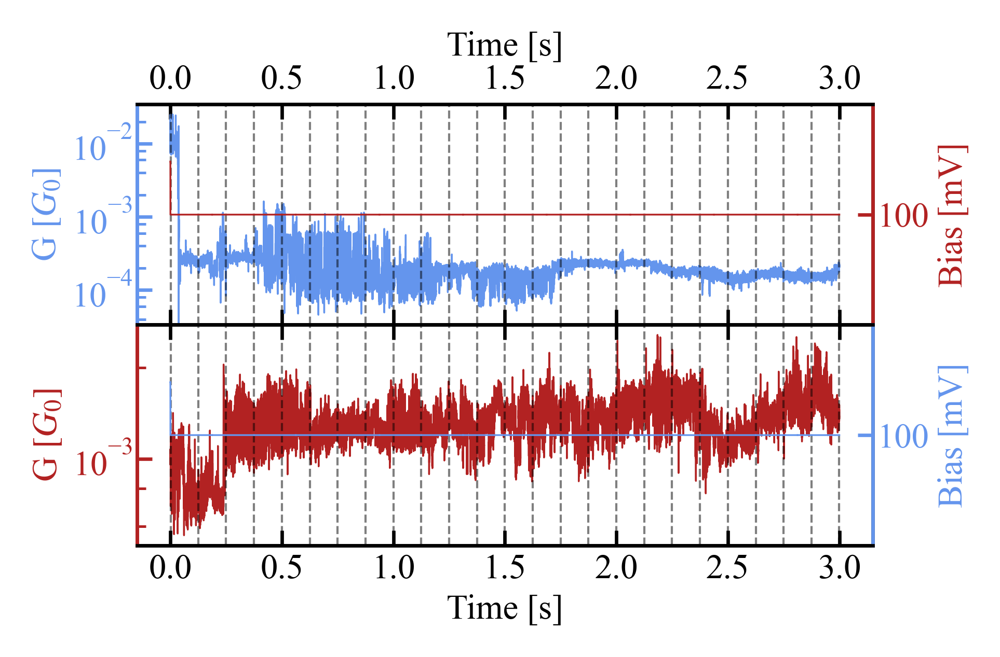

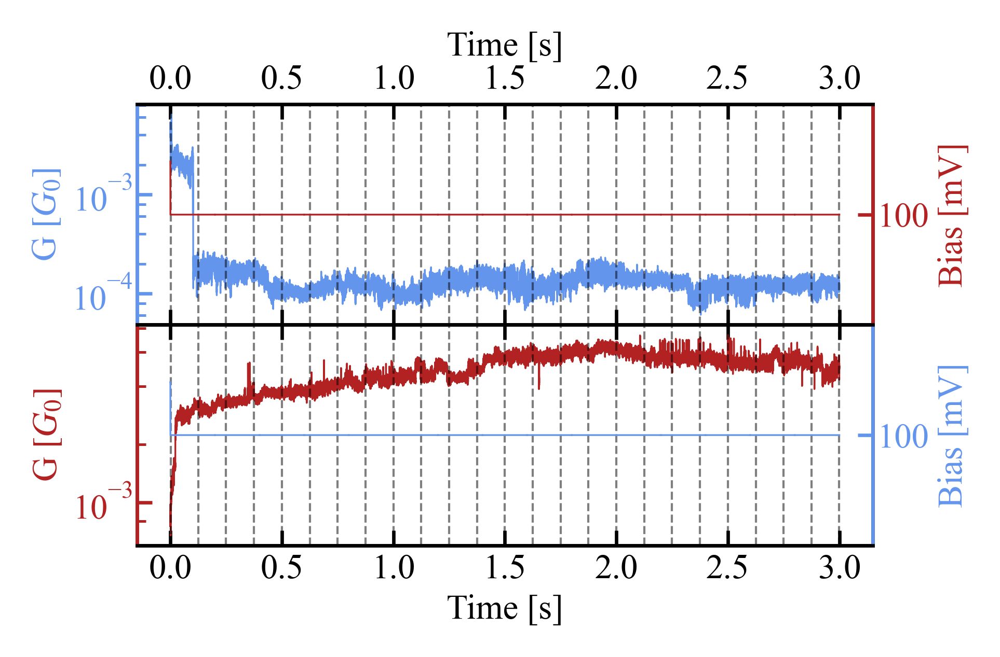

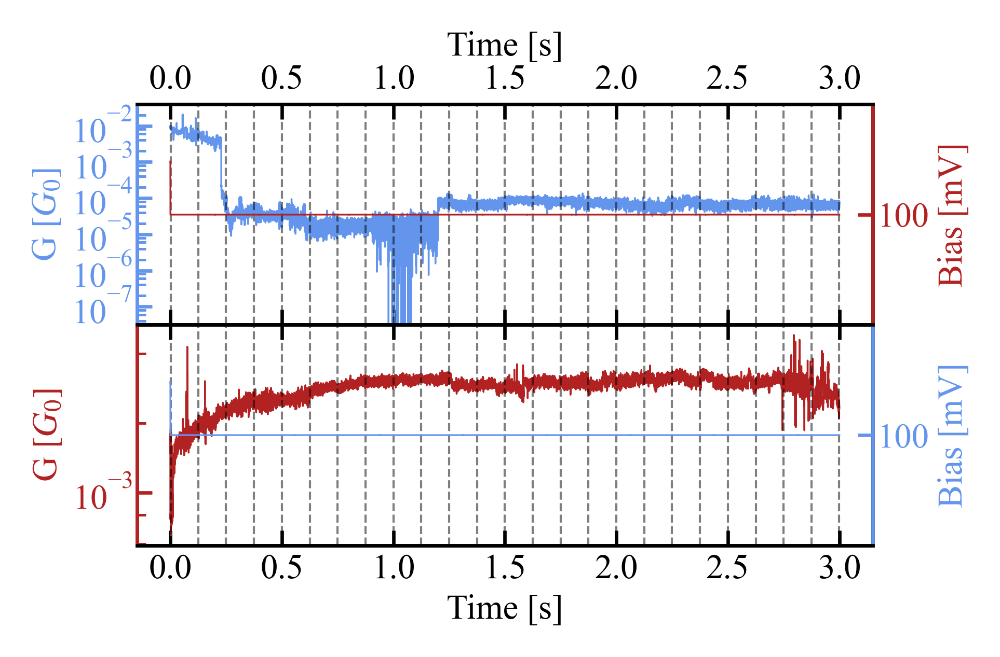

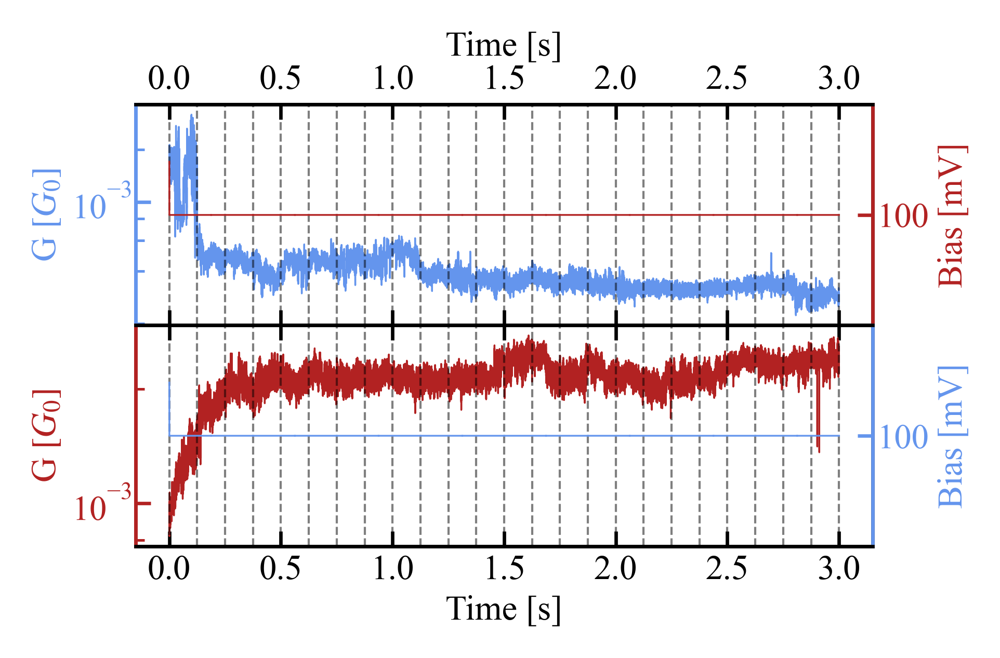

...

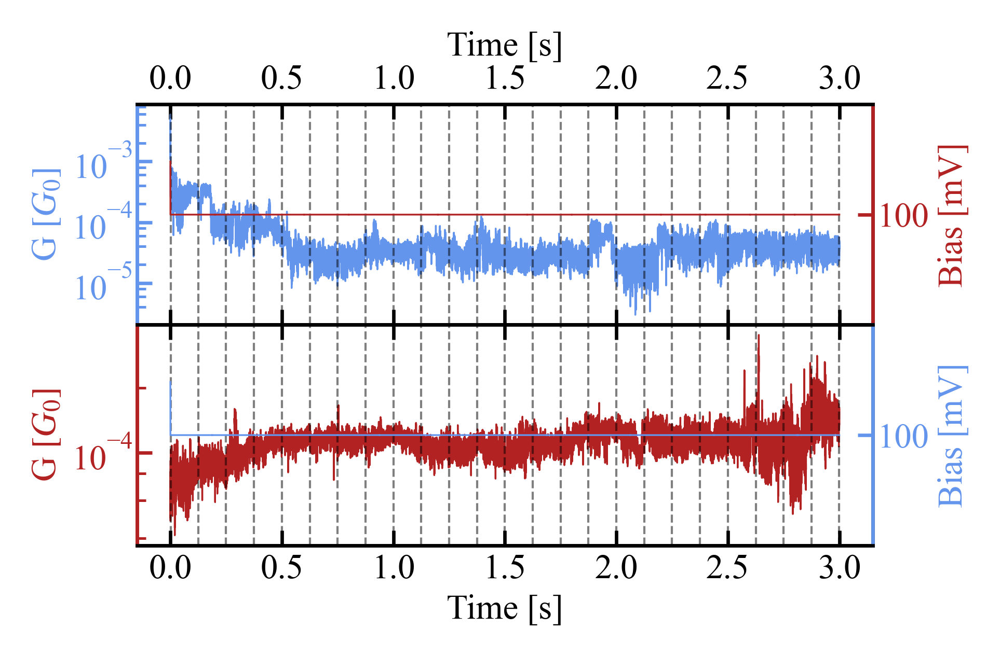

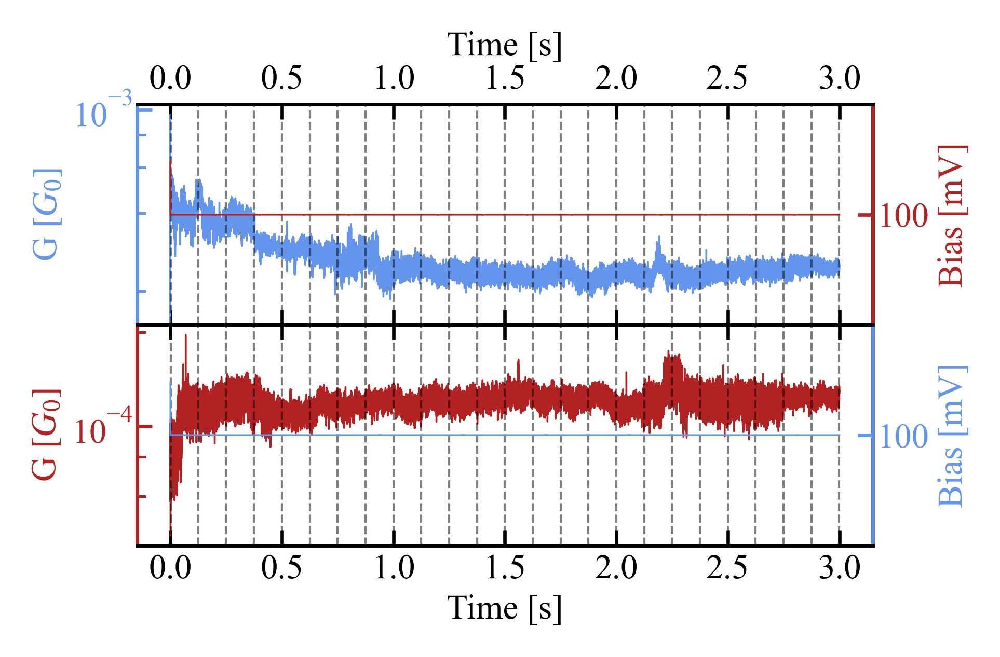

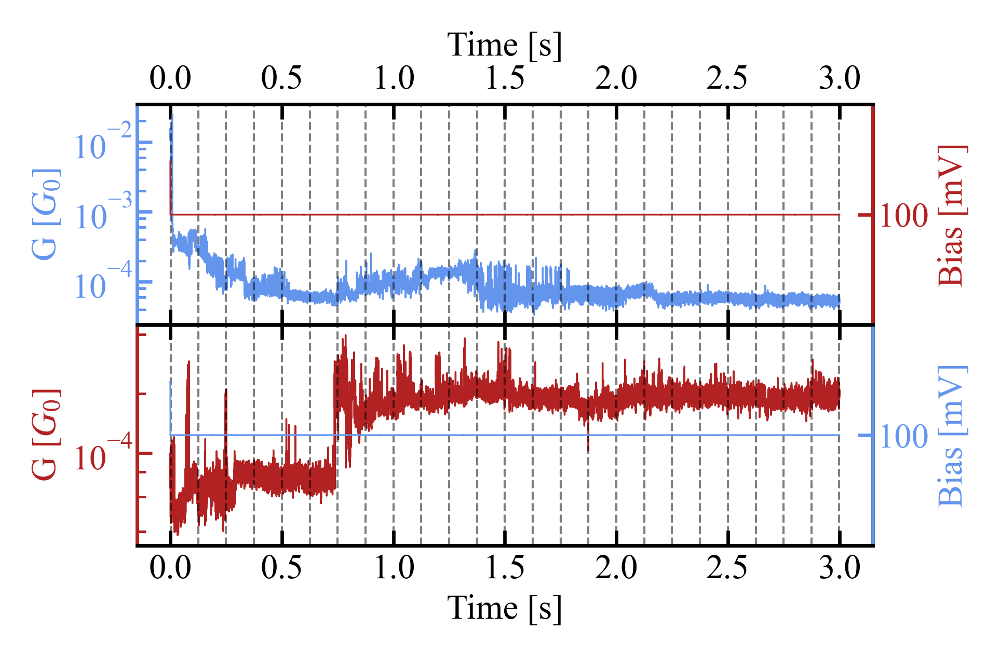

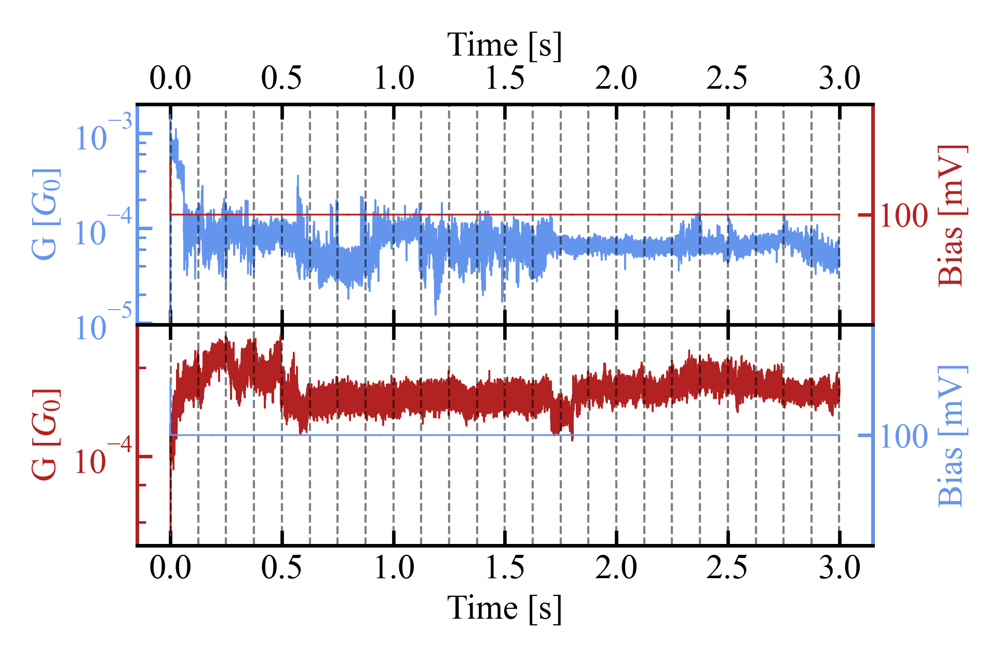

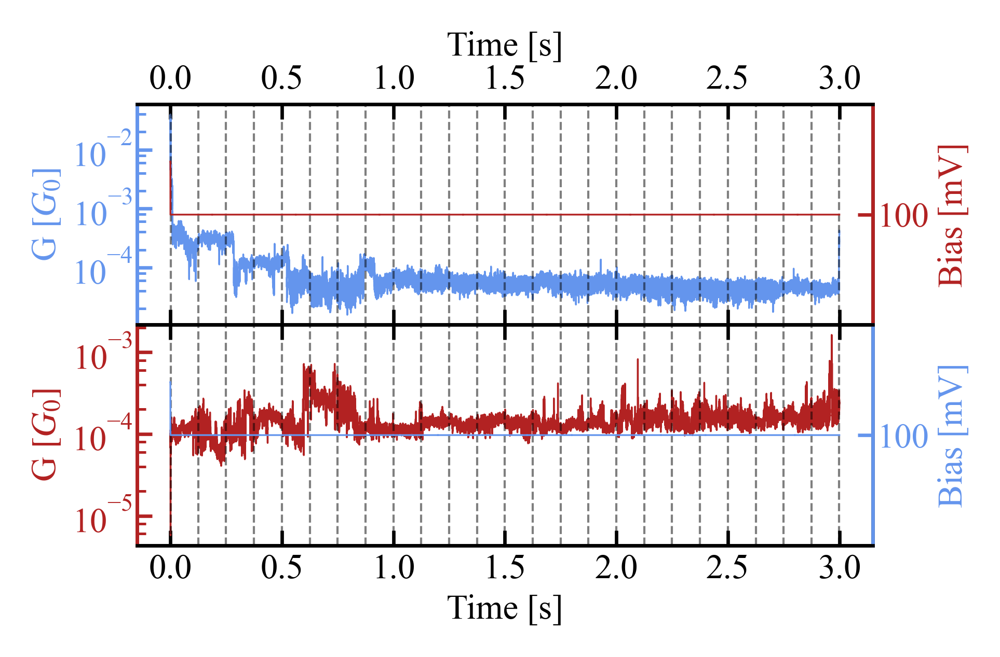

In [58]:
# for num in np.random.choice(indices, size=10):
for num in [8152, 8153, 8159, 8160, 8409, 11232, 13737, 15578, 16245, 16914, 17735, 19659]:

    fig = plt.figure(figsize=utils.cm2inch(8, 4.5), dpi=600)  # figsize: (width, height) in inches
    gs = gridspec.GridSpec(nrows=2, ncols=1,
                           figure=fig, left=0.2, right=0.95, top=0.95, bottom=0.15, wspace=0, hspace=0)

    ax_pull = fig.add_subplot(gs[0])
    ax_push = fig.add_subplot(gs[1])

    ax_pull.xaxis.tick_top()
    ax_pull.xaxis.set_label_position('top')
    ax_pull.xaxis.set_ticks_position('both')
    ax_push.xaxis.set_ticks_position('both')

    hold_trace = HoldTrace(num, load_from=home_folder, min_step_len=0, bias_offset=0)
    hold_trace.analyse_hold_trace(num_of_fft=1)

    hold_trace.plot_hold_traces(plot_step_ranges=False, plot_psd_intervals=False, conductance=True, ax=ax_pull,
                                ax_colors=('cornflowerblue', 'firebrick'),
                                add_vlines=np.mean(hold_trace.test_intervals_pull, axis=1)/50_000)
    hold_trace.plot_hold_traces(plot_step_ranges=False, plot_psd_intervals=False, conductance=True, ax=ax_push,
                                ax_colors=('cornflowerblue', 'firebrick'),
                                add_vlines=np.mean(hold_trace.test_intervals_pull, axis=1)/50_000, pull=False, push=True)

#     print(hold_trace.trace_num)

    plt.savefig(home_folder.joinpath(f'results/single_bias_{num}.png'), bbox_inches='tight')

In [5]:
hold_trace=HoldTrace(8152, load_from=home_folder, min_step_len=0, bias_offset=0)
print(hold_trace.G_hold_pull)
print(trace_pair.hold_set_pull)
print(trace_pair.conductance_pull[trace_pair.hold_index_pull])
print(trace_pair.hold_conductance_pull)

0.009301943069874561
0.01
0.01046156
0.01046156


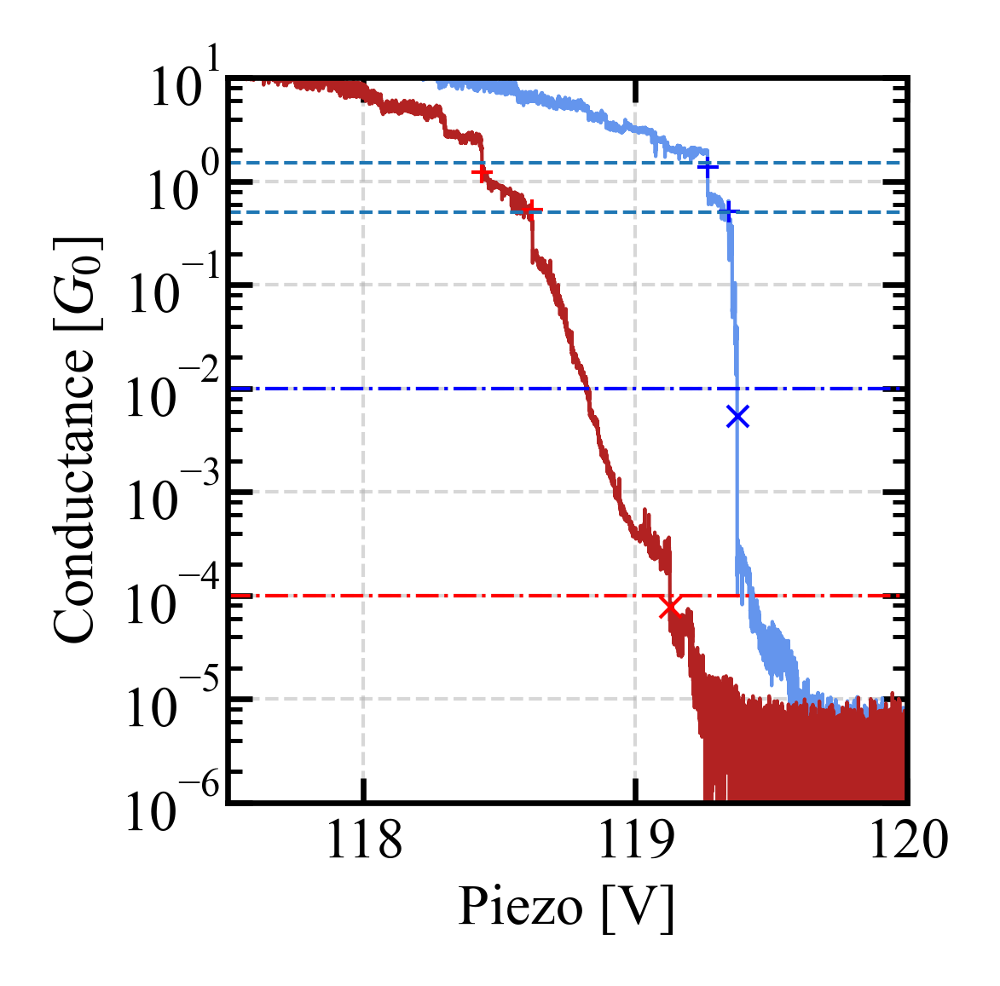

In [14]:
# for num in [8152, 8153, 8159, 8160, 8409, 11232, 13737, 15578, 16245, 16914, 17735, 19659]:

num = 19659

fig = plt.figure(figsize=utils.cm2inch(4.5, 4.5), dpi=600)  # figsize: (width, height) in inches
gs = gridspec.GridSpec(nrows=1, ncols=1,
                       figure=fig, left=0.2, right=0.95, top=0.95, bottom=0.15, wspace=0, hspace=0)

ax = fig.add_subplot(gs[0])
ax.xaxis.set_ticks_position('both')
ax.yaxis.set_ticks_position('both')

trace_pair = TracePair(num, home_folder)
trace_pair.plot_trace_pair(ax=ax, xlim=(117.5, 120))

plt.savefig(home_folder.joinpath(f'results/trace_pair_{num}.png'), bbox_inches='tight')

In [22]:
indices

NameError: name 'indices' is not defined

In [75]:
not_indices

Int64Index([    7,    13,    16,    24,    26,    27,    37,    38,    41,
               53,
            ...
            14940, 14946, 14948, 14952, 14953, 14962, 14981, 14982, 14987,
            14993],
           dtype='int64', length=5342)

In [241]:
rcParams['xtick.labelsize'] = 7
rcParams['ytick.labelsize'] = 7

In [90]:
test1=np.ones(10)
test2=np.ones((2, 10))

print(test1.shape[0]==test2.shape[1])
for i in test2:
    print(i.shape)
    print('-----')
    
len(test1.shape)

True
(10,)
-----
(10,)
-----


1

In [93]:
np.ceil(16/3).astype(int)

6

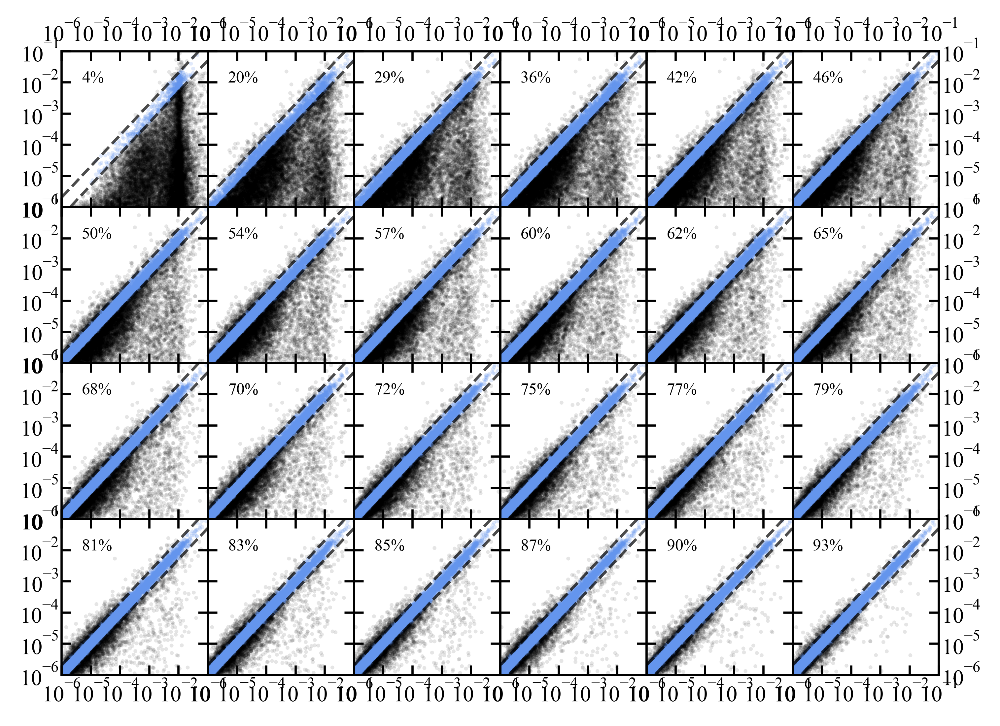

In [46]:
fig = plt.figure(figsize=utils.cm2inch(15, 10), dpi=600)  # figsize: (width, height) in inches
gs = gridspec.GridSpec(nrows=4, ncols=6,
                       figure=fig, left=0.2, right=0.95, top=0.95, bottom=0.15, wspace=0, hspace=0)

which_cols = np.array(list(conductance_stat_pull.columns[-25:-1])).reshape(4, 6)
ratios_pull = []

for i, row in enumerate(which_cols):
    for j, col in enumerate(row):
        ax = fig.add_subplot(gs[i, j])
        ax.xaxis.set_ticks_position('both')
        ax.yaxis.set_ticks_position('both')
        if j == 5:
            ax.yaxis.tick_right()
            ax.yaxis.set_label_position('right')
            ax.xaxis.set_ticks_position('both')
        ax.yaxis.set_ticks_position('both')
        if i == 0:
            ax.xaxis.tick_top()
            ax.xaxis.set_label_position('top')
            ax.xaxis.set_ticks_position('both')
            ax.yaxis.set_ticks_position('both')
        indices = np.array(conductance_stat_pull_above[:][
            abs(np.log10(conductance_stat_pull_above['G_avgs_25'] / conductance_stat_pull_above[col])) < np.log10(2)].index)
        not_indices = conductance_stat_pull_above.index.difference(indices)
        
        perc = round(len(indices)/conductance_stat_pull_above['trace_index'].count()*100)
        ratios_pull.append(perc)
        
        ax.text(5e-6, 1e-2, s=str(perc)+'%', size=6)
        ax.scatter(conductance_stat_pull_above[col][indices], conductance_stat_pull_above['G_avgs_25'][indices],
                         alpha=0.2, c='cornflowerblue', edgecolor='None', s=2)
        ax.scatter(conductance_stat_pull_above[col][not_indices], conductance_stat_pull_above['G_avgs_25'][not_indices],
                         alpha=0.1, c='k', edgecolor='None', s=2)
#         ax.scatter(conductance_stat_pull_above[col], conductance_stat_pull_above['G_avgs_25'],
#                           alpha=0.2, c='cornflowerblue', edgecolor='None', s=2)
        ax.set_xscale('log')
        ax.set_yscale('log')
        ax.set_xlim(1e-6, 0.1)
        ax.set_ylim(1e-6, 0.1)
        ax.xaxis.set_major_locator(ticker.LogLocator(base=10.0, subs=(1.0,), numticks=6))
#         ax.xaxis.set_minor_locator(ticker.LogLocator(base=10.0, subs=np.arange(0, 1, 0.1), numticks=9))
        ax.xaxis.set_minor_formatter(ticker.NullFormatter())
        ax.yaxis.set_major_locator(ticker.LogLocator(base=10.0, subs=(1.0,), numticks=6))
        ax.yaxis.set_minor_locator(ticker.LogLocator(base=10.0, subs=np.arange(0, 1, 0.1), numticks=1))
        ax.yaxis.set_minor_formatter(ticker.NullFormatter())
#         ax.xaxis.set_ticklabels(['', r'$10{-5}$', r'$10{-4}$', r'$10{-3}$', r'$10{-2}$',''])
#         ax.yaxis.set_ticklabels(['', r'$10{-5}$', r'$10{-4}$', r'$10{-3}$', r'$10{-2}$',''])
#         ax.set_ylabel('G_avgs_25')
#         ax.set_xlabel(col)
        if j>0 and j<5:
            ax.yaxis.set_ticklabels([])
        if i>0 and i<3:
            ax.xaxis.set_ticklabels([])
#         ax.plot(np.logspace(-7, 0, num=10, base=10), np.logspace(-7, 0, num=10, base=10), c='k', ls='--', lw=1, alpha=0.7)
        ax.plot(np.logspace(-7, 0, num=10, base=10), 2*np.logspace(-7, 0, num=10, base=10), c='k', ls='--', lw=1, alpha=0.7)
        ax.plot(2*np.logspace(-7, 0, num=10, base=10), np.logspace(-7, 0, num=10, base=10), c='k', ls='--', lw=1, alpha=0.7)

plt.savefig(home_folder.joinpath('results/pull_relax.png'), bbox_inches='tight')

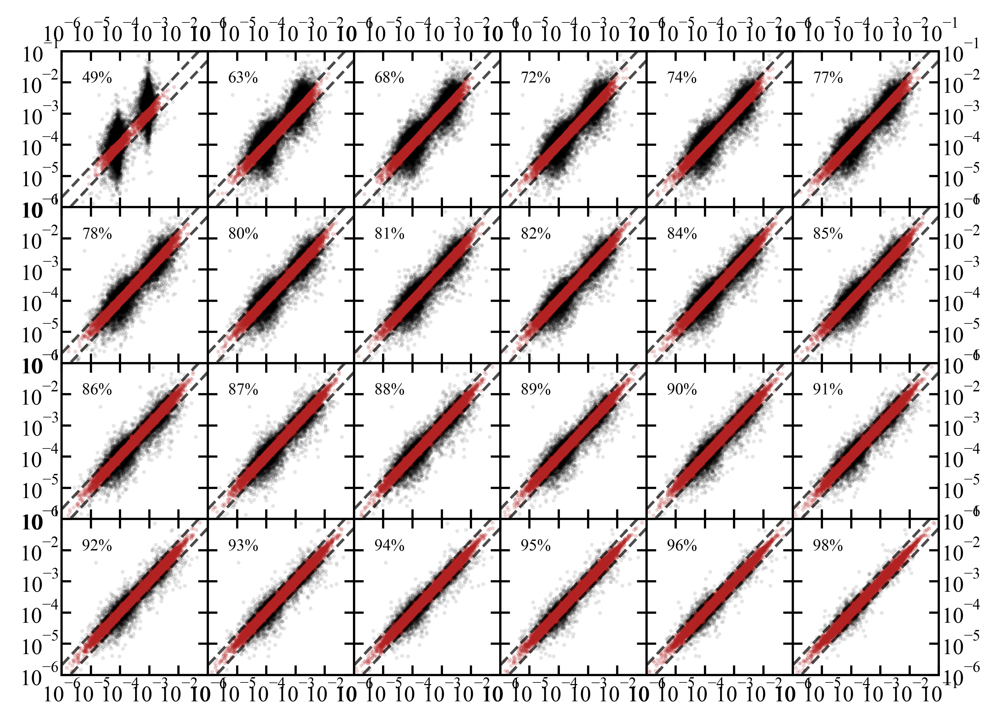

In [47]:
fig = plt.figure(figsize=utils.cm2inch(15, 10), dpi=600)  # figsize: (width, height) in inches
gs = gridspec.GridSpec(nrows=4, ncols=6,
                       figure=fig, left=0.2, right=0.95, top=0.95, bottom=0.15, wspace=0, hspace=0)

which_cols = np.array(list(conductance_stat_push.columns[-25:-1])).reshape(4, 6)
ratios_push = []

for i, row in enumerate(which_cols):
    for j, col in enumerate(row):
        ax = fig.add_subplot(gs[i, j])
        ax.xaxis.set_ticks_position('both')
        ax.yaxis.set_ticks_position('both')
        if j == 5:
            ax.yaxis.tick_right()
            ax.yaxis.set_label_position('right')
            ax.xaxis.set_ticks_position('both')
        ax.yaxis.set_ticks_position('both')
        if i == 0:
            ax.xaxis.tick_top()
            ax.xaxis.set_label_position('top')
            ax.xaxis.set_ticks_position('both')
            ax.yaxis.set_ticks_position('both')
        indices = np.array(conductance_stat_push_above[:][
            abs(np.log10(conductance_stat_push_above['G_avgs_25'] / conductance_stat_push_above[col])) < np.log10(2)].index)
        not_indices = conductance_stat_push_above.index.difference(indices)
        
        perc = round(len(indices)/conductance_stat_push_above['trace_index'].count()*100)
        ratios_push.append(perc)
        
        ax.text(5e-6, 1e-2, s=str(perc)+'%', size=6)
        ax.scatter(conductance_stat_push_above[col][indices], conductance_stat_push_above['G_avgs_25'][indices],
                         alpha=0.2, c='firebrick', edgecolor='None', s=2)
        ax.scatter(conductance_stat_push_above[col][not_indices], conductance_stat_push_above['G_avgs_25'][not_indices],
                         alpha=0.1, c='k', edgecolor='None', s=2)
#         ax.scatter(conductance_stat_push_above[col], conductance_stat_push_above['G_avgs_25'],
#                          alpha=0.2, c='firebrick', edgecolor='None', s=2)
        ax.set_xscale('log')
        ax.set_yscale('log')
        ax.set_xlim(1e-6, 0.1)
        ax.set_ylim(1e-6, 0.1)
        ax.xaxis.set_major_locator(ticker.LogLocator(base=10.0, subs=(1.0,), numticks=6))
#         ax.xaxis.set_minor_locator(ticker.LogLocator(base=10.0, subs=np.arange(0, 1, 0.1), numticks=9))
        ax.xaxis.set_minor_formatter(ticker.NullFormatter())
        ax.yaxis.set_major_locator(ticker.LogLocator(base=10.0, subs=(1.0,), numticks=6))
        ax.yaxis.set_minor_locator(ticker.LogLocator(base=10.0, subs=np.arange(0, 1, 0.1), numticks=1))
        ax.yaxis.set_minor_formatter(ticker.NullFormatter())
#         ax.set_ylabel('G_avgs_25')
#         ax.set_xlabel(col)
        if j>0 and j<5:
            ax.yaxis.set_ticklabels([])
        if i>0 and i<3:
            ax.xaxis.set_ticklabels([])
#         ax.plot(np.logspace(-7, 0, num=10, base=10), np.logspace(-7, 0, num=10, base=10), c='k', ls='--', lw=1, alpha=0.7)
        ax.plot(np.logspace(-7, 0, num=10, base=10), 2*np.logspace(-7, 0, num=10, base=10), c='k', ls='--', lw=1, alpha=0.7)
        ax.plot(2*np.logspace(-7, 0, num=10, base=10), np.logspace(-7, 0, num=10, base=10), c='k', ls='--', lw=1, alpha=0.7)
        
plt.savefig(home_folder.joinpath('results/push_relax.png'), bbox_inches='tight')

In [251]:
np.mean(hold_trace.test_intervals_pull, axis=1)/50_000

array([1.5000e-03, 1.2500e-01, 2.5000e-01, 3.7500e-01, 5.0000e-01,
       6.2500e-01, 7.5000e-01, 8.7500e-01, 1.0000e+00, 1.1250e+00,
       1.2500e+00, 1.3750e+00, 1.5000e+00, 1.6250e+00, 1.7500e+00,
       1.8750e+00, 2.0000e+00, 2.1250e+00, 2.2500e+00, 2.3750e+00,
       2.5000e+00, 2.6250e+00, 2.7500e+00, 2.8750e+00, 2.9985e+00])

In [252]:
np.mean(hold_trace.test_intervals_push, axis=1)/50_000

array([1.50000e-03, 1.24980e-01, 2.49980e-01, 3.74980e-01, 4.99980e-01,
       6.24980e-01, 7.49980e-01, 8.74980e-01, 9.99980e-01, 1.12498e+00,
       1.24998e+00, 1.37498e+00, 1.49998e+00, 1.62496e+00, 1.74996e+00,
       1.87496e+00, 1.99996e+00, 2.12496e+00, 2.24996e+00, 2.37496e+00,
       2.49996e+00, 2.62496e+00, 2.74996e+00, 2.87496e+00, 2.99846e+00])

In [49]:
from matplotlib.ticker import MultipleLocator

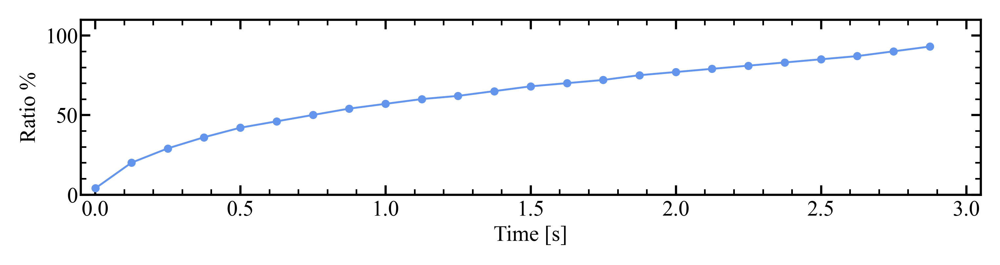

In [50]:
fig, ax = plt.subplots(1, figsize=utils.cm2inch(15, 3), dpi=600)
ax.plot(np.mean(hold_trace.test_intervals_pull, axis=1)[:-1]/50_000, ratios_pull, c='cornflowerblue',
        marker='o', markeredgecolor='None', markersize=3, lw=0.7)
ax.set_xlim(-0.05, 3.05)
ax.set_ylim(0, 110)
ax.xaxis.set_ticks_position('both')
ax.yaxis.set_ticks_position('both')
ax.xaxis.set_minor_locator(MultipleLocator(0.1))
ax.yaxis.set_minor_locator(MultipleLocator(10))
ax.set_xlabel('Time [s]')
ax.set_ylabel('Ratio %')

plt.savefig(home_folder.joinpath('results/ratios_pull.png'), bbox_inches='tight')

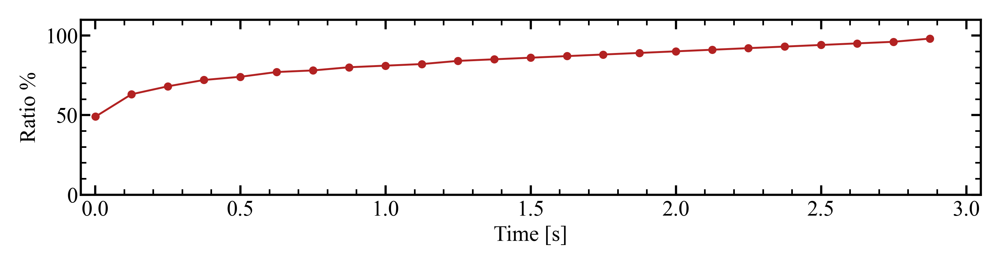

In [51]:
fig, ax = plt.subplots(1, figsize=utils.cm2inch(15, 3), dpi=600)
ax.plot(np.mean(hold_trace.test_intervals_push, axis=1)[:-1]/50_000, ratios_push, c='firebrick',
        marker='o', markeredgecolor='None', markersize=3, lw=0.7)
ax.set_xlim(-0.05, 3.05)
ax.set_ylim(0, 110)
ax.xaxis.set_ticks_position('both')
ax.yaxis.set_ticks_position('both')
ax.xaxis.set_minor_locator(MultipleLocator(0.1))
ax.yaxis.set_minor_locator(MultipleLocator(10))
ax.set_xlabel('Time [s]')
ax.set_ylabel('Ratio %')

plt.savefig(home_folder.joinpath('results/ratios_push.png'), bbox_inches='tight')

In [52]:
conductance_stat_pull_2 = pd.read_csv(home_folder.joinpath("results/conductance_stats_pull_2.csv"), skiprows=[1])
conductance_stat_push_2 = pd.read_csv(home_folder.joinpath("results/conductance_stats_push_2.csv"), skiprows=[1])

In [60]:
conductance_stat_pull_2

,trace_index,G_set,G_stop,G_hold,G_avg,G_beg_1,G_beg_2,G_beg_3,G_beg_4,G_end_1,G_end_2,G_end_3,G_end_4
0,34501.0,0.01,0.008969,0.009054,9.907212e-05,2.404208e-04,3.211253e-05,1.604849e-04,6.372670e-05,3.050414e-05,1.701588e-04,6.034157e-05,1.047741e-04
1,34502.0,0.01,0.009222,0.004181,4.675855e-07,1.148863e-04,1.556519e-06,1.922294e-06,-8.499433e-07,1.389546e-06,1.031221e-06,5.108723e-07,6.863965e-07
2,34503.0,0.01,0.005728,0.002002,7.448131e-07,2.334444e-07,9.078314e-07,5.454860e-07,-8.335287e-07,5.535309e-07,4.442999e-07,3.371574e-07,5.946254e-07
3,34504.0,0.01,0.008654,0.006193,1.945725e-03,1.426011e-03,2.261795e-03,1.462974e-03,2.094525e-03,3.314958e-03,1.421974e-03,3.515411e-03,1.465887e-03
4,34505.0,0.01,0.005603,0.000104,1.614639e-06,1.054855e-05,1.826547e-06,5.892645e-07,6.100249e-07,1.806112e-06,8.340518e-07,7.548983e-07,1.143189e-06
...,...,...,...,...,...,...,...,...,...,...,...,...,...
10489,44996.0,0.01,0.009405,0.013816,2.737331e-06,1.501042e-06,9.127489e-07,7.389750e-07,-8.584832e-07,5.815789e-07,8.239352e-07,3.513449e-07,1.847933e-06
10490,44997.0,0.01,0.004470,0.002406,1.656714e-06,1.819743e-05,4.581024e-06,2.746120e-06,2.610288e-07,4.831480e-06,2.479040e-06,1.518907e-06,1.159954e-06
10491,44998.0,0.01,0.030022,0.000712,1.777672e-06,8.481331e-04,1.280054e-06,1.540154e-06,1.560649e-06,1.748890e-06,1.437670e-06,9.437101e-07,1.274090e-06
10492,44999.0,0.01,0.011413,0.011432,2.848527e-06,1.811791e-05,5.622182e-06,1.932152e-06,2.374539e-06,6.867752e-06,1.965584e-06,2.757930e-06,2.590234e-06


In [61]:
conductance_stat_push_2

,trace_index,G_set,G_stop,G_hold,G_avg,G_beg_1,G_beg_2,G_beg_3,G_beg_4,G_end_1,G_end_2,G_end_3,G_end_4
0,34501.0,0.0010,0.000985,0.000950,0.002036,0.002696,0.002525,0.002832,0.002141,0.002486,0.002773,0.002355,0.002189
1,34502.0,0.0010,0.000985,0.000794,0.004272,0.001246,0.001654,0.001507,0.001761,0.001314,0.001480,0.001800,0.003194
2,34503.0,0.0010,0.001074,0.000637,0.000290,0.000780,0.001053,0.001404,0.001275,0.001024,0.001413,0.001372,0.000293
3,34504.0,0.0010,0.001005,0.001085,0.006057,0.004202,0.005730,0.004377,0.007467,0.005595,0.004218,0.007556,0.006043
4,34505.0,0.0010,0.001013,0.000892,0.001014,0.001588,0.001065,0.000991,0.001033,0.001013,0.000961,0.001101,0.001042
...,...,...,...,...,...,...,...,...,...,...,...,...,...
10489,44996.0,0.0001,0.000113,0.000065,0.000839,0.000378,0.000531,0.000712,0.000771,0.000506,0.000703,0.000812,0.000888
10490,44997.0,0.0001,0.000097,0.000089,0.000966,0.000217,0.000980,0.001000,0.000750,0.000916,0.001035,0.000793,0.000990
10491,44998.0,0.0001,0.000106,0.000100,0.000327,0.000363,0.000606,0.000684,0.000398,0.000579,0.000690,0.000351,0.000320
10492,44999.0,0.0001,0.000107,0.000090,0.000646,0.000527,0.000739,0.000851,0.000565,0.000714,0.000838,0.000601,0.000615


In [55]:
noise_stat_pull_2 = pd.read_csv(home_folder.joinpath("results/noise_stats_pull_2.csv"), skiprows=[1])
noise_stat_push_2 = pd.read_csv(home_folder.joinpath("results/noise_stats_push_2.csv"), skiprows=[1])

In [56]:
noise_stat_pull_2.head()

,trace_index,avg_cond_on_step_1,avg_current_on_step_1,noise_power_1,conductance_noise_1,current_noise_1,avg_cond_on_step_2,avg_current_on_step_2,noise_power_2,conductance_noise_2,...,avg_cond_on_step_3,avg_current_on_step_3,noise_power_3,conductance_noise_3,current_noise_3,avg_cond_on_step_4,avg_current_on_step_4,noise_power_4,conductance_noise_4,current_noise_4
0,34501,1.017594e-04,7.881681e-10,7.235507e-11,0.083591,0.083667,1.150237e-04,1.781678e-09,1.366335e-10,0.101623,...,1.419721e-04,3.297861e-09,2.533228e-11,0.035451,0.035491,1.303936e-04,1.009823e-09,4.797726e-11,0.053120,0.053175
1,34502,5.683615e-05,4.401675e-10,4.575375e-11,0.119011,0.119133,1.848164e-06,2.865463e-11,9.506250e-13,0.527550,...,4.499893e-07,1.046423e-11,7.929221e-15,0.197885,0.197889,6.100990e-07,4.728082e-12,6.305253e-14,0.411577,0.411721
2,34503,8.663575e-07,6.715367e-12,6.105589e-14,0.285211,0.285253,4.823721e-07,7.478833e-12,1.631463e-14,0.264793,...,4.119038e-07,9.578230e-12,6.762405e-15,0.199643,0.199655,6.117095e-07,4.741744e-12,6.155335e-14,0.405584,0.405625
3,34504,1.775890e-03,1.356859e-08,4.013152e-08,0.112805,0.114458,3.214203e-03,4.854020e-08,9.141911e-08,0.094069,...,1.896242e-03,4.343743e-08,2.857962e-08,0.089153,0.090506,1.590494e-03,1.217323e-08,2.370227e-08,0.096797,0.098045
4,34505,1.573757e-06,1.219979e-11,8.511114e-14,0.185377,0.185386,8.848341e-07,1.371887e-11,2.296332e-14,0.171260,...,7.320606e-07,1.702328e-11,1.073015e-14,0.141500,0.141506,1.139197e-06,8.829662e-12,6.346221e-14,0.221136,0.221182


In [57]:
noise_stat_push_2.head()

,trace_index,avg_cond_on_step_1,avg_current_on_step_1,noise_power_1,conductance_noise_1,current_noise_1,avg_cond_on_step_2,avg_current_on_step_2,noise_power_2,conductance_noise_2,...,avg_cond_on_step_3,avg_current_on_step_3,noise_power_3,conductance_noise_3,current_noise_3,avg_cond_on_step_4,avg_current_on_step_4,noise_power_4,conductance_noise_4,current_noise_4
0,34501,0.001751,1.336431e-08,4.660428e-08,0.123299,0.125228,0.002177,3.318436e-08,8.659016e-09,0.042744,...,0.002912,6.620640e-08,8.789497e-09,0.032197,0.032930,0.002490,1.893149e-08,9.371190e-09,0.038882,0.039641
1,34502,0.001118,8.591655e-09,3.969273e-09,0.056339,0.056848,0.001537,2.353864e-08,4.669355e-08,0.140588,...,0.002318,5.288795e-08,1.217578e-07,0.150547,0.153428,0.002559,1.942378e-08,1.063968e-07,0.127459,0.130187
2,34503,0.000938,7.217854e-09,1.727401e-09,0.044312,0.044640,0.001246,1.913048e-08,4.960047e-10,0.017877,...,0.001219,2.807143e-08,4.791971e-10,0.017963,0.018135,0.000682,5.242593e-09,1.113895e-09,0.048954,0.049353
3,34504,0.004414,3.307921e-08,1.580060e-08,0.028475,0.029459,0.005034,7.504377e-08,1.454322e-08,0.023958,...,0.006133,1.359840e-07,1.304239e-07,0.058888,0.061760,0.006268,4.632737e-08,4.796853e-08,0.034942,0.036650
4,34505,0.001690,1.293408e-08,1.494177e-09,0.022868,0.023169,0.000958,1.473851e-08,3.067196e-10,0.018288,...,0.001058,2.439393e-08,1.461977e-10,0.011433,0.011527,0.000995,7.653462e-09,6.842204e-10,0.026293,0.026496


In [58]:
avg_cond = ['avg_cond_on_step_1', 'avg_cond_on_step_2', 'avg_cond_on_step_3', 'avg_cond_on_step_4']

In [59]:
noise_stat_pull_2[avg_cond]

,avg_cond_on_step_1,avg_cond_on_step_2,avg_cond_on_step_3,avg_cond_on_step_4
0,1.017594e-04,1.150237e-04,1.419721e-04,1.303936e-04
1,5.683615e-05,1.848164e-06,4.499893e-07,6.100990e-07
2,8.663575e-07,4.823721e-07,4.119038e-07,6.117095e-07
3,1.775890e-03,3.214203e-03,1.896242e-03,1.590494e-03
4,1.573757e-06,8.848341e-07,7.320606e-07,1.139197e-06
...,...,...,...,...
10489,1.187607e-06,5.358005e-07,4.196708e-07,9.204372e-07
10490,6.860170e-06,1.483659e-06,1.244054e-06,1.381451e-06
10491,7.483690e-06,1.544314e-06,1.283534e-06,1.420258e-06
10492,6.153446e-06,3.594465e-06,2.500397e-06,2.190216e-06


In [285]:
noise_stat_filt_pull = noise_stat_pull_2.where(np.log10(noise_stat_pull_2['avg_cond_on_step_1']/noise_stat_pull_2['avg_cond_on_step_4']) < np.log10(2)).dropna(how='any')
noise_stat_filt_push = noise_stat_push_2.where(np.log10(noise_stat_push_2['avg_cond_on_step_1']/noise_stat_push_2['avg_cond_on_step_4']) < np.log10(2)).dropna(how='any')

In [286]:
noise_stat_pre_filt_pull = noise_stat_pull_2.where(noise_stat_pull_2['avg_cond_on_step_1'] > 1e-5).dropna(how='any')
noise_stat_pre_filt_push = noise_stat_push_2.where(noise_stat_push_2['avg_cond_on_step_1'] > 1e-5).dropna(how='any')

In [287]:
noise_stat_filt_pull = noise_stat_pre_filt_pull.where(np.log10(noise_stat_pre_filt_pull['avg_cond_on_step_1']/noise_stat_pre_filt_pull['avg_cond_on_step_4']) < np.log10(2)).dropna(how='any')
noise_stat_filt_push = noise_stat_pre_filt_push.where(np.log10(noise_stat_pre_filt_push['avg_cond_on_step_1']/noise_stat_pre_filt_push['avg_cond_on_step_4']) < np.log10(2)).dropna(how='any')

In [288]:
noise_stat_filt_push

,trace_index,avg_cond_on_step_1,avg_current_on_step_1,noise_power_1,conductance_noise_1,current_noise_1,avg_cond_on_step_2,avg_current_on_step_2,noise_power_2,conductance_noise_2,...,avg_cond_on_step_3,avg_current_on_step_3,noise_power_3,conductance_noise_3,current_noise_3,avg_cond_on_step_4,avg_current_on_step_4,noise_power_4,conductance_noise_4,current_noise_4
0,34501.0,0.001751,1.336431e-08,4.660428e-08,0.123299,0.125228,0.002177,3.318436e-08,8.659016e-09,0.042744,...,0.002912,6.620640e-08,8.789497e-09,0.032197,0.032930,0.002490,1.893149e-08,9.371190e-09,0.038882,0.039641
1,34502.0,0.001118,8.591655e-09,3.969273e-09,0.056339,0.056848,0.001537,2.353864e-08,4.669355e-08,0.140588,...,0.002318,5.288795e-08,1.217578e-07,0.150547,0.153428,0.002559,1.942378e-08,1.063968e-07,0.127459,0.130187
2,34503.0,0.000938,7.217854e-09,1.727401e-09,0.044312,0.044640,0.001246,1.913048e-08,4.960047e-10,0.017877,...,0.001219,2.807143e-08,4.791971e-10,0.017963,0.018135,0.000682,5.242593e-09,1.113895e-09,0.048954,0.049353
3,34504.0,0.004414,3.307921e-08,1.580060e-08,0.028475,0.029459,0.005034,7.504377e-08,1.454322e-08,0.023958,...,0.006133,1.359840e-07,1.304239e-07,0.058888,0.061760,0.006268,4.632737e-08,4.796853e-08,0.034942,0.036650
4,34505.0,0.001690,1.293408e-08,1.494177e-09,0.022868,0.023169,0.000958,1.473851e-08,3.067196e-10,0.018288,...,0.001058,2.439393e-08,1.461977e-10,0.011433,0.011527,0.000995,7.653462e-09,6.842204e-10,0.026293,0.026496
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10489,44996.0,0.000626,4.830233e-09,1.228868e-09,0.055988,0.056263,0.000659,1.016340e-08,1.511178e-09,0.058999,...,0.000737,1.703277e-08,6.707272e-10,0.035156,0.035359,0.000780,6.007610e-09,2.730646e-10,0.021195,0.021324
10490,44997.0,0.000577,4.448030e-09,1.097632e-09,0.057468,0.057743,0.000867,1.334619e-08,1.418441e-10,0.013744,...,0.000800,1.848058e-08,9.228787e-10,0.037990,0.038227,0.000808,6.224759e-09,7.089633e-10,0.032953,0.033161
10491,44998.0,0.000554,4.277604e-09,1.884853e-09,0.078330,0.078682,0.000854,1.315333e-08,8.095438e-10,0.033317,...,0.000536,1.240853e-08,1.447604e-09,0.070994,0.071305,0.000397,3.066399e-09,9.404739e-10,0.077280,0.077532
10492,44999.0,0.000623,4.801817e-09,2.217183e-09,0.075630,0.076021,0.000733,1.129695e-08,1.562021e-09,0.053927,...,0.000691,1.598455e-08,9.049960e-10,0.043529,0.043766,0.000557,4.300343e-09,2.940374e-10,0.030779,0.030913


# No filter

In [106]:
step=1

N = np.linspace(0.8, 2.2, num=1000)
pull_corr = np.zeros_like(N)
push_corr = np.zeros_like(N)
for i, n in enumerate(N):
    pull_corr[i] = utils.calc_correlation(np.log10(noise_stat_pull_2[f'noise_power_{step}']/ \
                                                   noise_stat_pull_2[f'avg_cond_on_step_{step}']**n),
                                          np.log10(noise_stat_pull_2[f'avg_cond_on_step_{step}']))
    push_corr[i] = utils.calc_correlation(np.log10(noise_stat_push_2[f'noise_power_{step}']/ \
                                                   noise_stat_push_2[f'avg_cond_on_step_{step}']**n),
                                          np.log10(noise_stat_push_2[f'avg_cond_on_step_{step}']))

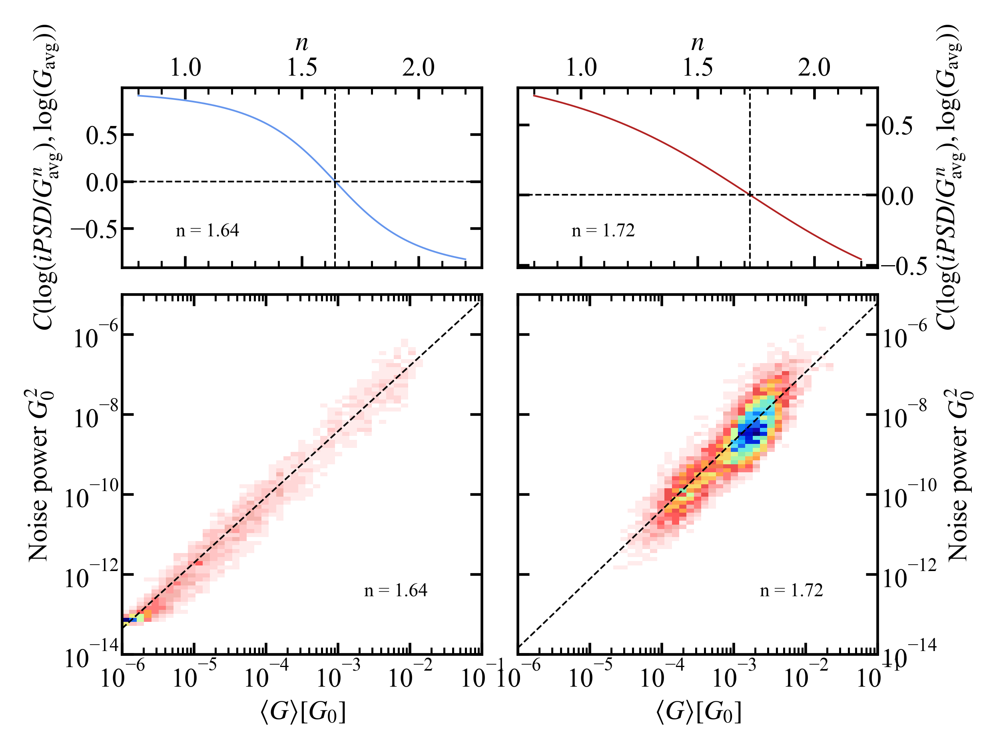

In [130]:
fig = plt.figure(figsize=utils.cm2inch(10, 7.5), dpi=600)  # figsize: (width, height) in inches
gs = gridspec.GridSpec(nrows=2, ncols=2, width_ratios=(1, 1), height_ratios=(1, 2),
                       figure=fig, left=0.15, right=0.95, top=0.9, bottom=0.1, wspace=0.1, hspace=0.1)

ax_corr_pull = fig.add_subplot(gs[0, 0])
ax_corr_push = fig.add_subplot(gs[0, 1])
ax_corrhist_pull = fig.add_subplot(gs[1, 0])
ax_corrhist_push = fig.add_subplot(gs[1, 1], sharey=ax_corrhist_pull)

ax_corr_pull.xaxis.tick_top()
ax_corr_pull.xaxis.set_label_position('top')
ax_corr_pull.xaxis.set_ticks_position('both')
ax_corr_pull.yaxis.set_ticks_position('both')

ax_corr_push.xaxis.tick_top()
ax_corr_push.xaxis.set_label_position('top')
ax_corr_push.yaxis.tick_right()
ax_corr_push.yaxis.set_label_position('right')
ax_corr_push.xaxis.set_ticks_position('both')
ax_corr_push.yaxis.set_ticks_position('both')

ax_corrhist_pull.xaxis.set_ticks_position('both')
ax_corrhist_pull.yaxis.set_ticks_position('both')

ax_corrhist_push.yaxis.tick_right()
ax_corrhist_push.yaxis.set_label_position('right')
ax_corrhist_push.xaxis.set_ticks_position('both')
ax_corrhist_push.yaxis.set_ticks_position('both')

plots.plot_correlation(n = N, correlation = pull_corr, lw=0.5, c='cornflowerblue', axis=ax_corr_pull)
plots.plot_correlation(n = N, correlation = push_corr, lw=0.5, c='firebrick', axis=ax_corr_push)

plots.plot_noise_power_2dhist(conductance_avgs=np.array(noise_stat_pull_2[f'avg_cond_on_step_{step}']),
                        noise_power=np.array(noise_stat_pull_2[f'noise_power_{step}']),
                        n = np.mean((N[pull_corr<0][0], N[pull_corr>0][-1])),
                        xrange=(1e-6, 0.1),
                        yrange=(1e-14, 1e-5),
                        num_bins=(10, 10),
                        shift=-3.5,
                        normalize=False,
                        cmap=utils.cmap_geo32, axis=ax_corrhist_pull)

plots.plot_noise_power_2dhist(conductance_avgs=np.array(noise_stat_push_2[f'avg_cond_on_step_{step}']),
                        noise_power=np.array(noise_stat_push_2[f'noise_power_{step}']),
                        n = np.mean((N[push_corr<0][0], N[push_corr>0][-1])),
                        xrange=(1e-6, 0.1),
                        yrange=(1e-14, 1e-5),
                        num_bins=(10, 10),
                        shift=-3.5,
                        normalize=False,
                        cmap=utils.cmap_geo32, axis=ax_corrhist_push)

ax_corrhist_pull.set_ylabel(r'Noise power $G_{0}^{2}$')
ax_corrhist_push.set_ylabel(r'Noise power $G_{0}^{2}$')

plt.savefig(home_folder.joinpath('results/noise_power_100_no_filter.png'), bbox_inches='tight')

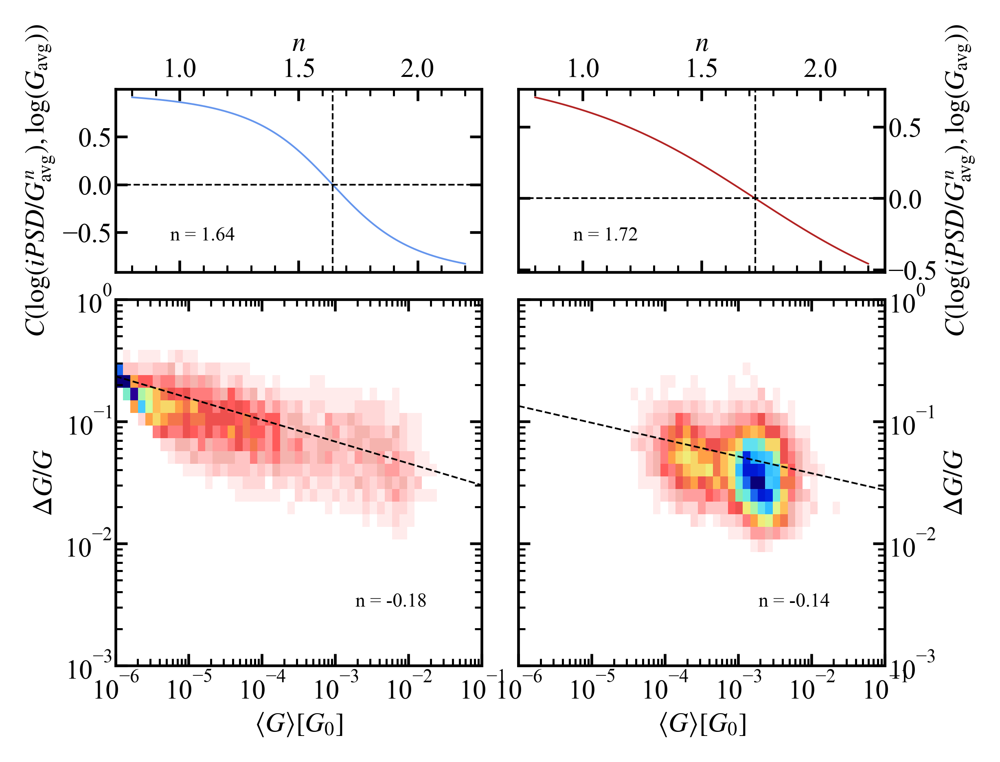

In [131]:
fig = plt.figure(figsize=utils.cm2inch(10, 7.5), dpi=600)  # figsize: (width, height) in inches
gs = gridspec.GridSpec(nrows=2, ncols=2, width_ratios=(1, 1), height_ratios=(1, 2),
                       figure=fig, left=0.15, right=0.95, top=0.9, bottom=0.1, wspace=0.1, hspace=0.1)

ax_corr_pull = fig.add_subplot(gs[0, 0])
ax_corr_push = fig.add_subplot(gs[0, 1])
ax_corrhist_pull = fig.add_subplot(gs[1, 0])
ax_corrhist_push = fig.add_subplot(gs[1, 1], sharey=ax_corrhist_pull)

ax_corr_pull.xaxis.tick_top()
ax_corr_pull.xaxis.set_label_position('top')
ax_corr_pull.xaxis.set_ticks_position('both')
ax_corr_pull.yaxis.set_ticks_position('both')

ax_corr_push.xaxis.tick_top()
ax_corr_push.xaxis.set_label_position('top')
ax_corr_push.yaxis.tick_right()
ax_corr_push.yaxis.set_label_position('right')
ax_corr_push.xaxis.set_ticks_position('both')
ax_corr_push.yaxis.set_ticks_position('both')

ax_corrhist_pull.xaxis.set_ticks_position('both')
ax_corrhist_pull.yaxis.set_ticks_position('both')

ax_corrhist_push.yaxis.tick_right()
ax_corrhist_push.yaxis.set_label_position('right')
ax_corrhist_push.xaxis.set_ticks_position('both')
ax_corrhist_push.yaxis.set_ticks_position('both')

plots.plot_correlation(n = N, correlation = pull_corr, lw=0.5, c='cornflowerblue', axis=ax_corr_pull)
plots.plot_correlation(n = N, correlation = push_corr, lw=0.5, c='firebrick', axis=ax_corr_push)

plots.plot_noise_power_2dhist(conductance_avgs=np.array(noise_stat_pull_2[f'avg_cond_on_step_{step}']),
                        noise_power=np.array(noise_stat_pull_2[f'conductance_noise_{step}']),
                        n = (np.mean((N[pull_corr<0][0], N[pull_corr>0][-1]))-2)/2,
                        xrange=(1e-6, 0.1),
                        yrange=(1e-3, 1),
                        num_bins=(10, 10),
                        shift=-1.7,
                        normalize=False,
                        cmap=utils.cmap_geo32, axis=ax_corrhist_pull)

plots.plot_noise_power_2dhist(conductance_avgs=np.array(noise_stat_push_2[f'avg_cond_on_step_{step}']),
                        noise_power=np.array(noise_stat_push_2[f'conductance_noise_{step}']),
                        n = (np.mean((N[push_corr<0][0], N[push_corr>0][-1]))-2)/2,
                        xrange=(1e-6, 0.1),
                        yrange=(1e-3, 1),
                        num_bins=(10, 10),
                        shift=-1.7,
                        normalize=False,
                        cmap=utils.cmap_geo32, axis=ax_corrhist_push)

ax_corrhist_pull.set_ylabel(r'$\Delta G/G$')
ax_corrhist_push.set_ylabel(r'$\Delta G/G$')

plt.savefig(home_folder.joinpath('results/conductance_noise_100_no_filter.png'), bbox_inches='tight')

# Filtered

In [260]:
noise_stat_filt_pull_1 = noise_stat_pre_filt_pull.where(np.log10(noise_stat_pre_filt_pull[f'avg_cond_on_step_1']/noise_stat_pre_filt_pull['avg_cond_on_step_4']) < np.log10(2)).dropna(how='any')
noise_stat_filt_push_1 = noise_stat_pre_filt_push.where(np.log10(noise_stat_pre_filt_push[f'avg_cond_on_step_1']/noise_stat_pre_filt_push['avg_cond_on_step_4']) < np.log10(2)).dropna(how='any')
noise_stat_filt_pull_2 = noise_stat_pre_filt_pull.where(np.log10(noise_stat_pre_filt_pull[f'avg_cond_on_step_2']/noise_stat_pre_filt_pull['avg_cond_on_step_4']) < np.log10(2)).dropna(how='any')
noise_stat_filt_push_2 = noise_stat_pre_filt_push.where(np.log10(noise_stat_pre_filt_push[f'avg_cond_on_step_2']/noise_stat_pre_filt_push['avg_cond_on_step_4']) < np.log10(2)).dropna(how='any')
noise_stat_filt_pull_3 = noise_stat_pre_filt_pull.where(np.log10(noise_stat_pre_filt_pull[f'avg_cond_on_step_3']/noise_stat_pre_filt_pull['avg_cond_on_step_4']) < np.log10(2)).dropna(how='any')
noise_stat_filt_push_3 = noise_stat_pre_filt_push.where(np.log10(noise_stat_pre_filt_push[f'avg_cond_on_step_3']/noise_stat_pre_filt_push['avg_cond_on_step_4']) < np.log10(2)).dropna(how='any')

ind_pull_1 = np.array(noise_stat_filt_pull_1['trace_index'])
ind_push_1 = np.array(noise_stat_filt_push_1['trace_index'])
ind_pull_2 = np.array(noise_stat_filt_pull_2['trace_index'])
ind_push_2 = np.array(noise_stat_filt_push_2['trace_index'])
ind_pull_3 = np.array(noise_stat_filt_pull_3['trace_index'])
ind_push_3 = np.array(noise_stat_filt_push_3['trace_index'])

In [261]:
ind_pull_1.shape

(2638,)

In [264]:
from functools import reduce
asd1 = reduce(np.intersect1d, (ind_pull_1, ind_pull_2, ind_pull_3))
asd2 = reduce(np.intersect1d, (ind_push_1, ind_push_2, ind_push_3))

In [266]:
len(np.intersect1d(asd1, asd2))

2225

38894


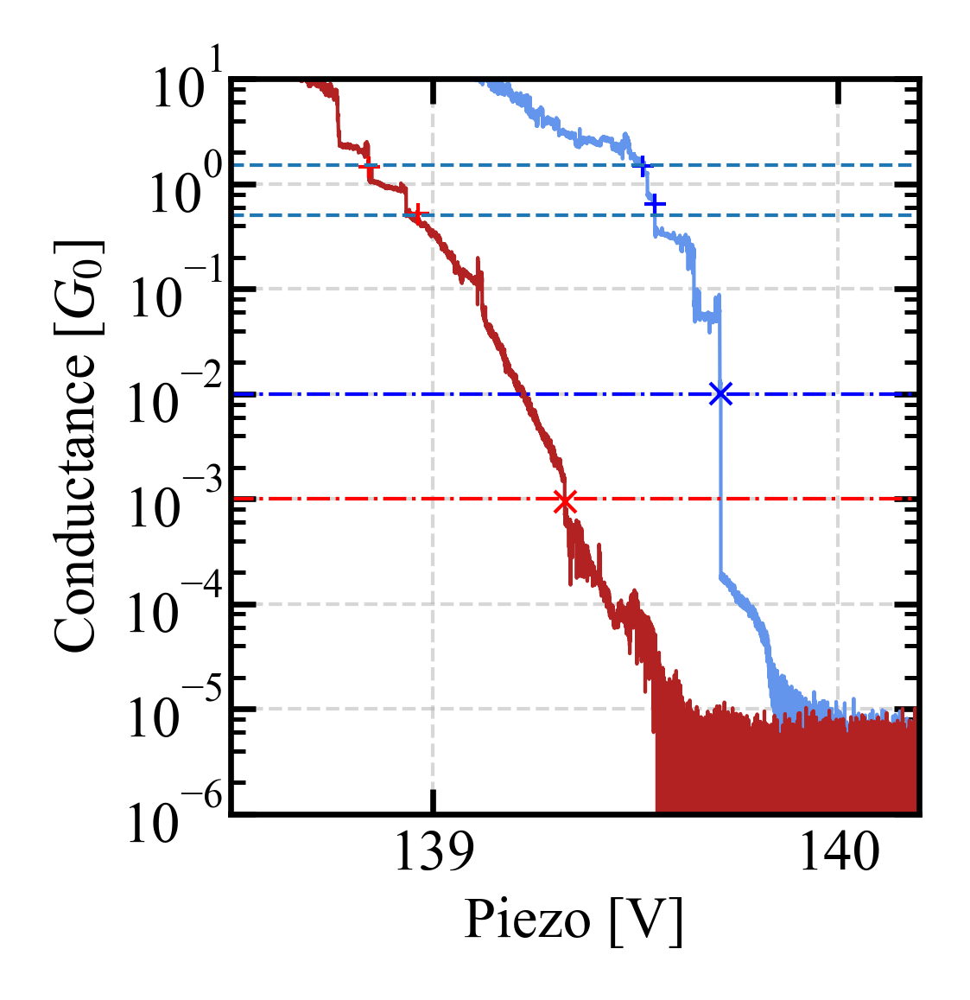

In [316]:
# for num in [8152, 8153, 8159, 8160, 8409, 11232, 13737, 15578, 16245, 16914, 17735, 19659]:

print(num)
fig = plt.figure(figsize=utils.cm2inch(4.5, 4.5), dpi=600)  # figsize: (width, height) in inches
gs = gridspec.GridSpec(nrows=1, ncols=1,
                       figure=fig, left=0.2, right=0.95, top=0.95, bottom=0.15, wspace=0, hspace=0)

ax = fig.add_subplot(gs[0])
ax.xaxis.set_ticks_position('both')
ax.yaxis.set_ticks_position('both')

trace_pair = TracePair(num, home_folder)
trace_pair.plot_trace_pair(ax=ax, xlim=(138.5, 140.2))

plt.savefig(home_folder.joinpath(f'results/trace_pair_{num}.png'), bbox_inches='tight')

bias_steps [0.1000061 0.2000122 0.2999878 0.1000061]
bias_steps [0.1000061 0.2000122 0.2999878 0.1000061]


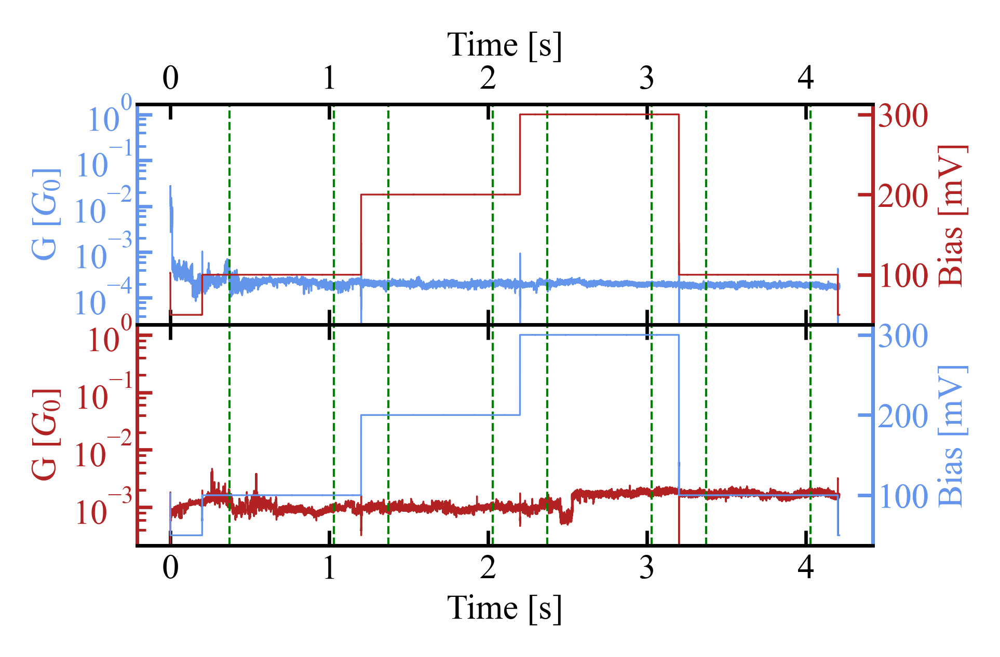

In [318]:
fig = plt.figure(figsize=utils.cm2inch(8, 4.5), dpi=600)  # figsize: (width, height) in inches
gs = gridspec.GridSpec(nrows=2, ncols=1,
                       figure=fig, left=0.2, right=0.95, top=0.95, bottom=0.15, wspace=0, hspace=0)

ax_pull = fig.add_subplot(gs[0])
ax_push = fig.add_subplot(gs[1])

ax_pull.xaxis.tick_top()
ax_pull.xaxis.set_label_position('top')
ax_pull.xaxis.set_ticks_position('both')
ax_push.xaxis.set_ticks_position('both')

hold_trace = HoldTrace(num, load_from=home_folder, min_step_len=None, bias_offset=0)
hold_trace.analyse_hold_trace(num_of_fft=1)

ax_pull = hold_trace.plot_hold_traces(plot_step_ranges=False, plot_psd_intervals=True, conductance=True, ax=ax_pull,
                            ax_colors=('cornflowerblue', 'firebrick'))
ax_push = hold_trace.plot_hold_traces(plot_step_ranges=False, plot_psd_intervals=True, conductance=True, ax=ax_push,
                            ax_colors=('cornflowerblue', 'firebrick'),
                            pull=False, push=True)

plt.savefig(home_folder.joinpath(f'results/hold_trace_{num}.png'), bbox_inches='tight')

In [43]:
conductance_stat_pull = pd.read_csv(home_folder.joinpath("results/conductance_stats_pull_2.csv"), skiprows=[1])
conductance_stat_push = pd.read_csv(home_folder.joinpath("results/conductance_stats_push_2.csv"), skiprows=[1])

conductance_stat_pull_above = conductance_stat_pull.where(conductance_stat_pull > 1e-5).dropna(how='any')
conductance_stat_push_above = conductance_stat_push.where(conductance_stat_push > 1e-5).dropna(how='any')

cond_filt_pull = conductance_stat_pull_above[:][
            abs(np.log10(conductance_stat_pull_above['G_end_4'] / conductance_stat_pull_above['G_beg_1'])) < np.log10(2)]

cond_filt_push = conductance_stat_push_above[:][
            abs(np.log10(conductance_stat_push_above['G_end_4'] / conductance_stat_push_above['G_beg_1'])) < np.log10(2)]

pull_traces = np.array(cond_filt_pull['trace_index'].astype(int))
push_traces = np.array(cond_filt_push['trace_index'].astype(int))

In [45]:
cond_filt_pull

,trace_index,G_set,G_stop,G_hold,G_avg,G_beg_1,G_beg_2,G_beg_3,G_beg_4,G_end_1,G_end_2,G_end_3,G_end_4
3,34504.0,0.01,0.008654,0.006193,0.001946,0.001426,0.002262,0.001463,0.002095,0.003315,0.001422,0.003515,0.001466
31,34532.0,0.01,0.010479,0.014665,0.003623,0.004623,0.002944,0.002101,0.003070,0.002517,0.001815,0.004027,0.003195
72,34573.0,0.01,0.000865,0.000596,0.000290,0.000356,0.000355,0.000266,0.000223,0.000331,0.000290,0.000207,0.000270
89,34590.0,0.01,0.007789,0.006957,0.000909,0.000753,0.001677,0.001263,0.000593,0.001489,0.001208,0.000680,0.000971
131,34632.0,0.01,0.005478,0.000422,0.000056,0.000050,0.000107,0.000123,0.000079,0.000098,0.000122,0.000090,0.000058
...,...,...,...,...,...,...,...,...,...,...,...,...,...
10412,44919.0,0.01,0.009557,0.010669,0.001707,0.002214,0.001476,0.001753,0.001790,0.001658,0.001825,0.001760,0.001812
10438,44945.0,0.01,0.003321,0.000505,0.000110,0.000236,0.000221,0.000145,0.000171,0.000231,0.000148,0.000174,0.000143
10450,44957.0,0.01,0.006913,0.007143,0.000719,0.000967,0.000870,0.000764,0.000873,0.000817,0.000819,0.000916,0.000671
10455,44962.0,0.01,0.002822,0.000637,0.000030,0.000054,0.000070,0.000106,0.000057,0.000066,0.000080,0.000066,0.000028


(658,)
40708
bias_steps [0.1000061 0.2000122 0.2999878 0.1000061]
bias_steps [0.1000061 0.2000122 0.2999878 0.1000061]


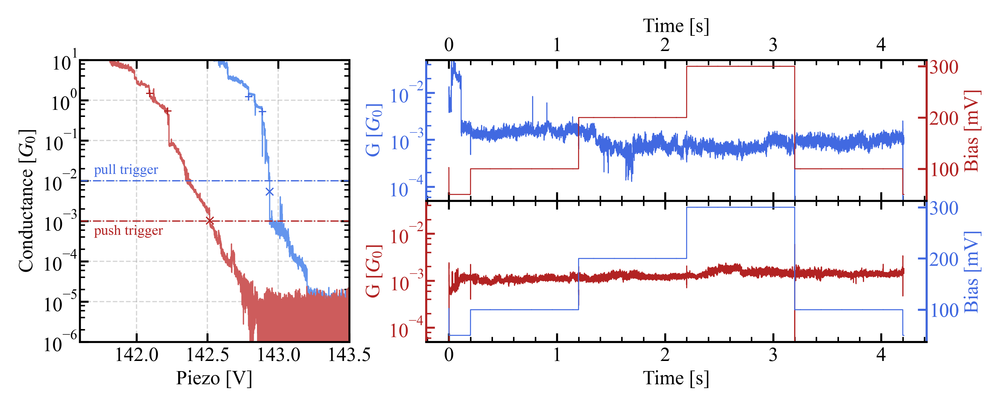

In [52]:
fig = plt.figure(figsize=utils.cm2inch(16, 5), dpi=600)  # figsize: (width, height) in inches
gs = gridspec.GridSpec(nrows=2, ncols=2, width_ratios=(0.35, 0.65), height_ratios=(1, 1),
                       figure=fig, left=0.2, right=0.95, top=0.95, bottom=0.15, wspace=0.2, hspace=0)

ax_trace = fig.add_subplot(gs[:, 0])
ax_pull = fig.add_subplot(gs[0, 1])
ax_push = fig.add_subplot(gs[1, 1])

ax_trace.xaxis.set_ticks_position('both')
ax_trace.yaxis.set_ticks_position('both')

ax_pull.xaxis.tick_top()
ax_pull.xaxis.set_label_position('top')
ax_pull.xaxis.set_ticks_position('both')
ax_push.xaxis.set_ticks_position('both')

print(np.intersect1d(pull_traces, push_traces, assume_unique=True).shape)
num = np.random.choice(np.intersect1d(pull_traces, push_traces, assume_unique=True))
# num = 40708
print(num)

trace_pair = TracePair(num, home_folder)
ax_trace = trace_pair.plot_trace_pair(ax=ax_trace, xlim=(141.6, 143.5),
                                      colors=('cornflowerblue', 'indianred'),
                                      accent_colors=('royalblue', 'firebrick'))

ax_trace.text(141.7, 1.5e-2, 'pull trigger', fontsize='xx-small', c='royalblue')
ax_trace.text(141.7, 8e-4, 'push trigger', fontsize='xx-small', c='firebrick', va='top')

hold_trace = HoldTrace(num, load_from=home_folder, min_step_len=None, bias_offset=0)
hold_trace.analyse_hold_trace(num_of_fft=1)

ax_pull = hold_trace.plot_hold_traces(plot_step_ranges=False, plot_psd_intervals=False, conductance=True, ax=ax_pull,
                            ax_colors=('royalblue', 'firebrick'))
ax_push = hold_trace.plot_hold_traces(plot_step_ranges=False, plot_psd_intervals=False, conductance=True, ax=ax_push,
                            ax_colors=('royalblue', 'firebrick'),
                            pull=False, push=True)

ax_pull.set_ylim(5e-5, 0.05)
ax_pull.xaxis.set_minor_locator(MultipleLocator(0.2))
ax_push.set_ylim(5e-5, 0.05)
ax_push.xaxis.set_minor_locator(MultipleLocator(0.2))

plt.savefig(home_folder.joinpath(f'results/measurement_scheme_{num}.png'), bbox_inches='tight')

In [12]:
ax_pull.get_xlim()[1]

4.420479000000001

In [313]:
step=1

noise_stat_pre_filt_pull = noise_stat_pull_2.where(noise_stat_pull_2[f'avg_cond_on_step_{step}'] > 1e-5).dropna(how='any')
noise_stat_pre_filt_push = noise_stat_push_2.where(noise_stat_push_2[f'avg_cond_on_step_{step}'] > 1e-5).dropna(how='any')
noise_stat_filt_pull = noise_stat_pre_filt_pull.where(np.log10(noise_stat_pre_filt_pull[f'avg_cond_on_step_{step}']/noise_stat_pre_filt_pull['avg_cond_on_step_4']) < np.log10(2)).dropna(how='any')
noise_stat_filt_push = noise_stat_pre_filt_push.where(np.log10(noise_stat_pre_filt_push[f'avg_cond_on_step_{step}']/noise_stat_pre_filt_push['avg_cond_on_step_4']) < np.log10(2)).dropna(how='any')

N = np.linspace(0.8, 2.2, num=1000)
pull_corr = np.zeros_like(N)
push_corr = np.zeros_like(N)
for i, n in enumerate(N):
    pull_corr[i] = utils.calc_correlation(np.log10(noise_stat_filt_pull[f'noise_power_{step}']/ \
                                                   noise_stat_filt_pull[f'avg_cond_on_step_{step}']**n),
                                          np.log10(noise_stat_filt_pull[f'avg_cond_on_step_{step}']))
    push_corr[i] = utils.calc_correlation(np.log10(noise_stat_filt_push[f'noise_power_{step}']/ \
                                                   noise_stat_filt_push[f'avg_cond_on_step_{step}']**n),
                                          np.log10(noise_stat_filt_push[f'avg_cond_on_step_{step}']))

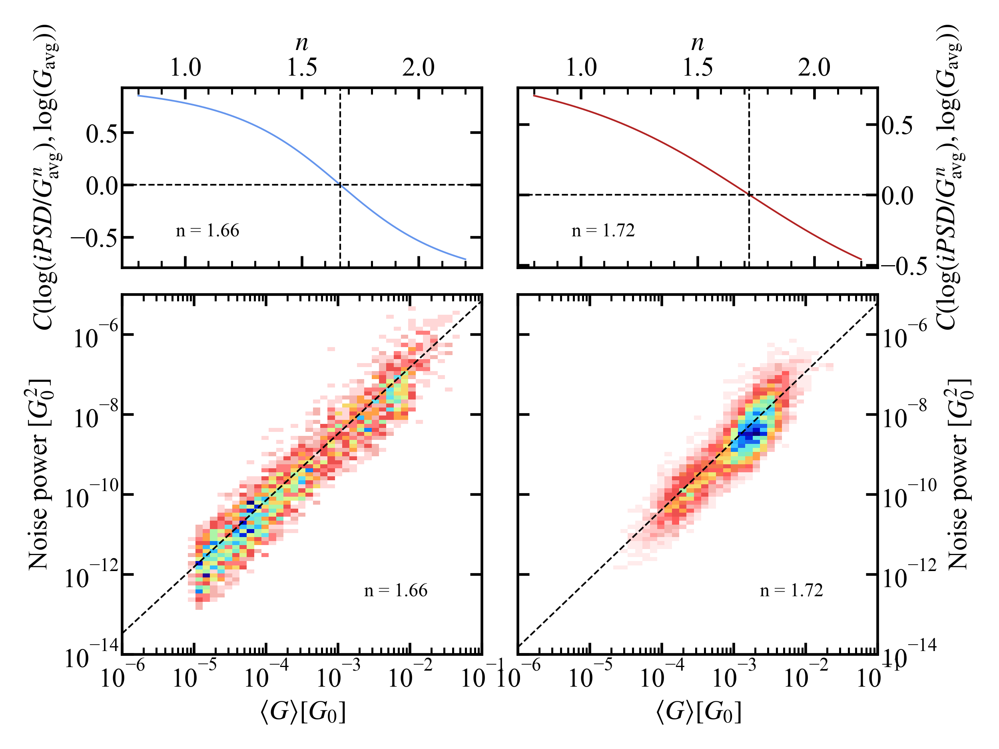

In [314]:
fig = plt.figure(figsize=utils.cm2inch(10, 7.5), dpi=600)  # figsize: (width, height) in inches
gs = gridspec.GridSpec(nrows=2, ncols=2, width_ratios=(1, 1), height_ratios=(1, 2),
                       figure=fig, left=0.15, right=0.95, top=0.9, bottom=0.1, wspace=0.1, hspace=0.1)

ax_corr_pull = fig.add_subplot(gs[0, 0])
ax_corr_push = fig.add_subplot(gs[0, 1])
ax_corrhist_pull = fig.add_subplot(gs[1, 0])
ax_corrhist_push = fig.add_subplot(gs[1, 1], sharey=ax_corrhist_pull)

ax_corr_pull.xaxis.tick_top()
ax_corr_pull.xaxis.set_label_position('top')
ax_corr_pull.xaxis.set_ticks_position('both')
ax_corr_pull.yaxis.set_ticks_position('both')

ax_corr_push.xaxis.tick_top()
ax_corr_push.xaxis.set_label_position('top')
ax_corr_push.yaxis.tick_right()
ax_corr_push.yaxis.set_label_position('right')
ax_corr_push.xaxis.set_ticks_position('both')
ax_corr_push.yaxis.set_ticks_position('both')

ax_corrhist_pull.xaxis.set_ticks_position('both')
ax_corrhist_pull.yaxis.set_ticks_position('both')

ax_corrhist_push.yaxis.tick_right()
ax_corrhist_push.yaxis.set_label_position('right')
ax_corrhist_push.xaxis.set_ticks_position('both')
ax_corrhist_push.yaxis.set_ticks_position('both')

ax_corr_pull, n_pull = plots.plot_correlation(n = N, correlation = pull_corr, lw=0.5, c='cornflowerblue', axis=ax_corr_pull)
ax_corr_push, n_push = plots.plot_correlation(n = N, correlation = push_corr, lw=0.5, c='firebrick', axis=ax_corr_push)

plots.plot_noise_power_2dhist(conductance_avgs=np.array(noise_stat_filt_pull[f'avg_cond_on_step_{step}']),
                        noise_power=np.array(noise_stat_filt_pull[f'noise_power_{step}']),
                        n = np.mean((N[pull_corr<0][0], N[pull_corr>0][-1])),
                        xrange=(1e-6, 0.1),
                        yrange=(1e-14, 1e-5),
                        num_bins=(10, 10),
                        shift=-3.5,
                        normalize=False,
                        cmap=utils.cmap_geo32, axis=ax_corrhist_pull)

plots.plot_noise_power_2dhist(conductance_avgs=np.array(noise_stat_filt_push[f'avg_cond_on_step_{step}']),
                        noise_power=np.array(noise_stat_filt_push[f'noise_power_{step}']),
                        n = np.mean((N[push_corr<0][0], N[push_corr>0][-1])),
                        xrange=(1e-6, 0.1),
                        yrange=(1e-14, 1e-5),
                        num_bins=(10, 10),
                        shift=-3.5,
                        normalize=False,
                        cmap=utils.cmap_geo32, axis=ax_corrhist_push)

ax_corrhist_pull.set_ylabel(r'Noise power [$G_{0}^{2}]$')
ax_corrhist_push.set_ylabel(r'Noise power [$G_{0}^{2}$]')

plt.savefig(home_folder.joinpath(f'results/noise_power_{step}00_FILTERED.png'), bbox_inches='tight')

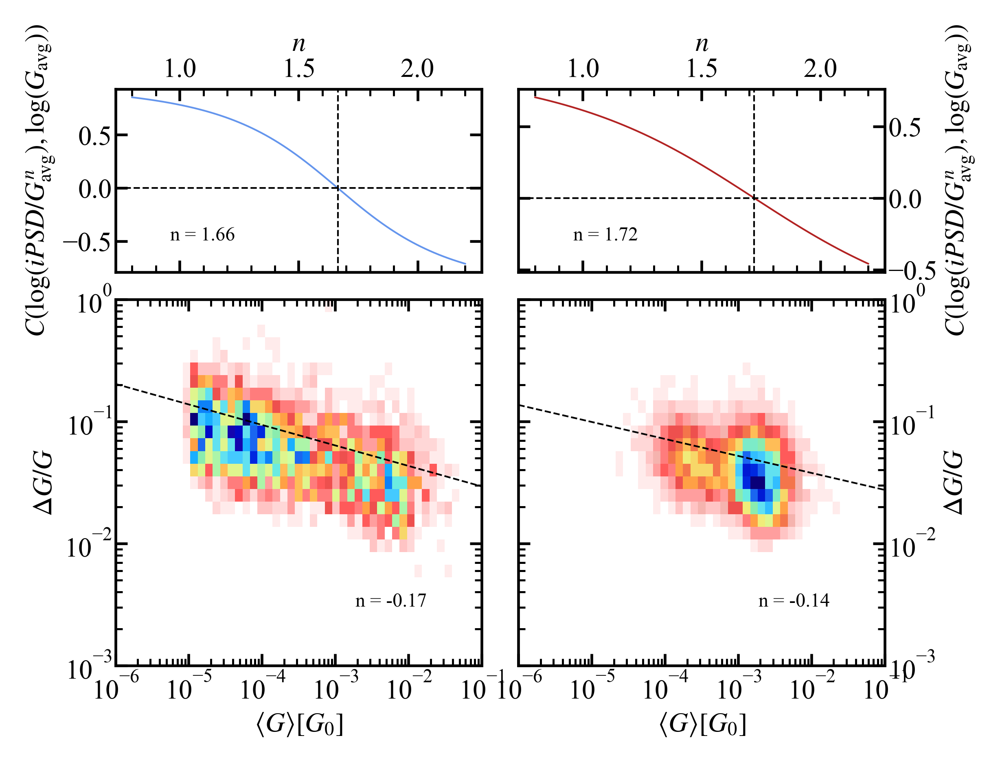

In [315]:
fig = plt.figure(figsize=utils.cm2inch(10, 7.5), dpi=600)  # figsize: (width, height) in inches
gs = gridspec.GridSpec(nrows=2, ncols=2, width_ratios=(1, 1), height_ratios=(1, 2),
                       figure=fig, left=0.15, right=0.95, top=0.9, bottom=0.1, wspace=0.1, hspace=0.1)

ax_corr_pull = fig.add_subplot(gs[0, 0])
ax_corr_push = fig.add_subplot(gs[0, 1])
ax_corrhist_pull = fig.add_subplot(gs[1, 0])
ax_corrhist_push = fig.add_subplot(gs[1, 1], sharey=ax_corrhist_pull)

ax_corr_pull.xaxis.tick_top()
ax_corr_pull.xaxis.set_label_position('top')
ax_corr_pull.xaxis.set_ticks_position('both')
ax_corr_pull.yaxis.set_ticks_position('both')

ax_corr_push.xaxis.tick_top()
ax_corr_push.xaxis.set_label_position('top')
ax_corr_push.yaxis.tick_right()
ax_corr_push.yaxis.set_label_position('right')
ax_corr_push.xaxis.set_ticks_position('both')
ax_corr_push.yaxis.set_ticks_position('both')

ax_corrhist_pull.xaxis.set_ticks_position('both')
ax_corrhist_pull.yaxis.set_ticks_position('both')

ax_corrhist_push.yaxis.tick_right()
ax_corrhist_push.yaxis.set_label_position('right')
ax_corrhist_push.xaxis.set_ticks_position('both')
ax_corrhist_push.yaxis.set_ticks_position('both')

ax_corr_pull, n_pull = plots.plot_correlation(n = N, correlation = pull_corr, lw=0.5, c='cornflowerblue', axis=ax_corr_pull)
ax_corr_push, n_push = plots.plot_correlation(n = N, correlation = push_corr, lw=0.5, c='firebrick', axis=ax_corr_push)

plots.plot_noise_power_2dhist(conductance_avgs=np.array(noise_stat_filt_pull[f'avg_cond_on_step_{step}']),
                        noise_power=np.array(noise_stat_filt_pull[f'conductance_noise_{step}']),
                        n = (np.mean((N[pull_corr<0][0], N[pull_corr>0][-1]))-2)/2,
                        xrange=(1e-6, 0.1),
                        yrange=(1e-3, 1),
                        num_bins=(10, 10),
                        shift=-1.7,
                        normalize=False,
                        cmap=utils.cmap_geo32, axis=ax_corrhist_pull)

plots.plot_noise_power_2dhist(conductance_avgs=np.array(noise_stat_filt_push[f'avg_cond_on_step_{step}']),
                        noise_power=np.array(noise_stat_filt_push[f'conductance_noise_{step}']),
                        n = (np.mean((N[push_corr<0][0], N[push_corr>0][-1]))-2)/2,
                        xrange=(1e-6, 0.1),
                        yrange=(1e-3, 1),
                        num_bins=(10, 10),
                        shift=-1.7,
                        normalize=False,
                        cmap=utils.cmap_geo32, axis=ax_corrhist_push)

ax_corrhist_pull.set_ylabel(r'$\Delta G/G$')
ax_corrhist_push.set_ylabel(r'$\Delta G/G$')

plt.savefig(home_folder.joinpath(f'results/conductance_noise_{step}00_FILTERED.png'), bbox_inches='tight')

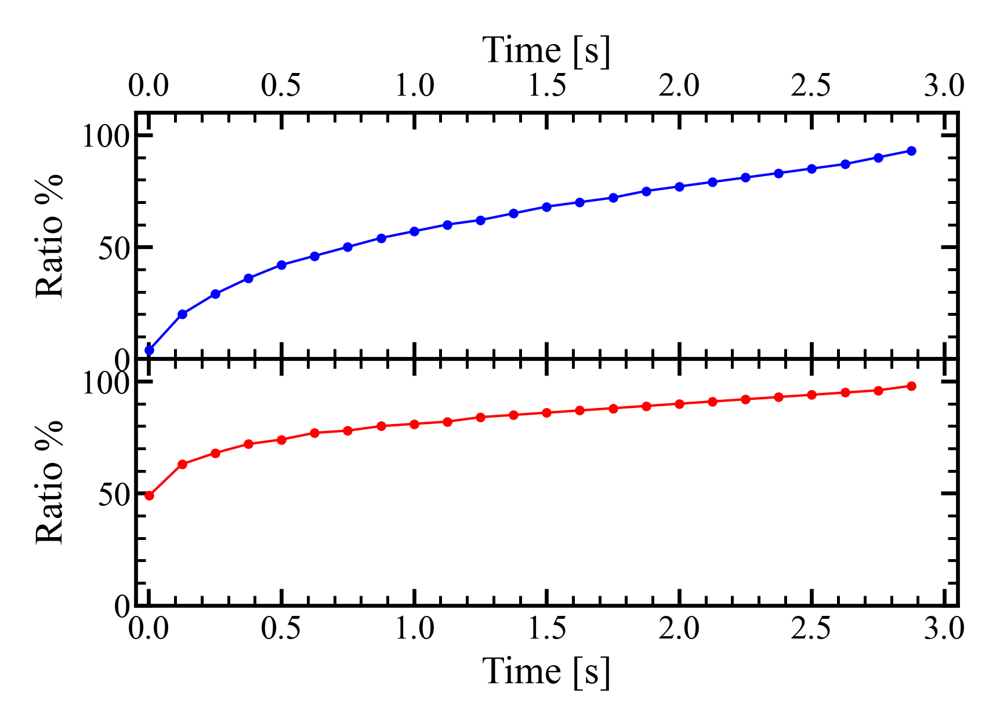

In [285]:
fig = plt.figure(figsize=utils.cm2inch(8, 4.5), dpi=600)  # figsize: (width, height) in inches
gs = gridspec.GridSpec(nrows=2, ncols=1,
                       figure=fig, left=0.2, right=0.95, top=0.95, bottom=0.15, wspace=0, hspace=0)

ax_pull = fig.add_subplot(gs[0])
ax_push = fig.add_subplot(gs[1])

ax_pull.plot(np.mean(hold_trace.test_intervals_pull, axis=1)[:-1]/50_000, ratios_pull, c='b',
             marker='o', markeredgecolor='None', markersize=2, lw=0.5)
ax_push.plot(np.mean(hold_trace.test_intervals_push, axis=1)[:-1]/50_000, ratios_push, c='r',
             marker='o', markeredgecolor='None', markersize=2, lw=0.5)

ax_pull.set_xlim(-0.05, 3.05)
ax_push.set_xlim(-0.05, 3.05)
ax_pull.set_ylim(0, 110)
ax_push.set_ylim(0, 110)

ax_pull.xaxis.tick_top()
ax_pull.xaxis.set_label_position('top')
ax_pull.xaxis.set_ticks_position('both')
ax_pull.yaxis.set_ticks_position('both')
ax_push.xaxis.set_ticks_position('both')
ax_push.yaxis.set_ticks_position('both')

ax_pull.xaxis.set_minor_locator(MultipleLocator(0.1))
ax_push.xaxis.set_minor_locator(MultipleLocator(0.1))

ax_pull.yaxis.set_minor_locator(MultipleLocator(10))
ax_push.yaxis.set_minor_locator(MultipleLocator(10))

ax_pull.set_xlabel('Time [s]')
ax_push.set_xlabel('Time [s]')
ax_pull.set_ylabel('Ratio %')
ax_push.set_ylabel('Ratio %')
plt.savefig(home_folder.joinpath('results/ratios.png'), bbox_inches='tight')

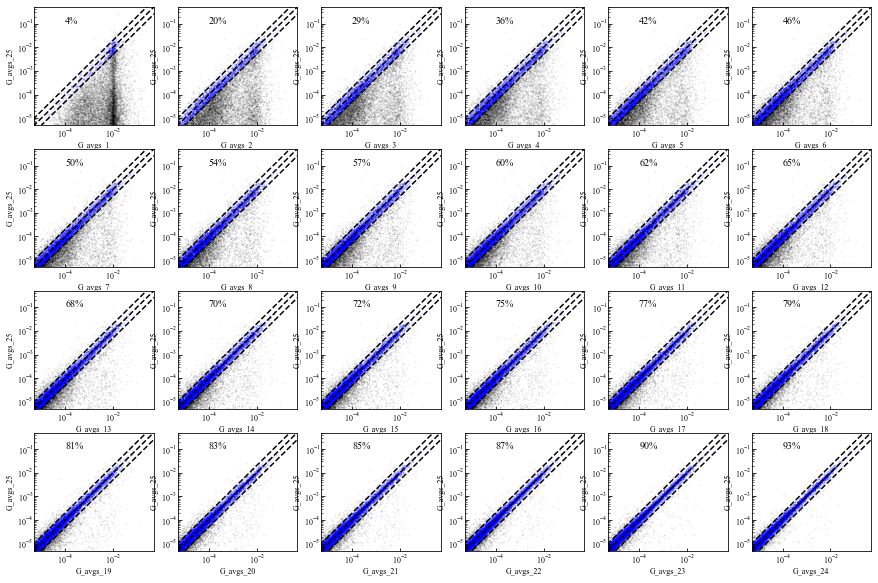

In [210]:
fig, ax = plt.subplots(nrows=4, ncols=6, figsize=(15, 10))

which_cols = np.array(list(conductance_stat_pull.columns[-25:-1])).reshape(4, 6)

for i, row in enumerate(which_cols):
    for j, col in enumerate(row):
        indices = np.array(conductance_stat_pull_above[:][
            abs(np.log10(conductance_stat_pull_above['G_avgs_25'] / conductance_stat_pull_above[col])) < np.log10(2)].index)
        not_indices = conductance_stat_pull_above.index.difference(indices)
        
        ax[i, j].text(1e-4, 1e-1, s=str(round(len(indices)/conductance_stat_pull_above['trace_index'].count()*100))+'%')
        ax[i, j].scatter(conductance_stat_pull_above[col][indices], conductance_stat_pull_above['G_avgs_25'][indices],
                         alpha=0.2, c='b', edgecolor='None', s=2)
        ax[i, j].scatter(conductance_stat_pull_above[col][not_indices], conductance_stat_pull_above['G_avgs_25'][not_indices],
                         alpha=0.1, c='k', edgecolor='None', s=2)
        ax[i, j].set_xscale('log')
        ax[i, j].set_yscale('log')
        ax[i, j].set_xlim(5e-6, 0.5)
        ax[i, j].set_ylim(5e-6, 0.5)
        ax[i, j].set_ylabel('G_avgs_25')
        ax[i, j].set_xlabel(col)
        ax[i, j].plot(np.logspace(-7, 0, num=10, base=10), np.logspace(-7, 0, num=10, base=10), c='k', ls='--')
        ax[i, j].plot(np.logspace(-7, 0, num=10, base=10), 2*np.logspace(-7, 0, num=10, base=10), c='k', ls='--')
        ax[i, j].plot(2*np.logspace(-7, 0, num=10, base=10), np.logspace(-7, 0, num=10, base=10), c='k', ls='--')

plt.savefig(home_folder.joinpath('results/pull_relax.png'))

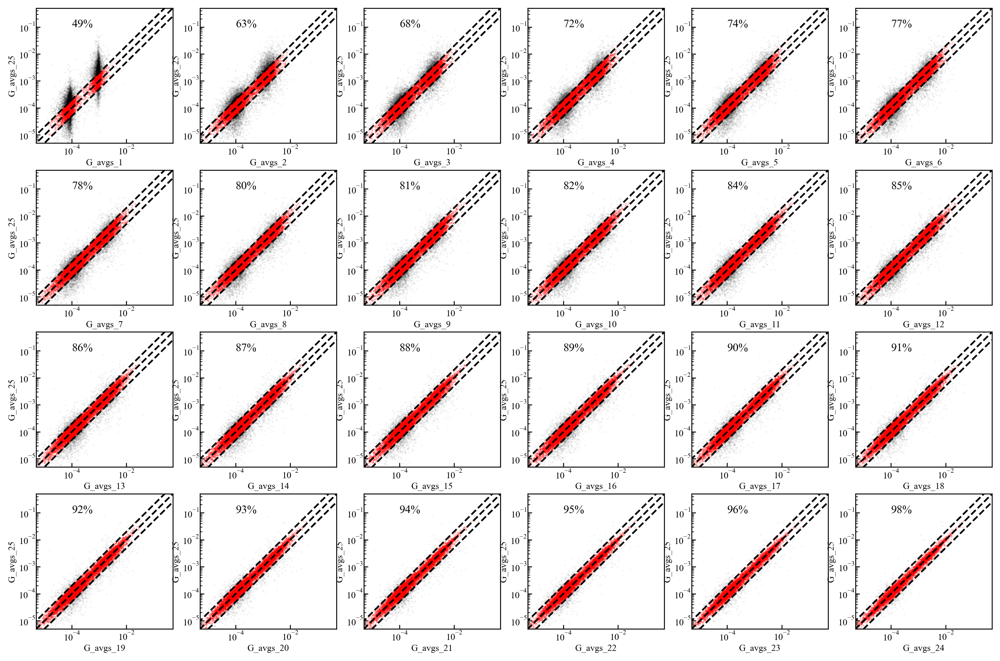

In [139]:
fig, ax = plt.subplots(nrows=4, ncols=6, figsize=(15, 10), dpi=300)

which_cols = np.array(list(conductance_stat_push.columns[-25:-1])).reshape(4, 6)

for i, row in enumerate(which_cols):
    for j, col in enumerate(row):
        indices = np.array(conductance_stat_push_above[:][
            abs(np.log10(conductance_stat_push_above['G_avgs_25'] / conductance_stat_push_above[col])) < np.log10(2)].index)
        not_indices = conductance_stat_push_above.index.difference(indices)
        
        ax[i, j].text(1e-4, 1e-1, s=str(round(len(indices)/conductance_stat_push_above['trace_index'].count()*100))+'%')
        ax[i, j].scatter(conductance_stat_push_above[col][indices], conductance_stat_push_above['G_avgs_25'][indices],
                         alpha=0.2, c='r', edgecolor='None', s=2)
        ax[i, j].scatter(conductance_stat_push_above[col][not_indices], conductance_stat_push_above['G_avgs_25'][not_indices],
                         alpha=0.05, c='k', edgecolor='None', s=2)
        ax[i, j].set_xscale('log')
        ax[i, j].set_yscale('log')
        ax[i, j].set_xlim(5e-6, 0.5)
        ax[i, j].set_ylim(5e-6, 0.5)
        ax[i, j].set_ylabel('G_avgs_25')
        ax[i, j].set_xlabel(col)
        ax[i, j].plot(np.logspace(-7, 0, num=10, base=10), np.logspace(-7, 0, num=10, base=10), c='k', ls='--')
        ax[i, j].plot(np.logspace(-7, 0, num=10, base=10), 2*np.logspace(-7, 0, num=10, base=10), c='k', ls='--')
        ax[i, j].plot(2*np.logspace(-7, 0, num=10, base=10), np.logspace(-7, 0, num=10, base=10), c='k', ls='--')

plt.savefig(home_folder.joinpath('results/push_relax.png'))

In [44]:
conductance_filt_pull = conductance_stat_pull[:][abs(np.log10(conductance_stat_pull['G_avgs_6'] / conductance_stat_pull['G_avgs_2'])) < np.log10(2)]
conductance_filt_push = conductance_stat_push[:][abs(np.log10(conductance_stat_push['G_avgs_6'] / conductance_stat_push['G_avgs_2'])) < np.log10(2)]

D:\Greta\mcbj_stm-bj\venv\lib\site-packages\pandas\core\arraylike.py:364: RuntimeWarning: invalid value encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)


In [45]:
conductance_filt_pull.head()

,trace_index,G_set,G_stop,G_hold,G_avg,G_avgs_1,G_avgs_2,G_avgs_3,G_avgs_4,G_avgs_5,G_avgs_6
8,8009.0,0.01,0.006580,0.006285,2.320141e-05,0.006285,3.747891e-05,1.215933e-05,1.575558e-05,2.287552e-05,2.316449e-05
11,8012.0,0.01,0.009886,0.010115,3.262185e-03,0.010115,2.227283e-03,2.341074e-03,2.152685e-03,3.151634e-03,3.261620e-03
12,8013.0,0.01,0.006355,0.000033,1.762339e-07,0.000033,2.166320e-07,-9.086686e-08,6.122094e-08,3.857486e-07,1.663931e-07
13,8014.0,0.01,0.010291,0.011572,5.777131e-04,0.011572,1.033955e-03,6.388552e-04,5.909514e-04,5.042219e-04,5.684289e-04
14,8015.0,0.01,0.002345,0.000020,1.055706e-06,0.000020,1.221039e-06,1.281055e-06,1.218799e-06,8.490154e-07,8.797880e-07


In [46]:
conductance_filt_push.head()

,trace_index,G_set,G_stop,G_hold,G_avg,G_avgs_1,G_avgs_2,G_avgs_3,G_avgs_4,G_avgs_5,G_avgs_6
0,8001.0,0.001,0.001043,0.000874,0.001241,0.000874,0.000757,0.000453,0.000621,0.001431,0.001240
1,8002.0,0.001,0.001033,0.000775,0.001558,0.000775,0.001210,0.001485,0.001574,0.001680,0.001556
4,8005.0,0.001,0.000844,0.001347,0.001294,0.001347,0.002292,0.002429,0.001292,0.001162,0.001295
6,8007.0,0.001,0.001005,0.000969,0.001571,0.000969,0.001226,0.001068,0.000952,0.001505,0.001568
7,8008.0,0.001,0.000999,0.000827,0.002021,0.000827,0.001586,0.001703,0.001660,0.001491,0.002022


In [47]:
filt_inds_pull = np.array(conductance_filt_pull.index)
filt_inds_push = np.array(conductance_filt_push.index)

In [48]:
print('Pull')
print('Number of all traces: ', conductance_stat_pull.count()['trace_index'])
print('Number of filtered traces: ', conductance_filt_pull.count()['trace_index'])
print('Yield: ', conductance_filt_pull.count()['trace_index']/conductance_stat_pull.count()['trace_index']*100, '%')
print('\n')
print('Push')
print('Number of all traces: ', conductance_stat_push.count()['trace_index'])
print('Number of filtered traces: ', conductance_filt_push.count()['trace_index'])
print('Yield: ', conductance_filt_push.count()['trace_index']/conductance_stat_push.count()['trace_index']*100, '%')

Pull
Number of all traces:  15000
Number of filtered traces:  6782
Yield:  45.21333333333333 %


Push
Number of all traces:  15000
Number of filtered traces:  11390
Yield:  75.93333333333334 %


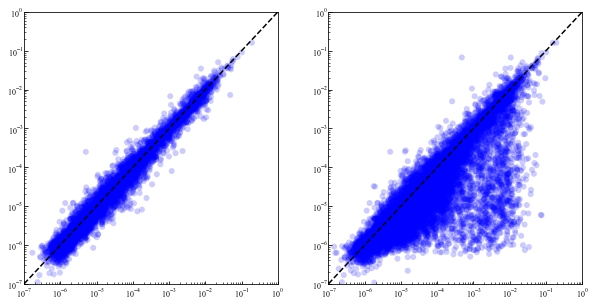

In [38]:
which = ('G_avgs_2', 'G_avgs_4')

fig, ax = plt.subplots(nrows=1, ncols=2, figsize=(10,5))

ax[0].scatter(conductance_filt_pull[which[0]], conductance_filt_pull[which[1]], alpha=0.2, c='b', edgecolor='None')
ax[0].set_xscale('log')
ax[0].set_yscale('log')
ax[0].set_xlim(1e-7, 1)
ax[0].set_ylim(1e-7, 1)
ax[0].plot(np.logspace(-7, 0, num=10, base=10), np.logspace(-7, 0, num=10, base=10), c='k', ls='--')

ax[1].scatter(conductance_stat_pull[which[0]], conductance_stat_pull[which[1]], alpha=0.2, c='b', edgecolor='None')
ax[1].set_xscale('log')
ax[1].set_yscale('log')
ax[1].set_xlim(1e-7, 1)
ax[1].set_ylim(1e-7, 1)
ax[1].plot(np.logspace(-7, 0, num=10, base=10), np.logspace(-7, 0, num=10, base=10), c='k', ls='--')

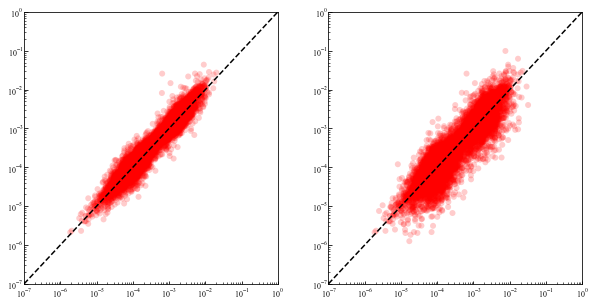

In [20]:
which = ('G_avgs_2', 'G_avgs_5')

fig, ax = plt.subplots(nrows=1, ncols=2, figsize=(10,5))

ax[0].scatter(conductance_filt_push[which[0]], conductance_filt_push[which[1]], alpha=0.2, c='r', edgecolor='None')
ax[0].set_xscale('log')
ax[0].set_yscale('log')
ax[0].set_xlim(1e-7, 1)
ax[0].set_ylim(1e-7, 1)
ax[0].plot(np.logspace(-7, 0, num=10, base=10), np.logspace(-7, 0, num=10, base=10), c='k', ls='--')

ax[1].scatter(conductance_stat_push[which[0]], conductance_stat_push[which[1]], alpha=0.2, c='r', edgecolor='None')
ax[1].set_xscale('log')
ax[1].set_yscale('log')
ax[1].set_xlim(1e-7, 1)
ax[1].set_ylim(1e-7, 1)
ax[1].plot(np.logspace(-7, 0, num=10, base=10), np.logspace(-7, 0, num=10, base=10), c='k', ls='--')

In [21]:
noise_stat_pull = pd.read_csv(home_folder.joinpath("results/noise_stats_pull_1.csv"), skiprows=[1])
noise_stat_push = pd.read_csv(home_folder.joinpath("results/noise_stats_push_1.csv"), skiprows=[1])

In [22]:
noise_stat_pull.head()

,trace_index,avg_cond_on_step_1,avg_current_on_step_1,noise_power_1,conductance_noise_1,current_noise_1
0,8001,3.038528e-05,2.346895e-10,6.708822e-12,0.085243,0.085559
1,8002,3.127524e-07,2.423228e-12,6.634742e-14,0.823590,0.824052
2,8003,1.203724e-06,9.329865e-12,1.756422e-13,0.348167,0.348238
3,8004,6.810547e-06,5.279376e-11,3.461247e-13,0.086384,0.086391
4,8005,4.604476e-03,3.332709e-08,1.802675e-07,0.092210,0.098764


In [23]:
noise_stat_pull['noise_power_1'][filt_inds_pull]

8        3.511916e-12
11       1.871331e-08
12       6.592575e-14
13       7.198395e-09
14       7.371140e-14
             ...     
14990    3.045340e-13
14992    1.363982e-13
14994    3.412742e-10
14995    5.200918e-13
14999    6.263386e-14
Name: noise_power_1, Length: 6782, dtype: float64

## No filter

In [32]:
N = np.linspace(0.8, 2.2, num=1000)
pull_corr = np.zeros_like(N)
push_corr = np.zeros_like(N)
for i, n in enumerate(N):
    pull_corr[i] = utils.calc_correlation(np.log10(noise_stat_pull['noise_power_1']/ \
                                                   noise_stat_pull['avg_cond_on_step_1']**n),
                                          np.log10(noise_stat_pull['avg_cond_on_step_1']))
    push_corr[i] = utils.calc_correlation(np.log10(noise_stat_push['noise_power_1']/ \
                                                   noise_stat_push['avg_cond_on_step_1']**n),
                                          np.log10(noise_stat_push['avg_cond_on_step_1']))

<AxesSubplot:xlabel='$\\langle G \\rangle [G_0]$'>

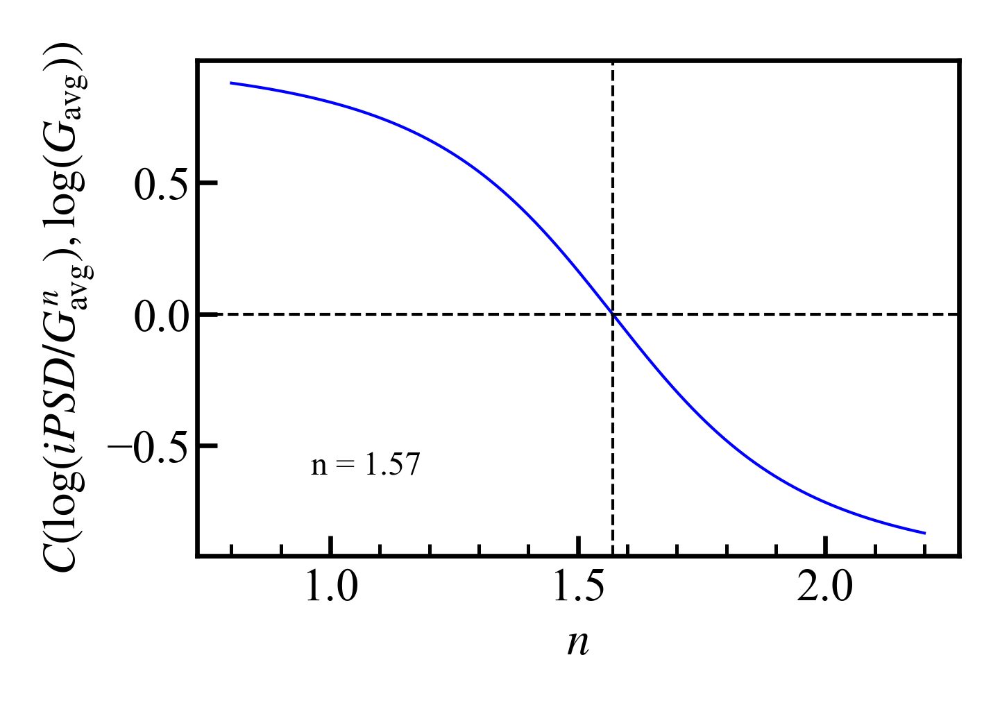

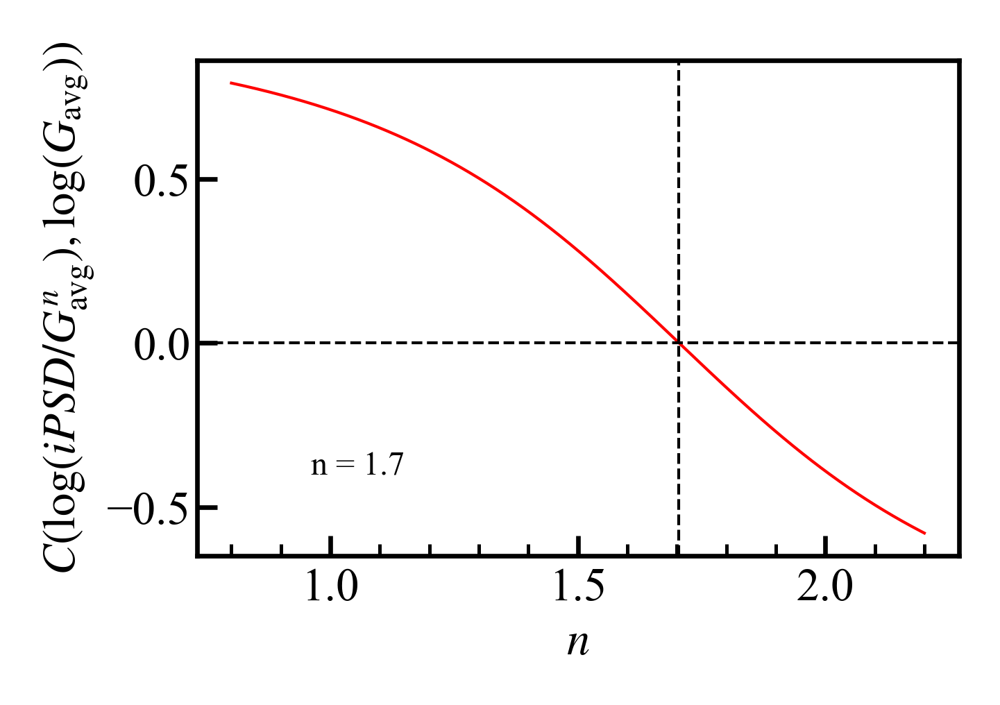

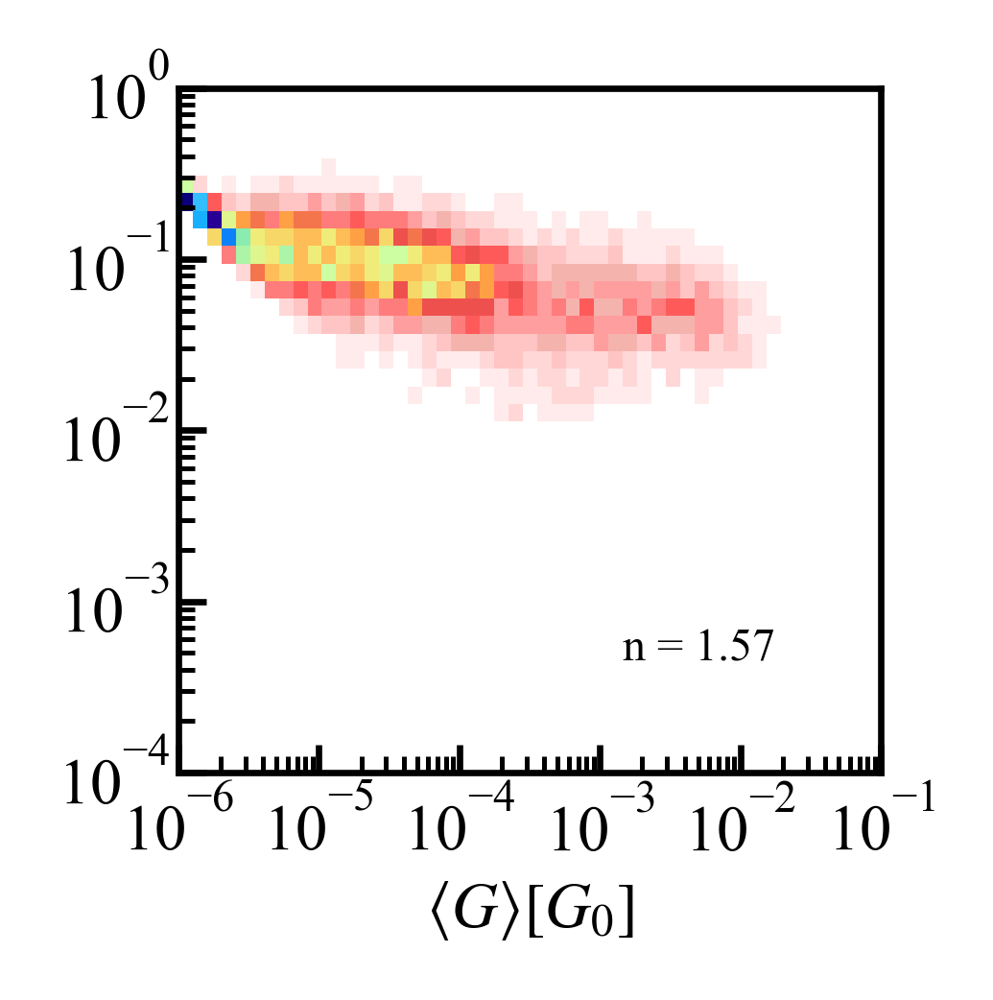

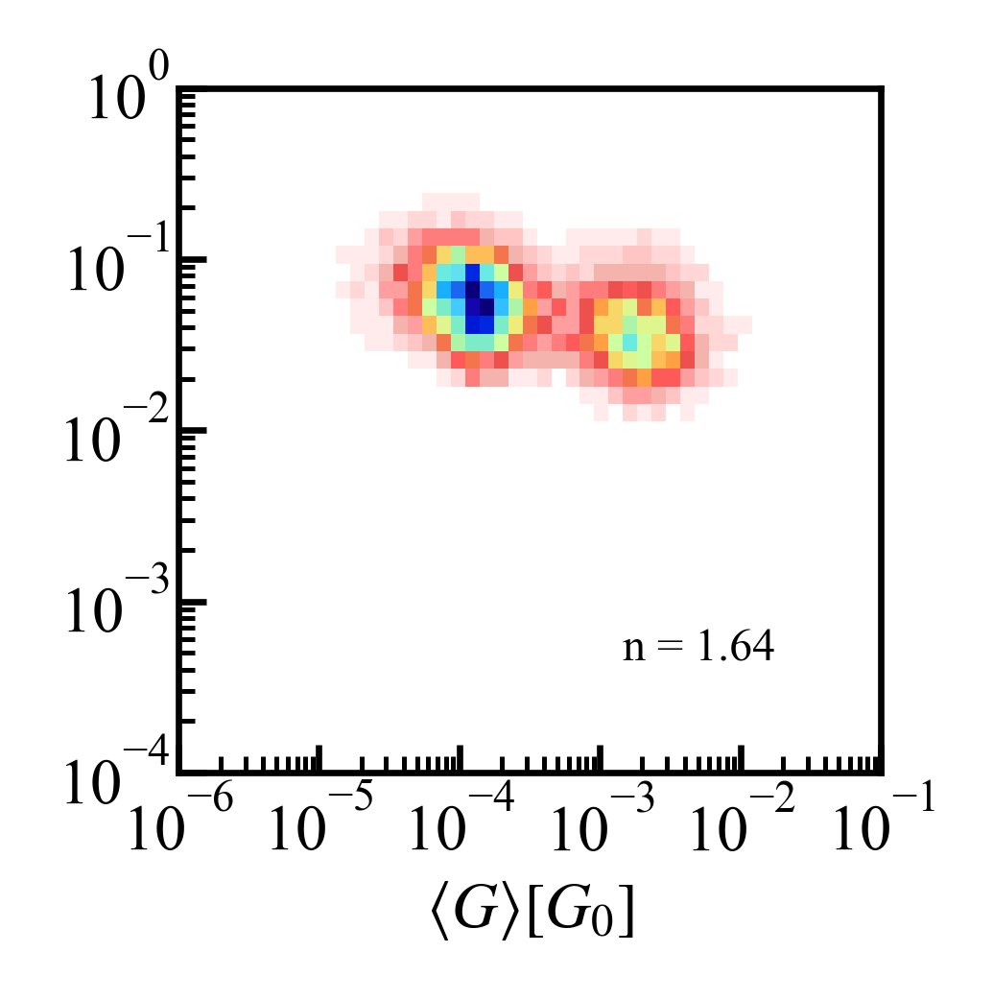

In [51]:
fig = plt.figure(figsize=utils.cm2inch(10, 7.5), dpi=600)  # figsize: (width, height) in inches
gs = gridspec.GridSpec(nrows=2, ncols=2, width_ratios=(1, 1), height_ratios=(1, 2),
                       figure=fig, left=0.15, right=0.95, top=0.9, bottom=0.1, wspace=0.1, hspace=0.1)

ax_corr_pull = fig.add_subplot(gs[0, 0])
ax_corr_push = fig.add_subplot(gs[0, 1])
ax_corrhist_pull = fig.add_subplot(gs[1, 0])
ax_corrhist_push = fig.add_subplot(gs[1, 1], sharey=ax_corrhist_pull)

ax_corr_pull.xaxis.tick_top()
ax_corr_pull.xaxis.set_label_position('top')
ax_corr_pull.xaxis.set_ticks_position('both')
ax_corr_pull.yaxis.set_ticks_position('both')

ax_corr_push.xaxis.tick_top()
ax_corr_push.xaxis.set_label_position('top')
ax_corr_push.yaxis.tick_right()
ax_corr_push.yaxis.set_label_position('right')
ax_corr_push.xaxis.set_ticks_position('both')
ax_corr_push.yaxis.set_ticks_position('both')

ax_corrhist_pull.xaxis.set_ticks_position('both')
ax_corrhist_pull.yaxis.set_ticks_position('both')

ax_corrhist_push.yaxis.tick_right()
ax_corrhist_push.yaxis.set_label_position('right')
ax_corrhist_push.xaxis.set_ticks_position('both')
ax_corrhist_push.yaxis.set_ticks_position('both')

ax_corr_pull, n_pull = plots.plot_correlation(n = N, correlation = pull_corr, lw=0.5, c='blue', axis=ax_corr_pull)
ax_corr_push, n_push = plots.plot_correlation(n = N, correlation = push_corr, lw=0.5, c='red', axis=ax_corr_push)

plots.plot_noise_power_2dhist(conductance_avgs=np.array(noise_stat_pull['avg_cond_on_step_1']),
                        noise_power=np.array(noise_stat_pull['conductance_noise_1']),
                        n = n_pull,
                        xrange=(1e-6, 0.1),
                        yrange=(1e-4, 1),
                        num_bins=(10, 10),
                        shift=-4,
                        cmap=hist_1.cmap_geo32,
                        axis = ax_corrhist_pull)

plots.plot_noise_power_2dhist(conductance_avgs=np.array(noise_stat_push['avg_cond_on_step_1']),
                        noise_power=np.array(noise_stat_push['conductance_noise_1']),
                        n = n_push,
                        xrange=(1e-6, 0.1),
                        yrange=(1e-4, 1),
                        num_bins=(10, 10),
                        shift=-4,
                        cmap=hist_1.cmap_geo32,
                        axis = ax_corrhist_push)

## Filter

In [34]:
N = np.linspace(0.8, 2.2, num=1000)
pull_corr = np.zeros_like(N)
push_corr = np.zeros_like(N)
for i, n in enumerate(N):
    pull_corr[i] = utils.calc_correlation(np.log10(noise_stat_pull['noise_power_1'][filt_inds_pull]/ \
                                                   noise_stat_pull['avg_cond_on_step_1'][filt_inds_pull]**n),
                                          np.log10(noise_stat_pull['avg_cond_on_step_1'][filt_inds_pull]))
    push_corr[i] = utils.calc_correlation(np.log10(noise_stat_push['noise_power_1'][filt_inds_push]/ \
                                                   noise_stat_push['avg_cond_on_step_1'][filt_inds_push]**n),
                                          np.log10(noise_stat_push['avg_cond_on_step_1'][filt_inds_push]))

<AxesSubplot:xlabel='$\\langle G \\rangle [G_0]$'>

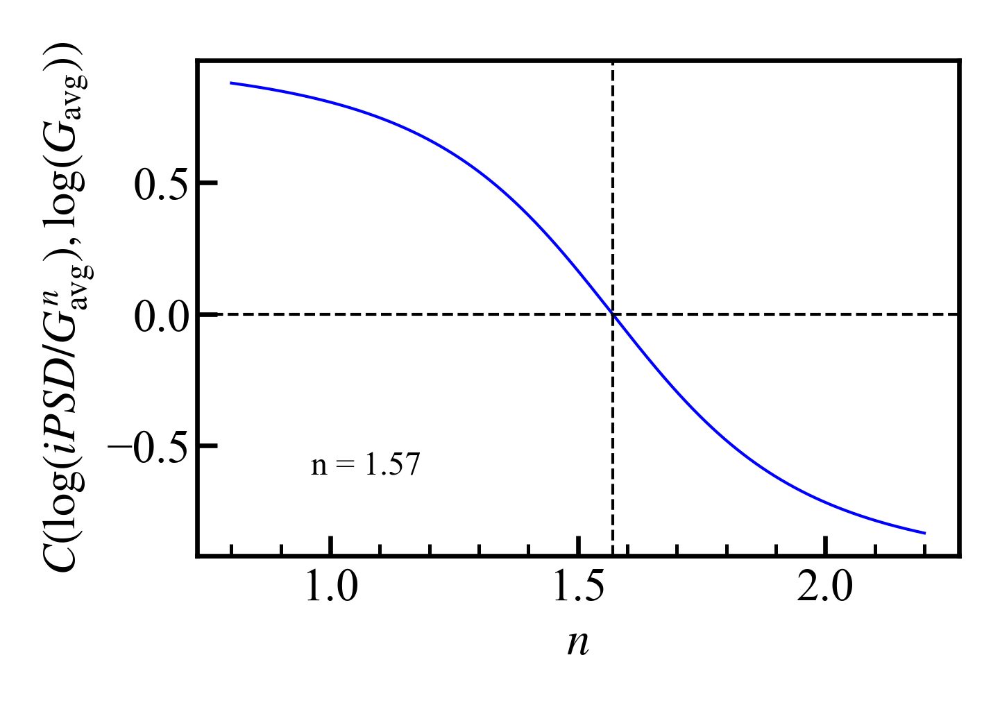

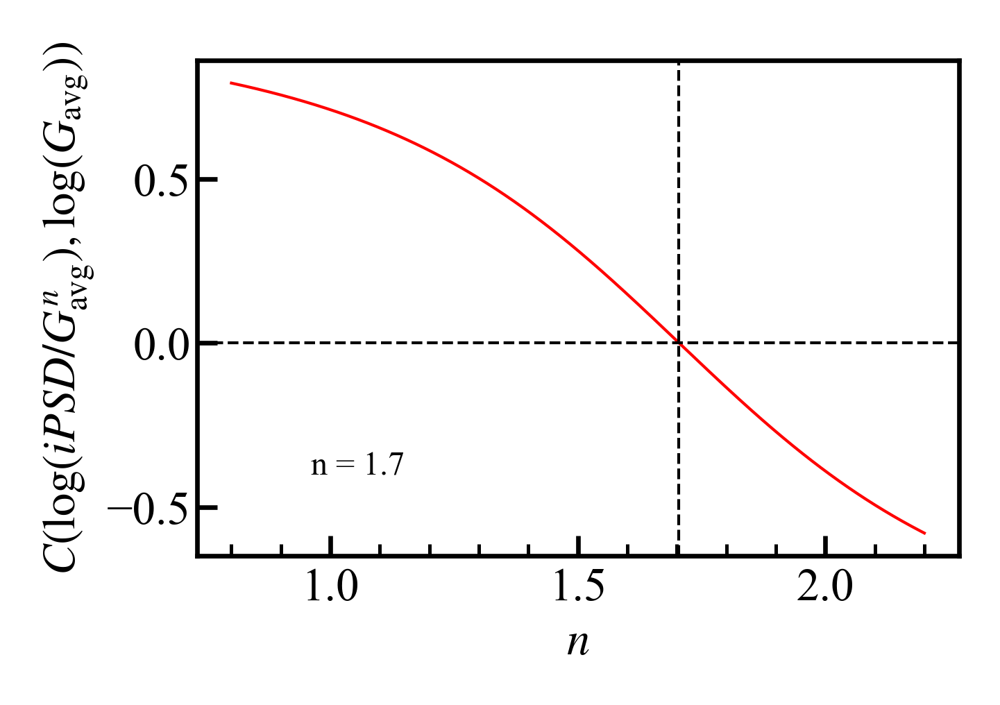

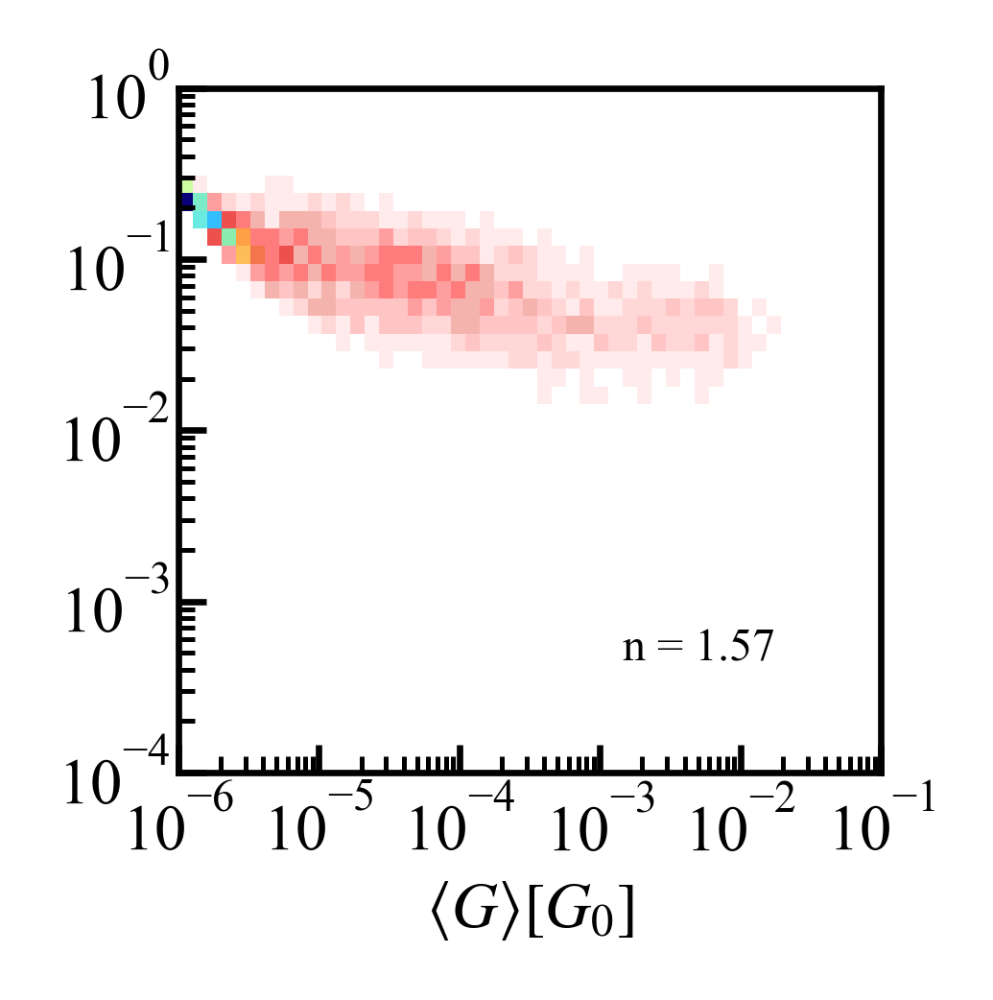

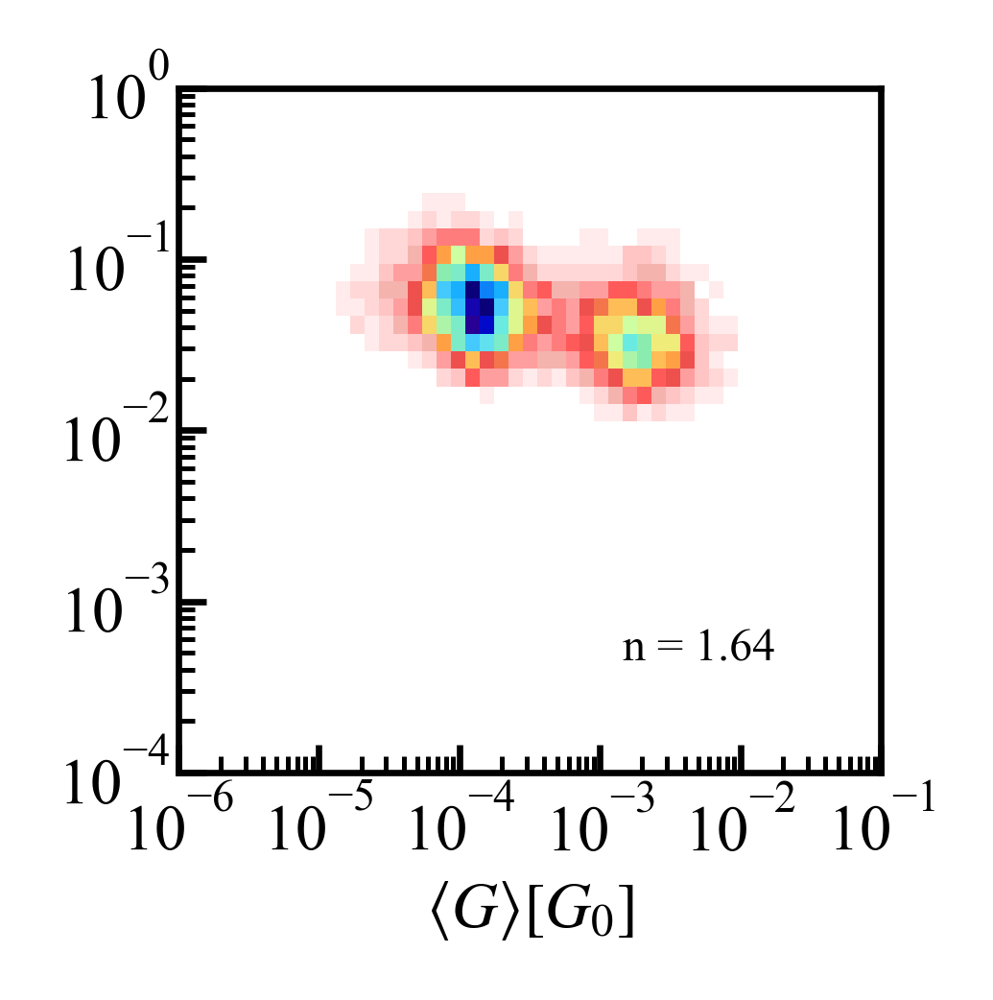

In [53]:
plots.plot_correlation(n = N, correlation = pull_corr, lw=0.5, c='blue')
plots.plot_correlation(n = N, correlation = push_corr, lw=0.5, c='red')

plots.plot_noise_power_2dhist(conductance_avgs=np.array(noise_stat_pull['avg_cond_on_step_1'][filt_inds_pull]),
                        noise_power=np.array(noise_stat_pull['conductance_noise_1'][filt_inds_pull]),
                        n = np.mean((N[pull_corr<0][0], N[pull_corr>0][-1])),
                        xrange=(1e-6, 0.1),
                        yrange=(1e-4, 1),
                        num_bins=(10, 10),
                        shift=-4,
                        cmap=hist_1.cmap_geo32)

plots.plot_noise_power_2dhist(conductance_avgs=np.array(noise_stat_push['avg_cond_on_step_1'][filt_inds_push]),
                        noise_power=np.array(noise_stat_push['conductance_noise_1'][filt_inds_push]),
                        n = np.mean((N[pull_corr<0][0], N[push_corr>0][-1])),
                        xrange=(1e-6, 0.1),
                        yrange=(1e-4, 1),
                        num_bins=(10, 10),
                        shift=-4,
                        cmap=hist_1.cmap_geo32)